In [ ]:
!pip install matplotlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.2/162.2 kB 16.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 79.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 305.2/305.2 kB 44.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.6/4.6 MB 77.2 MB/s eta 0:00:00ta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 70.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.2/103.2 kB 10.6 MB/s eta 0:00:00


In [ ]:
import torch.nn as nn_lib
import torch as torch_lib
import torch.nn.functional as func_lib
from tqdm import tqdm as progress_lib
import os as os_lib
import numpy as np_lib
import matplotlib.pyplot as plot_lib
import requests as requests_lib
import torch.optim as optim_lib
from tqdm import tqdm as progress_lib

image_data.shape: (106, 100, 100, 3)
pose_data.shape: (106, 4, 4)
focal_length: 138.88887889922103


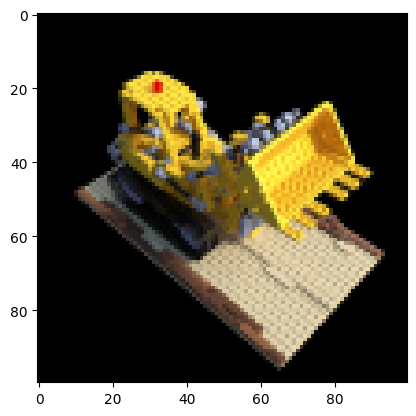

In [ ]:
# Define the URL and the local filename for the dataset
dataset_url = 'http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz'
dataset_filename = 'tiny_nerf_data.npz'

# Download the dataset if it does not exist locally
if not os_lib.path.exists(dataset_filename):
    response = requests_lib.get(dataset_url)
    with open(dataset_filename, 'wb') as dataset_file:
        dataset_file.write(response.content)

# Set the device to GPU if available, otherwise use CPU
computation_device = torch_lib.device("cuda" if torch_lib.cuda.is_available() else "cpu")

# Set random seeds for reproducibility
torch_lib.manual_seed(888)
np_lib.random.seed(555)
torch_lib.backends.cudnn.benchmark = True

# Load the dataset
data = np_lib.load(dataset_filename)
image_data = data['images']
pose_data = data['poses']
focal_length = data['focal']
height, width = image_data.shape[1:3]

# Print dataset information
print("image_data.shape:", image_data.shape)
print("pose_data.shape:", pose_data.shape)
print("focal_length:", focal_length)

# Number of training images
num_training_images = 100

# Separate test image and pose from the dataset
test_image, test_pose = image_data[101], pose_data[101]
image_data = image_data[:num_training_images]
pose_data = pose_data[:num_training_images]

# Display the test image
plot_lib.imshow(test_image)
plot_lib.show()


In [ ]:


# Define the NeRF class
class NeuralRadianceField(nn_lib.Module):
    def __init__(self,view_input_channels=24, directions_use_view=True, depth=8, width=256, input_channels=60):
        super(NeuralRadianceField, self).__init__()
        # Example assert statements
        assert isinstance(depth, int), "Depth must be an integer"
        self.depth = depth
        assert isinstance(width, int), "Width must be an integer"
        self.width = width
        assert isinstance(input_channels, int), "Input channels must be an integer"
        self.input_channels = input_channels
        assert isinstance(view_input_channels, int), "View input channels must be an integer"
        self.directions_use_view = directions_use_view
        assert isinstance(directions_use_view, bool), "Directions use view must be a boolean"

        self.nnetwork = nn_lib.ModuleList([nn_lib.Linear(input_channels, width)])
        self.nnetwork.append(nn_lib.Linear(width, width))
        self.nnetwork.append(nn_lib.Linear(width, width))
        self.nnetwork.append(nn_lib.Linear(width, width))
        self.nnetwork.append(nn_lib.Linear(width, width))
        self.nnetwork.append(nn_lib.Linear(width + input_channels, width))
        self.nnetwork.append(nn_lib.Linear(width, width))
        self.nnetwork.append(nn_lib.Linear(width, width))
        self.nnetwork.append(nn_lib.Linear(width, width))

        self.alpha_layer = nn_lib.Linear(width, 1)
        self.layer_feature = nn_lib.Linear(width, width)

        width_out = width // 2
        if directions_use_view:
            self.directional_projection = nn_lib.Linear(width + view_input_channels, width_out)
        else:
            self.directional_projection = nn_lib.Linear(width, width_out)
        self.rgb_layer = nn_lib.Linear(width_out, 3)


    def forward(self, points_input, views_input):
        hidden_rep = torch_lib.empty_like(points_input).copy_(points_input).detach()

        hidden_rep = func_lib.relu(self.nnetwork[0](hidden_rep))
        hidden_rep = func_lib.relu(self.nnetwork[1](hidden_rep))
        hidden_rep = func_lib.relu(self.nnetwork[2](hidden_rep))
        hidden_rep = func_lib.relu(self.nnetwork[3](hidden_rep))
        hidden_rep = func_lib.relu(self.nnetwork[4](hidden_rep))
        hidden_rep = torch_lib.cat((points_input, hidden_rep), -1)
        hidden_rep = func_lib.relu(self.nnetwork[5](hidden_rep))
        hidden_rep = func_lib.relu(self.nnetwork[6](hidden_rep))
        hidden_rep = func_lib.relu(self.nnetwork[7](hidden_rep))

        feature_output = self.layer_feature(hidden_rep)
        alpha_output = func_lib.relu(self.alpha_layer(hidden_rep))

        if self.directions_use_view and views_input is not None:
            hidden_rep = torch_lib.cat((feature_output, views_input), -1)

        hidden_rep = self.directional_projection(hidden_rep)
        hidden_rep = func_lib.relu(hidden_rep)

        rgb_output = self.rgb_layer(hidden_rep)
        rgb_output = torch_lib.sigmoid(rgb_output)

        return rgb_output, alpha_output

In [ ]:

def positional_encoding(input_x, num_levels):
    # Create a frequency matrix
    frequency_bands = 2.0 ** torch_lib.arange(num_levels, dtype=input_x.dtype, device=input_x.device)

    # Reshape input and frequencies for broadcasting
    input_expanded = input_x.unsqueeze(-1) * frequency_bands.unsqueeze(0)

    # Apply sine and cosine to the frequency-transformed inputs
    sin_encodings = torch_lib.sin(input_expanded)
    cos_encodings = torch_lib.cos(input_expanded)

    # Concatenate the results
    pos_encoding = torch_lib.cat([sin_encodings, cos_encodings], dim=-1)

    return pos_encoding.reshape(input_x.shape[0], -1)


def sample_rays_numpy(height, width, focal_length, camera_to_world):
    # Create a grid of coordinates corresponding to pixel centers
    pixel_i, pixel_j = np_lib.mgrid[0:height, 0:width].astype(np_lib.float32)

    # Stack to create a (height, width, 2) array
    pixel_centers = np_lib.stack([pixel_i, pixel_j], axis=-1)

    # Adjust pixel centers to be centered around (0,0) and scaled by focal length
    directions = np_lib.empty((height, width, 3), dtype=np_lib.float32)
    directions[..., 0] = (pixel_centers[..., 1] - width * 0.5 + 0.5) / focal_length
    directions[..., 1] = -(pixel_centers[..., 0] - height * 0.5 + 0.5) / focal_length
    directions[..., 2] = -1.0  # All directions point forward in camera space

    # Apply the camera to world transformation to get the ray directions in world space
    ray_directions = directions @ camera_to_world[:3, :3].T
    ray_origins = np_lib.tile(camera_to_world[:3, 3], (height, width, 1))

    return ray_origins, ray_directions


def uniform_sample_points(start, end, num_samples, device):
    # Create evenly spaced points in the range [0, 1)
    base_points = torch_lib.linspace(0.0, 1.0, num_samples, device=device)

    # Add random jitter to each point
    jitter = torch_lib.rand(num_samples, device=device) / num_samples

    # Shift base points by the random jitter
    sampled_points = base_points + jitter

    # Scale to the desired range [start, end)
    scaled_points = start + (end - start) * sampled_points

    return scaled_points



In [ ]:

import torch as T
import torch.nn.functional as F


def get_rgb_weights(model, samples, directions, z_vals, device, noise_std=0.0, use_viewdirs=False):
    # Encode the sample points
    samples_flat = samples.view(-1, 3)
    encoded_samples = positional_encoding(samples_flat, num_levels=10)

    # Optionally encode the ray directions
    if use_viewdirs:
        expanded_dirs = directions.unsqueeze(1).expand_as(samples).reshape(-1, 3)
        normalized_dirs = F.normalize(expanded_dirs, dim=-1)
        encoded_dirs = positional_encoding(normalized_dirs, num_levels=4)
    else:
        encoded_dirs = None

    # Get RGB and density (sigma) from the network
    rgb, sigma = model(encoded_samples, encoded_dirs)
    rgb = rgb.view(*samples.shape[:-1], 3)
    sigma = sigma.view(*samples.shape[:-1])

    # Compute distances between consecutive z-values
    deltas = - z_vals[..., :-1] + z_vals[..., 1:]
    deltas = T.cat([deltas, T.full((deltas.shape[0], 1), 1e10, device=device)], dim=-1)
    ray_norms = T.norm(directions, dim=-1, keepdim=True)
    deltas *= ray_norms

    # Add noise to density if specified
    if noise_std > 0.0:
        noise = T.randn(sigma.shape, device=device) * noise_std
        sigma += noise

    # Compute alpha values and weights
    alpha = 1.0 - T.exp(-sigma * deltas)
    transmittance = T.cumprod(T.cat([T.ones((alpha.shape[0], 1), device=device), 1.0 - alpha + 1e-10], dim=-1), dim=-1)
    weights = alpha * transmittance[:, :-1]

    return rgb, weights



def rendering(model, ray_bundle, bounds, num_samples, comp_device, noise_std=0.0, directions_use_view=False):
    origins, directions = ray_bundle
    near, far = bounds
    uniform_samples, importance_samples = num_samples

    # Generate uniform depth samples
    z_vals = T.linspace(near, far, uniform_samples, device=comp_device).expand(origins.shape[0], uniform_samples)
    points = origins.unsqueeze(1) + directions.unsqueeze(1) * z_vals.unsqueeze(-1)

    if importance_samples is not None:
        with T.no_grad():
            initial_rgb, initial_weights = get_rgb_weights(model, points, directions, z_vals, comp_device, noise_std, directions_use_view)
            mid_z_vals = 0.5 * (z_vals[..., :-1] + z_vals[..., 1:])
            importance_z_vals = pdf_sample_points(mid_z_vals, initial_weights[..., 1:-1], importance_samples, comp_device)

        combined_z_vals = T.cat([z_vals, importance_z_vals], dim=-1)
        combined_z_vals, _ = T.sort(combined_z_vals, dim=-1)
        expanded_points = origins.unsqueeze(1) + directions.unsqueeze(1) * combined_z_vals.unsqueeze(-1)
    else:
        combined_z_vals = z_vals
        expanded_points = points

    # Compute final RGB and weights
    final_rgb, final_weights = get_rgb_weights(model, expanded_points, directions, combined_z_vals, comp_device, noise_std, directions_use_view)

    # Compute final outputs
    color_map = T.sum(final_weights.unsqueeze(-1) * final_rgb, dim=-2)
    depth_map = T.sum(final_weights * combined_z_vals, dim=-1)
    acc_map = T.sum(final_weights, dim=-1)

    return color_map, depth_map, acc_map



def pdf_sample_points(mid_vals, weights, num_samples, device):
    # Normalize the weights to form the PDF
    weights_sum = weights.sum(dim=-1, keepdim=True)
    epsilon = 1e-8  # small value to avoid division by zero
    pdf = weights / (weights_sum + epsilon)

    # Calculate the CDF from the PDF
    cdf = T.cumsum(pdf, dim=-1)
    cdf = T.cat((T.zeros_like(cdf[..., :1]), cdf), dim=-1)

    # Draw uniform random samples
    uniform_samples = T.rand(*cdf.shape[:-1], num_samples, device=device)

    # Find indices in the CDF for the uniform samples
    bin_indices = T.searchsorted(cdf, uniform_samples, right=True)
    lower_idx = T.clamp(bin_indices - 1, min=0)
    upper_idx = T.clamp(bin_indices, max=cdf.shape[-1] - 1)

    # Gather values from bin_edges based on the CDF indices
    cdf_values_lower = T.gather(cdf, 1, lower_idx)
    cdf_values_upper = T.gather(cdf, 1, upper_idx)
    bin_values_lower = T.gather(mid_vals, 1, lower_idx)
    bin_values_upper = T.gather(mid_vals, 1, upper_idx)

    # Calculate the differences and interpolation factors
    delta_cdf = cdf_values_upper - cdf_values_lower
    delta_cdf = T.where(delta_cdf < epsilon, T.ones_like(delta_cdf) * epsilon, delta_cdf)
    interpolation_factors = (uniform_samples - cdf_values_lower) / delta_cdf

    # Ensure that the interpolation factors do not produce NaNs
    interpolation_factors = T.clamp(interpolation_factors, 0.0, 1.0)

    samples = bin_values_lower + interpolation_factors * (bin_values_upper - bin_values_lower)

    return samples

The number of batches is 488 and each batch has 2048 rays


100%|██████████| 488/488 [00:23<00:00, 20.74it/s]


PSNR score=tensor([21.6334])
Average loss per epoch = 0.02323991668383881


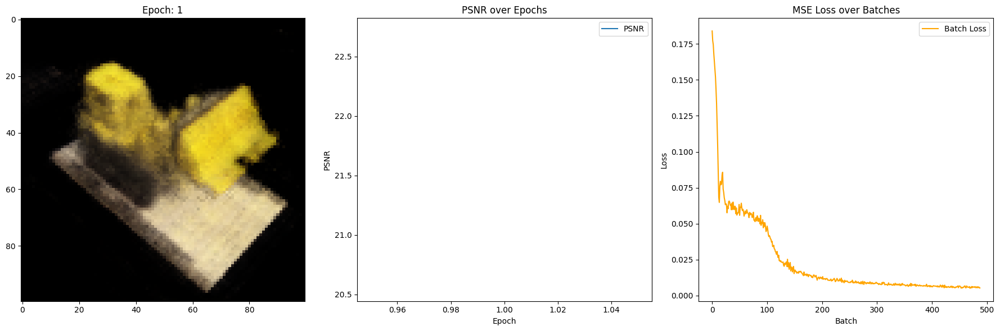

100%|██████████| 488/488 [00:23<00:00, 21.15it/s]


PSNR score=tensor([24.5863])
Average loss per epoch = 0.004032739522088258


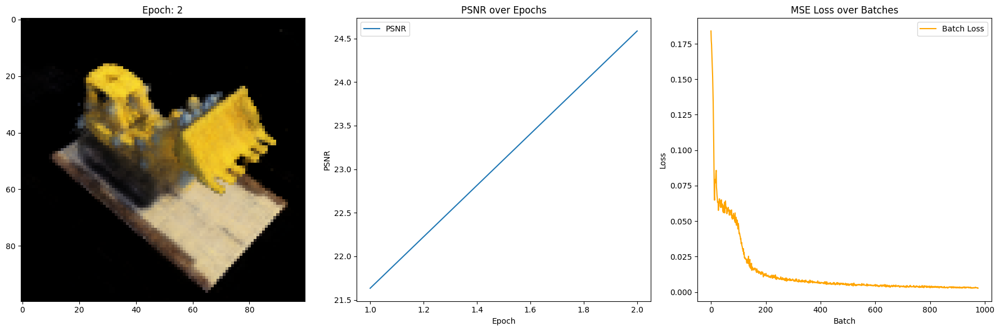

100%|██████████| 488/488 [00:22<00:00, 21.24it/s]


PSNR score=tensor([26.3996])
Average loss per epoch = 0.0025543771673673305


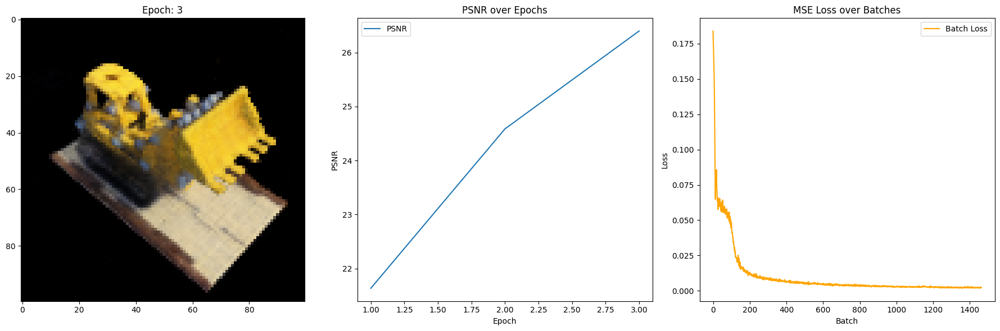

100%|██████████| 488/488 [00:23<00:00, 21.11it/s]


PSNR score=tensor([27.4268])
Average loss per epoch = 0.00193179536684317


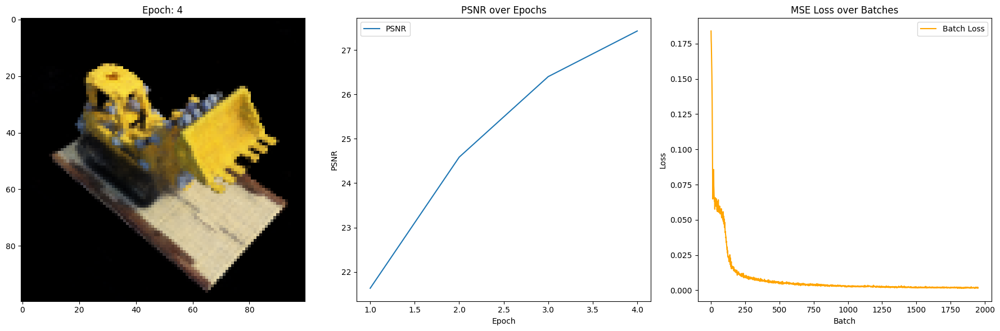

100%|██████████| 488/488 [00:23<00:00, 21.12it/s]


PSNR score=tensor([28.1477])
Average loss per epoch = 0.0015948746240312295


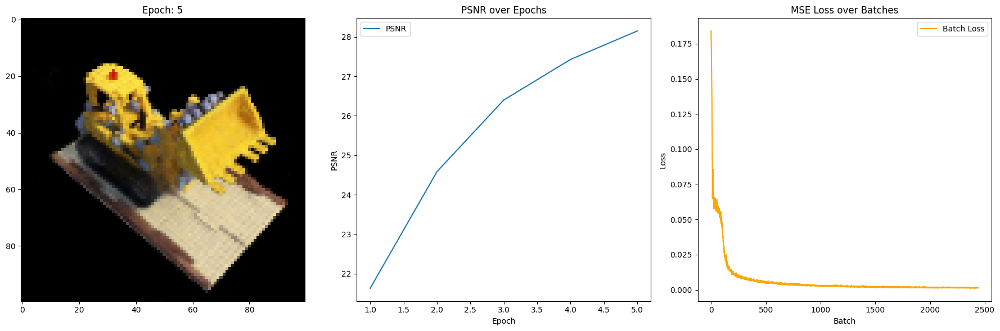

100%|██████████| 488/488 [00:22<00:00, 21.23it/s]


PSNR score=tensor([28.5520])
Average loss per epoch = 0.0013784409152843883


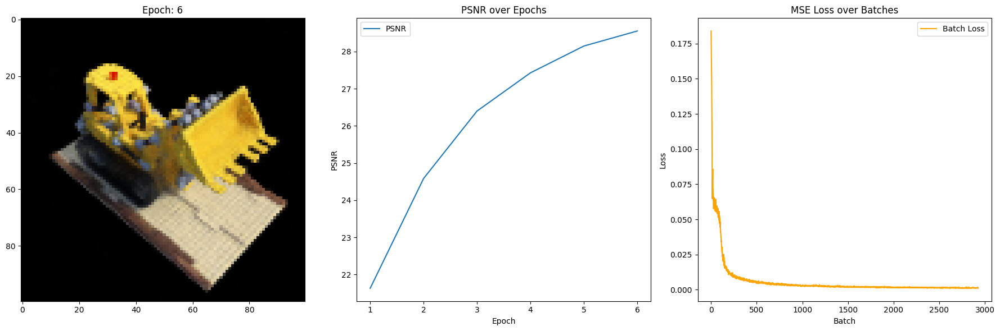

100%|██████████| 488/488 [00:23<00:00, 21.21it/s]


PSNR score=tensor([28.6231])
Average loss per epoch = 0.0012363916918774686


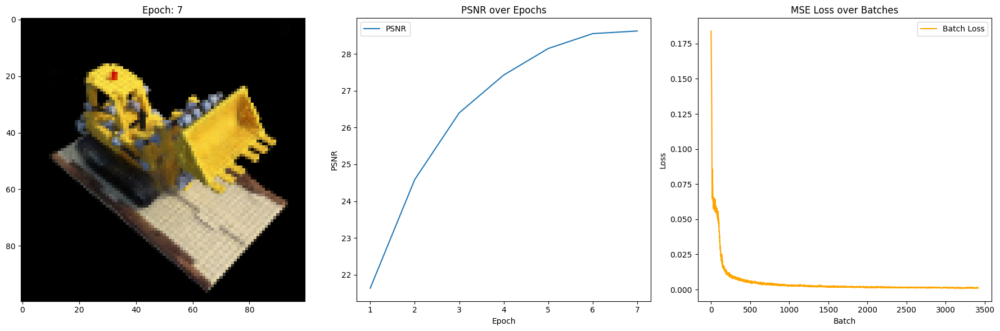

100%|██████████| 488/488 [00:23<00:00, 21.21it/s]


PSNR score=tensor([29.2133])
Average loss per epoch = 0.0011103516341984792


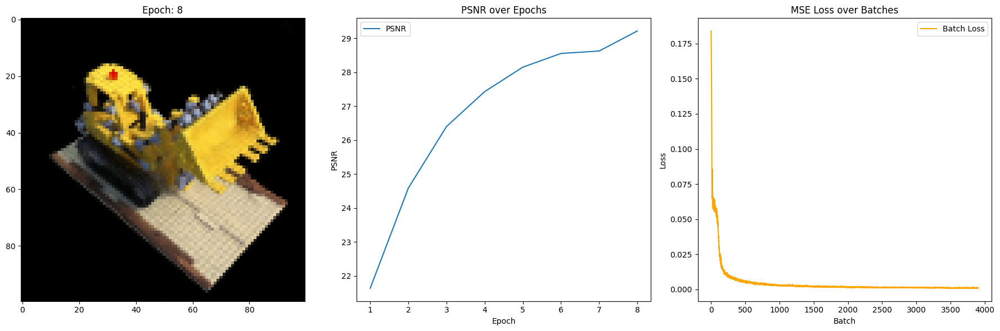

100%|██████████| 488/488 [00:22<00:00, 21.28it/s]


PSNR score=tensor([29.8021])
Average loss per epoch = 0.0010041695972713718


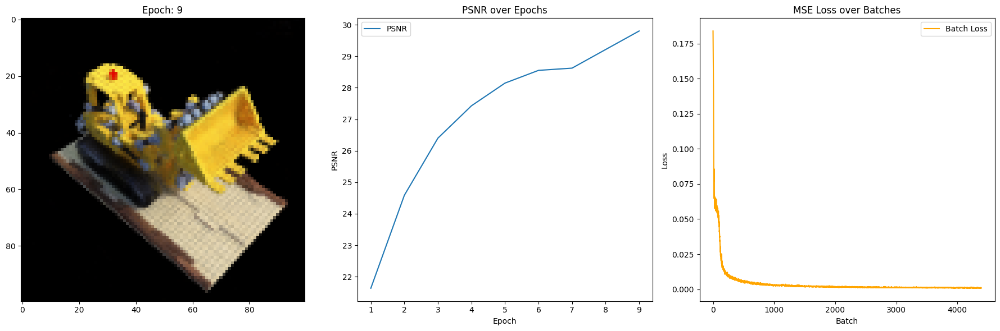

100%|██████████| 488/488 [00:22<00:00, 21.27it/s]


PSNR score=tensor([29.8310])
Average loss per epoch = 0.0009167522487095099


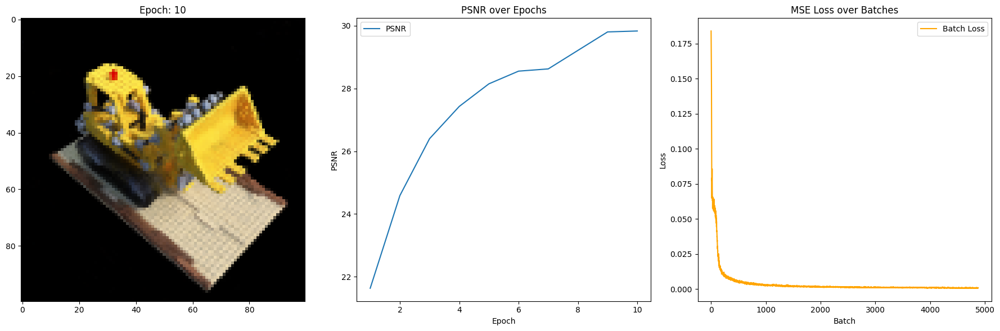

100%|██████████| 488/488 [00:23<00:00, 21.16it/s]


PSNR score=tensor([30.2552])
Average loss per epoch = 0.0008549787080035637


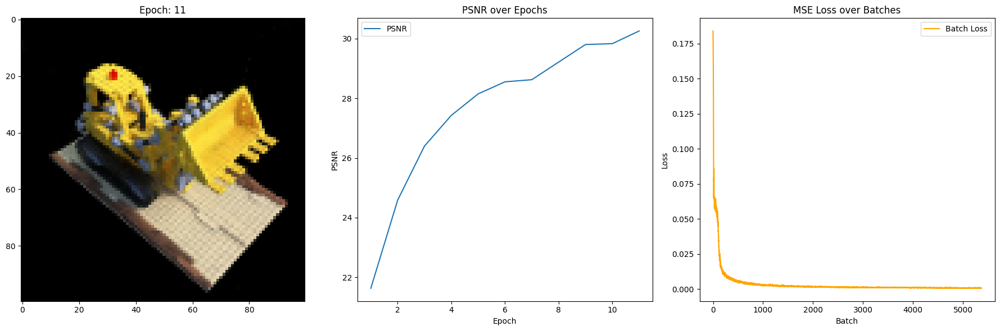

100%|██████████| 488/488 [00:22<00:00, 21.23it/s]


PSNR score=tensor([30.4956])
Average loss per epoch = 0.0008178512873767387


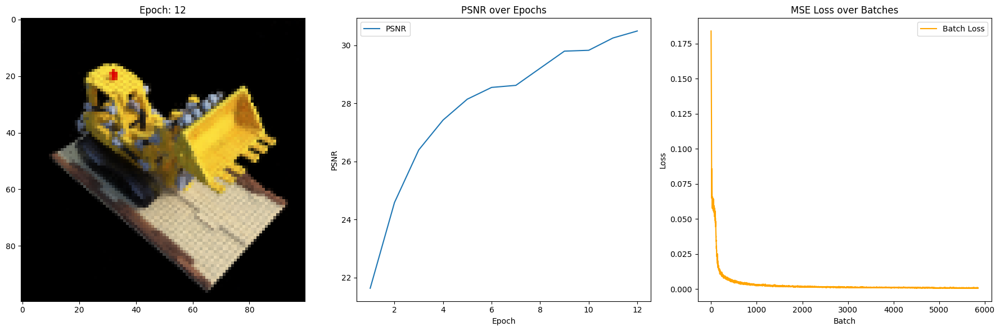

100%|██████████| 488/488 [00:22<00:00, 21.23it/s]


PSNR score=tensor([30.7944])
Average loss per epoch = 0.0007641072812982545


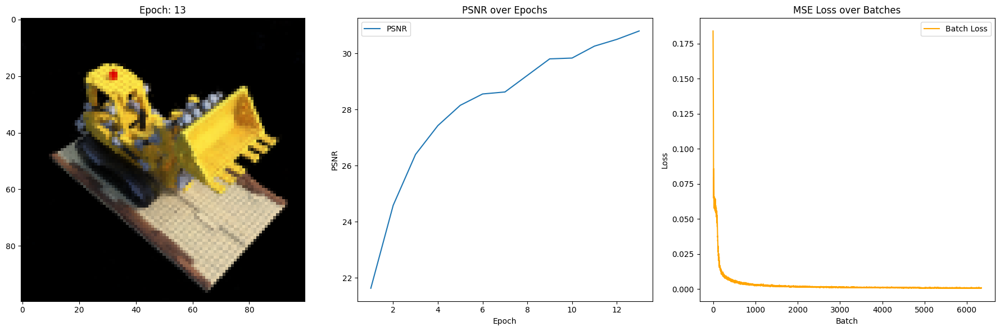

100%|██████████| 488/488 [00:22<00:00, 21.24it/s]


PSNR score=tensor([30.9255])
Average loss per epoch = 0.0007417781633223773


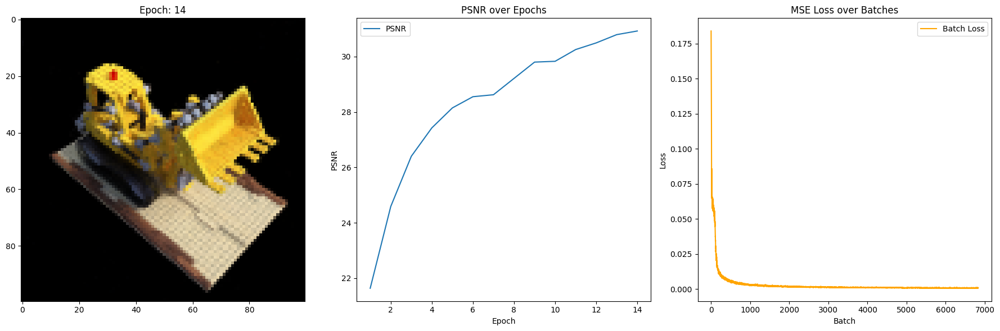

100%|██████████| 488/488 [00:22<00:00, 21.26it/s]


PSNR score=tensor([30.6100])
Average loss per epoch = 0.0006993359166386415


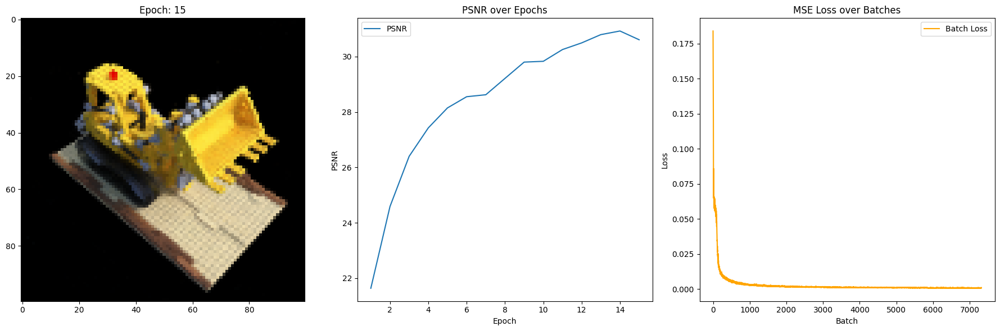

100%|██████████| 488/488 [00:22<00:00, 21.24it/s]


PSNR score=tensor([31.5599])
Average loss per epoch = 0.0006847795340915775


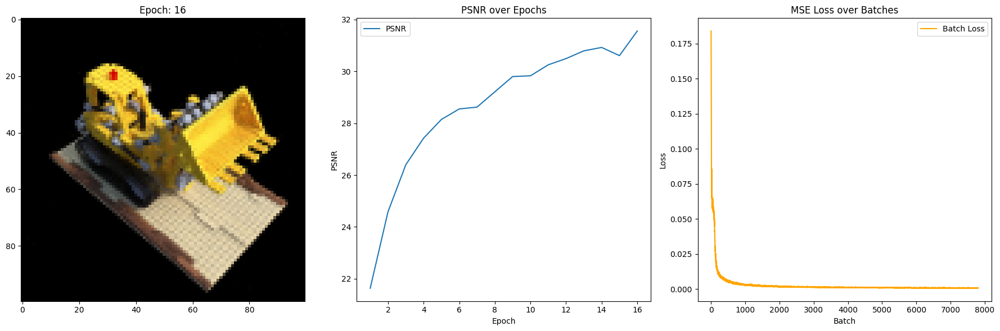

100%|██████████| 488/488 [00:22<00:00, 21.25it/s]


PSNR score=tensor([31.8356])
Average loss per epoch = 0.0006483648588774024


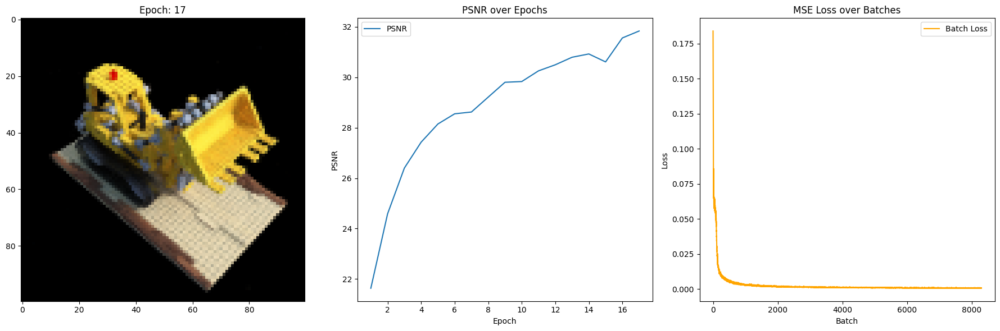

100%|██████████| 488/488 [00:22<00:00, 21.26it/s]


PSNR score=tensor([31.5737])
Average loss per epoch = 0.0006296046074149657


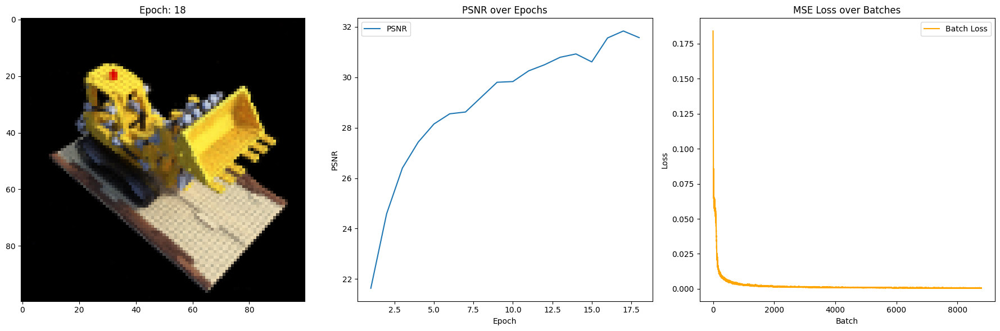

100%|██████████| 488/488 [00:22<00:00, 21.26it/s]


PSNR score=tensor([31.6143])
Average loss per epoch = 0.0006168997961885609


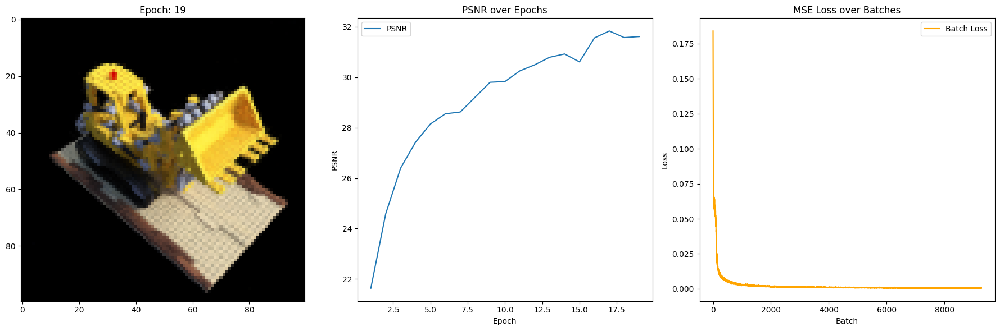

100%|██████████| 488/488 [00:22<00:00, 21.22it/s]


PSNR score=tensor([31.4057])
Average loss per epoch = 0.0005870300832254141


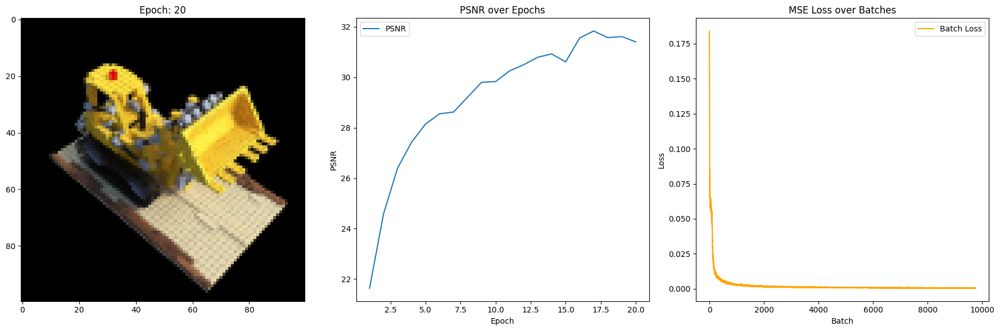

100%|██████████| 488/488 [00:22<00:00, 21.28it/s]


PSNR score=tensor([31.4117])
Average loss per epoch = 0.0005711776598143872


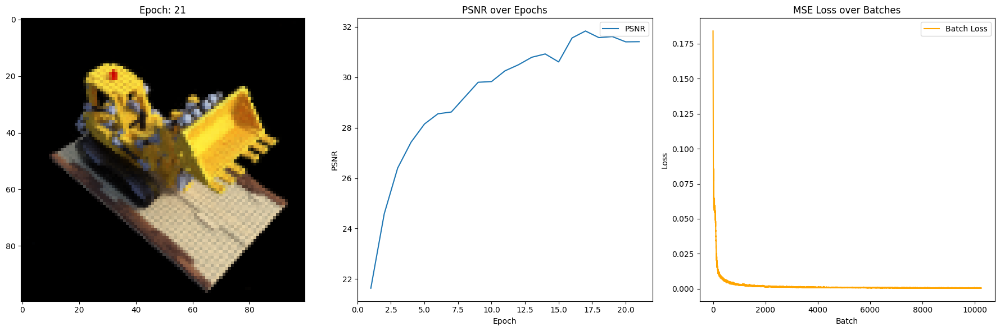

100%|██████████| 488/488 [00:22<00:00, 21.29it/s]


PSNR score=tensor([32.1382])
Average loss per epoch = 0.0005548518600365048


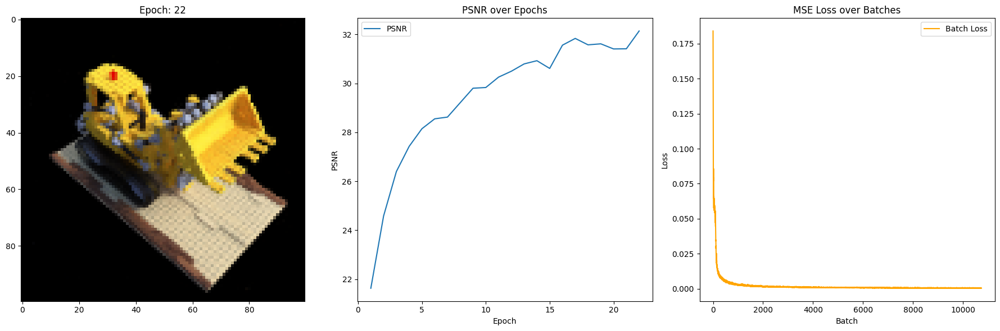

100%|██████████| 488/488 [00:22<00:00, 21.28it/s]


PSNR score=tensor([32.3115])
Average loss per epoch = 0.0005479042476031654


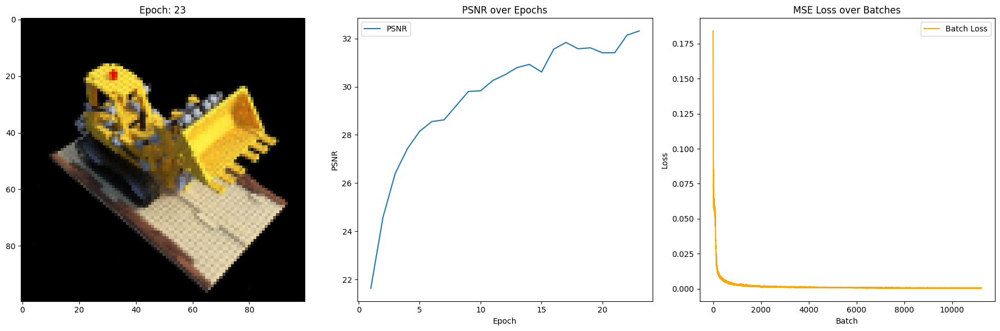

100%|██████████| 488/488 [00:22<00:00, 21.28it/s]


PSNR score=tensor([31.5050])
Average loss per epoch = 0.0005359968518099717


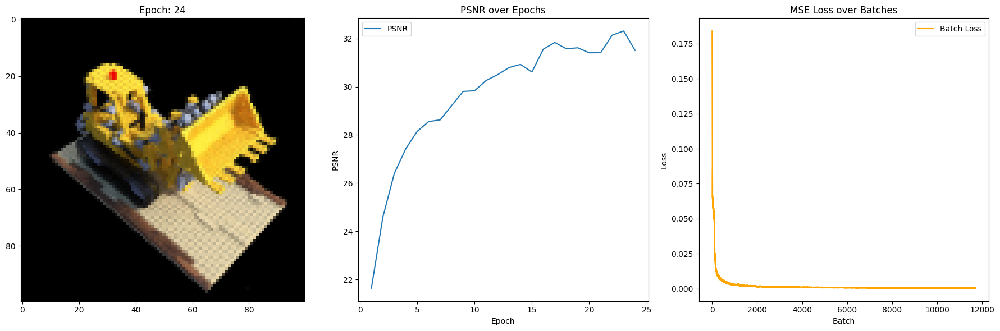

100%|██████████| 488/488 [00:22<00:00, 21.28it/s]


PSNR score=tensor([32.0733])
Average loss per epoch = 0.0005191052980796381


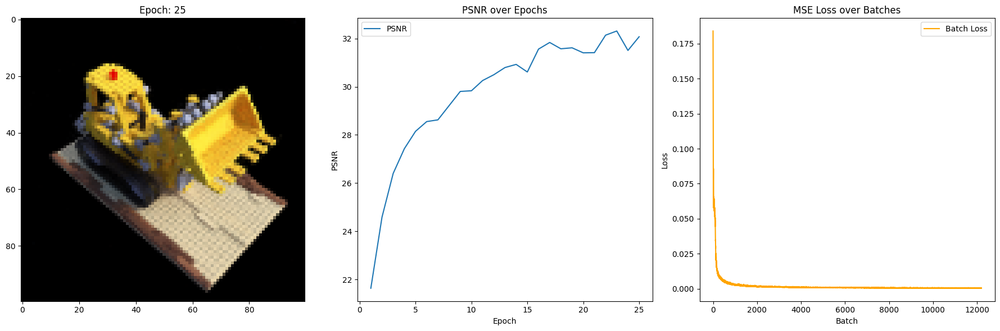

100%|██████████| 488/488 [00:22<00:00, 21.28it/s]


PSNR score=tensor([31.9161])
Average loss per epoch = 0.0005029153533720747


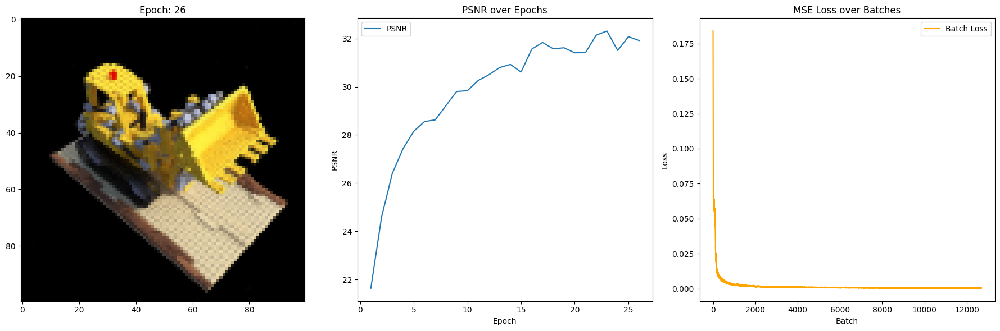

100%|██████████| 488/488 [00:22<00:00, 21.28it/s]


PSNR score=tensor([31.9154])
Average loss per epoch = 0.0004973032043127488


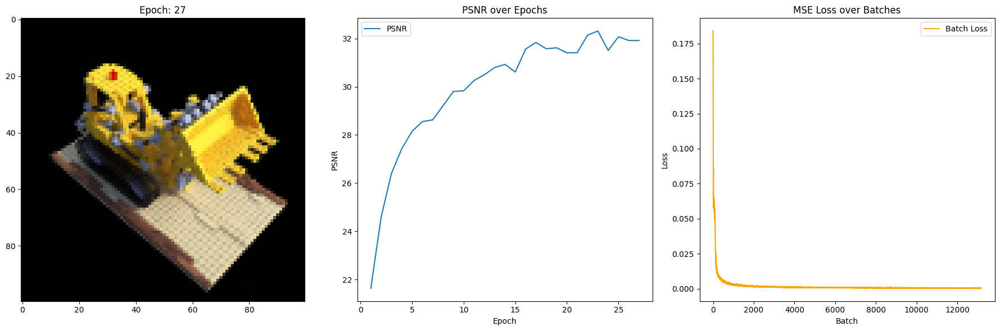

100%|██████████| 488/488 [00:23<00:00, 21.22it/s]


PSNR score=tensor([32.3421])
Average loss per epoch = 0.000477643702995055


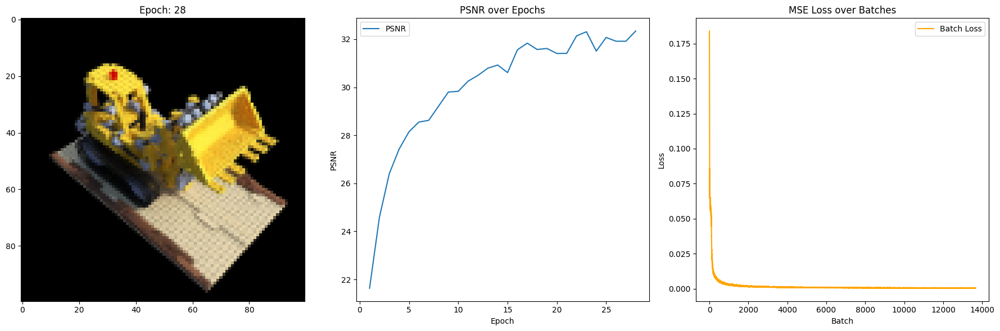

100%|██████████| 488/488 [00:23<00:00, 21.20it/s]


PSNR score=tensor([31.9485])
Average loss per epoch = 0.0004732200759463012


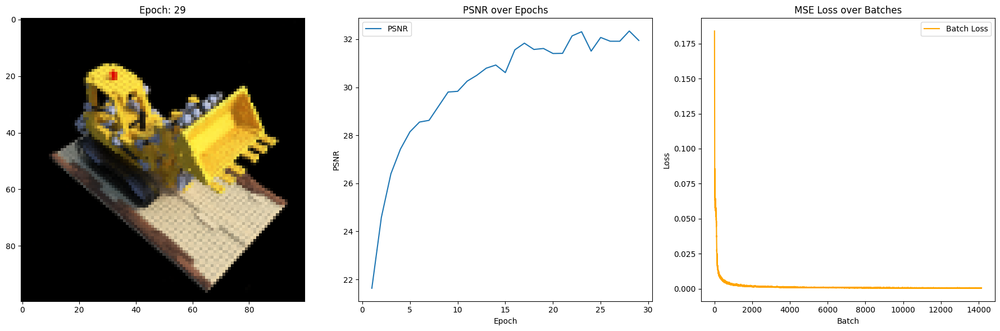

100%|██████████| 488/488 [00:22<00:00, 21.29it/s]


PSNR score=tensor([32.7968])
Average loss per epoch = 0.00046495511393362395


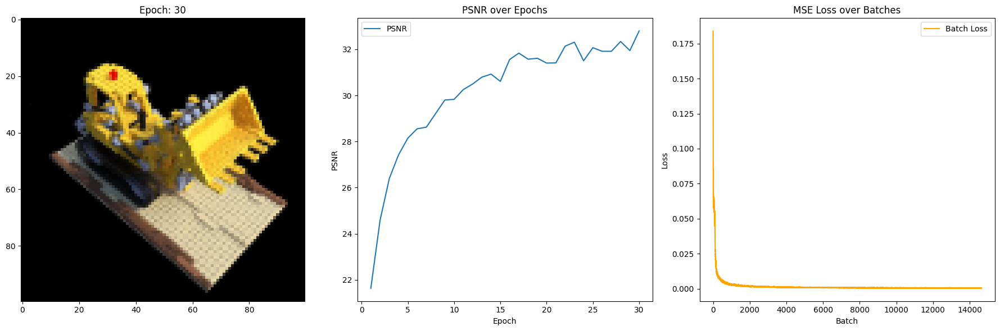

100%|██████████| 488/488 [00:22<00:00, 21.23it/s]


PSNR score=tensor([32.8132])
Average loss per epoch = 0.0004494574083063988


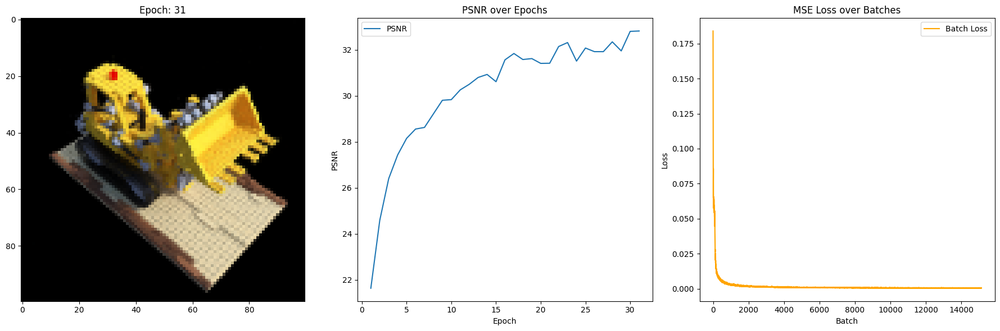

100%|██████████| 488/488 [00:23<00:00, 21.16it/s]


PSNR score=tensor([32.1446])
Average loss per epoch = 0.0004419176533940386


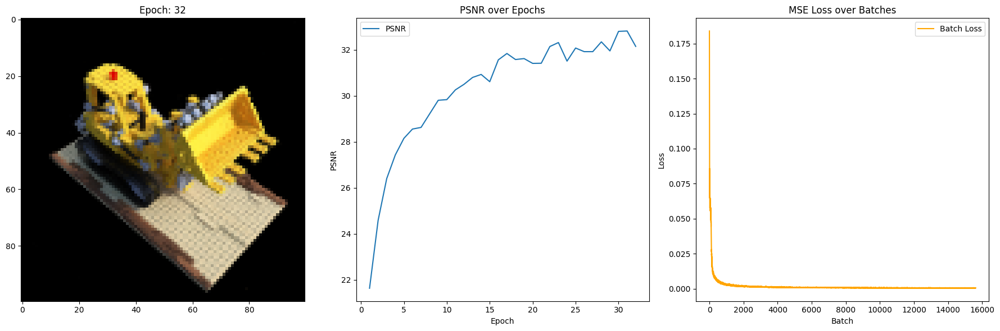

100%|██████████| 488/488 [00:22<00:00, 21.30it/s]


PSNR score=tensor([32.6523])
Average loss per epoch = 0.00043267953491313613


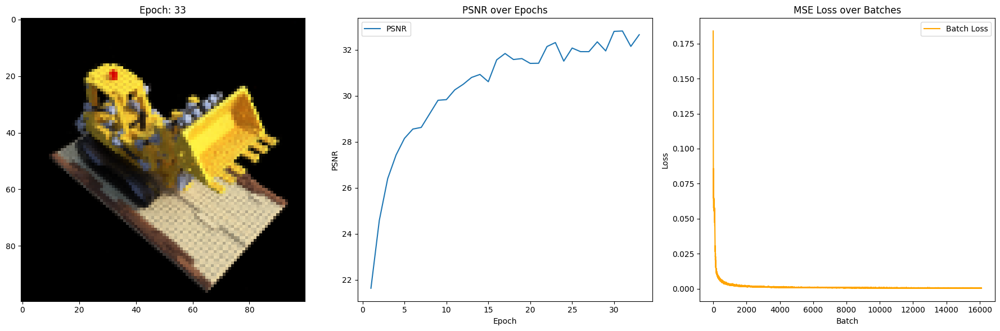

100%|██████████| 488/488 [00:23<00:00, 21.22it/s]


PSNR score=tensor([32.4622])
Average loss per epoch = 0.0004212495820314364


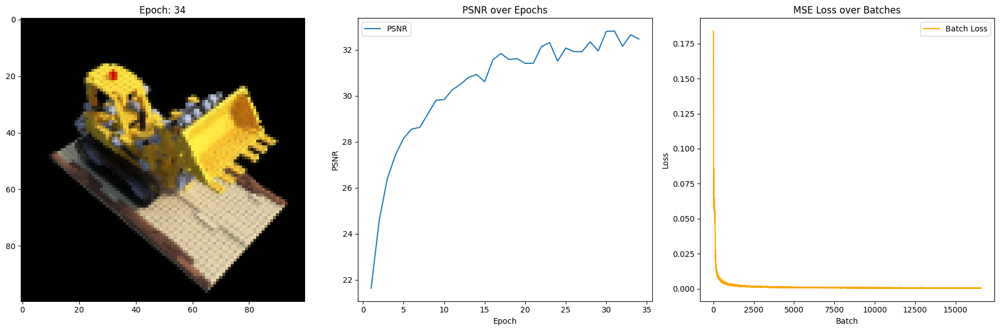

100%|██████████| 488/488 [00:22<00:00, 21.22it/s]


PSNR score=tensor([32.9698])
Average loss per epoch = 0.0004229763595861589


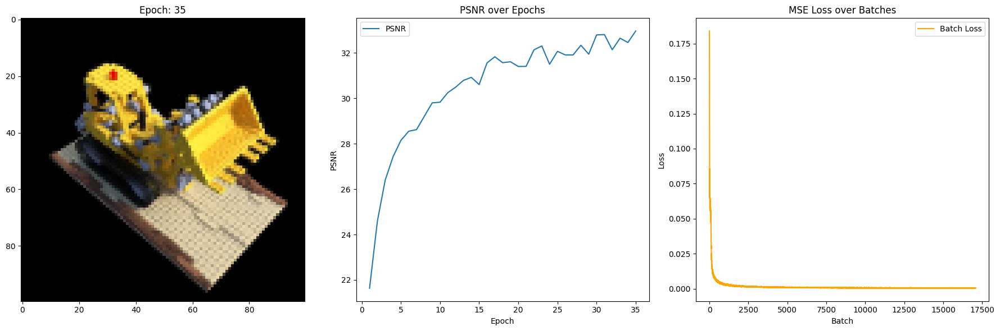

100%|██████████| 488/488 [00:22<00:00, 21.28it/s]


PSNR score=tensor([32.5438])
Average loss per epoch = 0.00040364960504583175


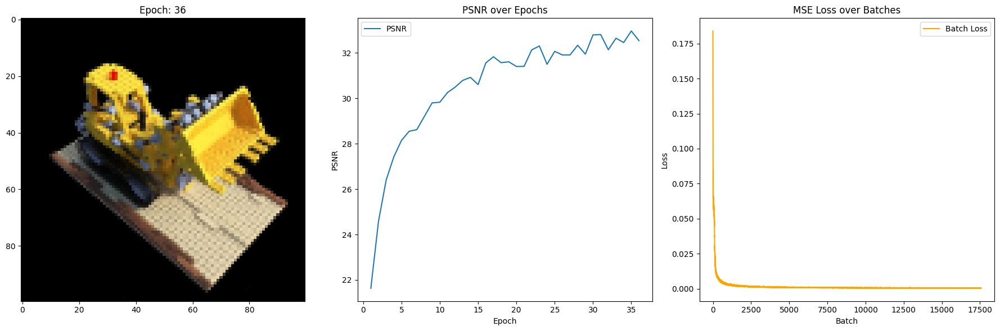

100%|██████████| 488/488 [00:22<00:00, 21.29it/s]


PSNR score=tensor([33.0878])
Average loss per epoch = 0.0004046259624582952


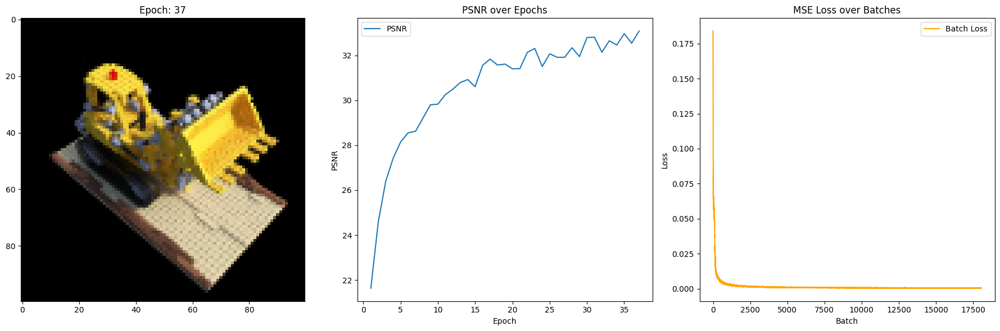

100%|██████████| 488/488 [00:22<00:00, 21.29it/s]


PSNR score=tensor([32.5473])
Average loss per epoch = 0.0003914288642337225


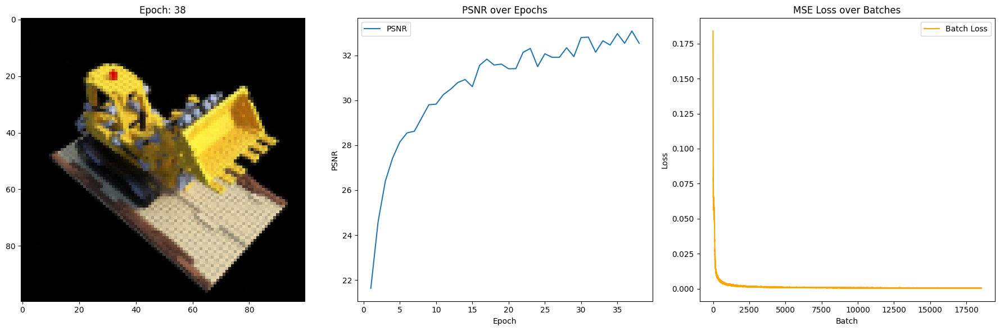

100%|██████████| 488/488 [00:22<00:00, 21.30it/s]


PSNR score=tensor([33.0409])
Average loss per epoch = 0.00038636134046160416


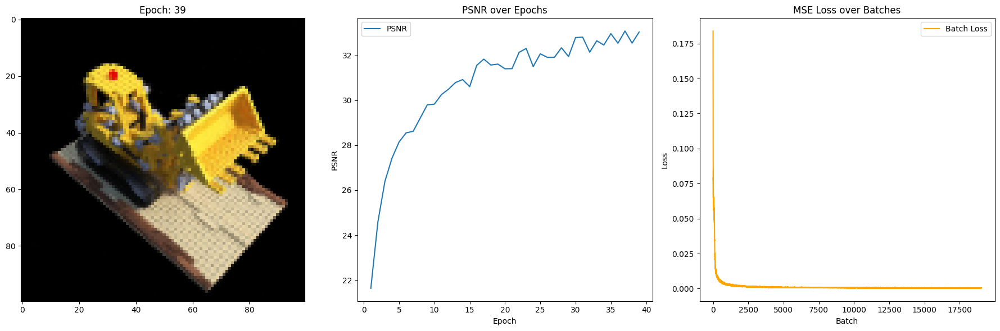

100%|██████████| 488/488 [00:22<00:00, 21.30it/s]


PSNR score=tensor([33.2326])
Average loss per epoch = 0.000375399956506864


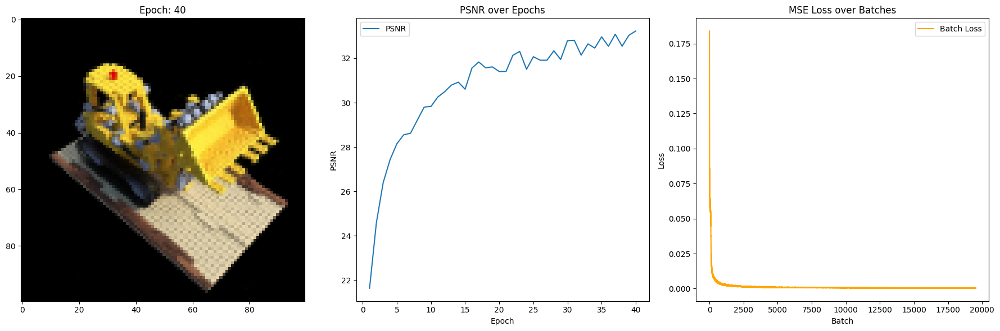

100%|██████████| 488/488 [00:22<00:00, 21.26it/s]


PSNR score=tensor([33.5115])
Average loss per epoch = 0.0003728834183630915


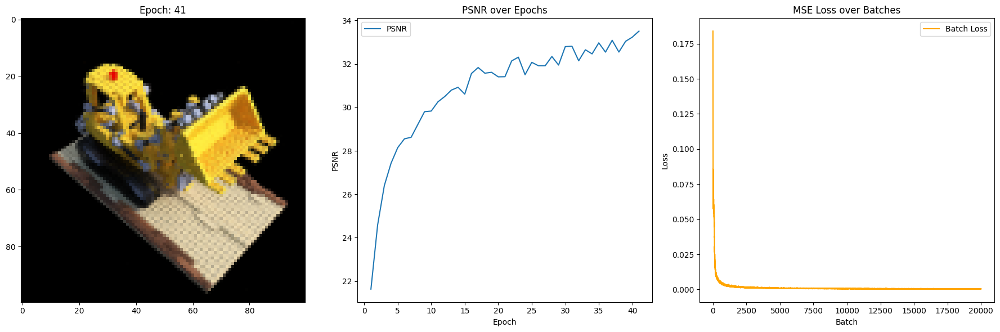

100%|██████████| 488/488 [00:22<00:00, 21.38it/s]


PSNR score=tensor([33.1603])
Average loss per epoch = 0.00036592486277022245


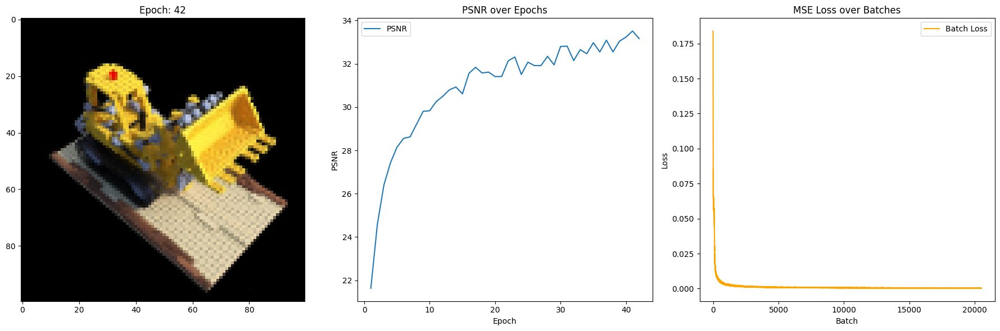

100%|██████████| 488/488 [00:22<00:00, 21.24it/s]


PSNR score=tensor([33.2920])
Average loss per epoch = 0.0003559331063846256


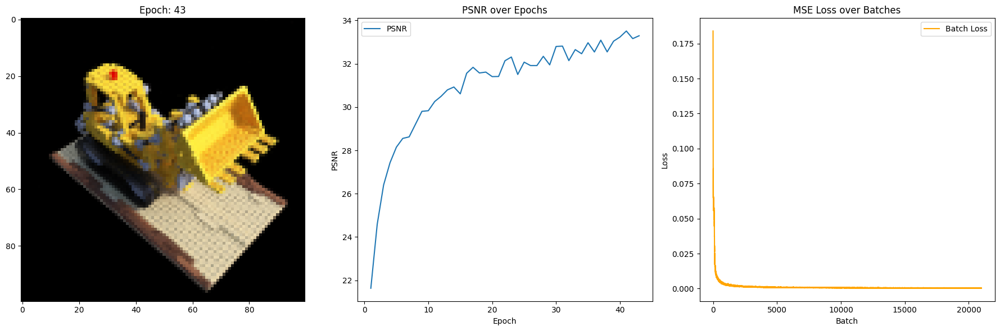

100%|██████████| 488/488 [00:23<00:00, 21.17it/s]


PSNR score=tensor([33.6099])
Average loss per epoch = 0.0003522534380102965


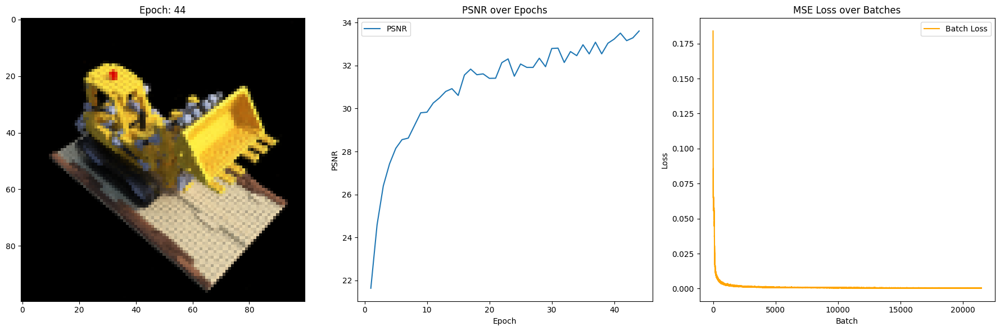

100%|██████████| 488/488 [00:22<00:00, 21.30it/s]


PSNR score=tensor([33.5172])
Average loss per epoch = 0.00034236243789296096


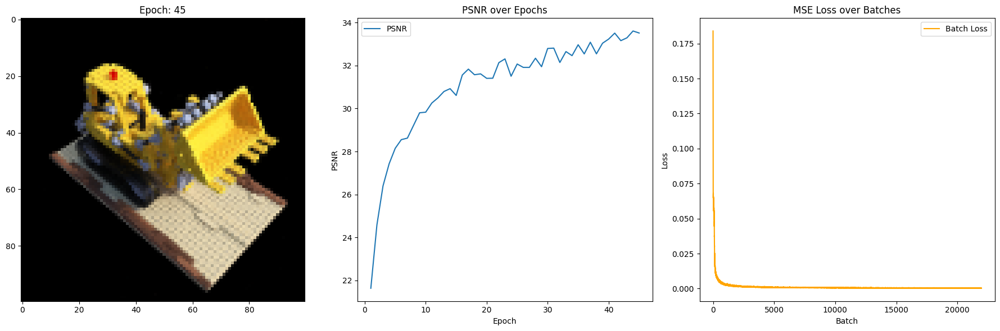

100%|██████████| 488/488 [00:22<00:00, 21.30it/s]


PSNR score=tensor([33.8075])
Average loss per epoch = 0.00034083884795526513


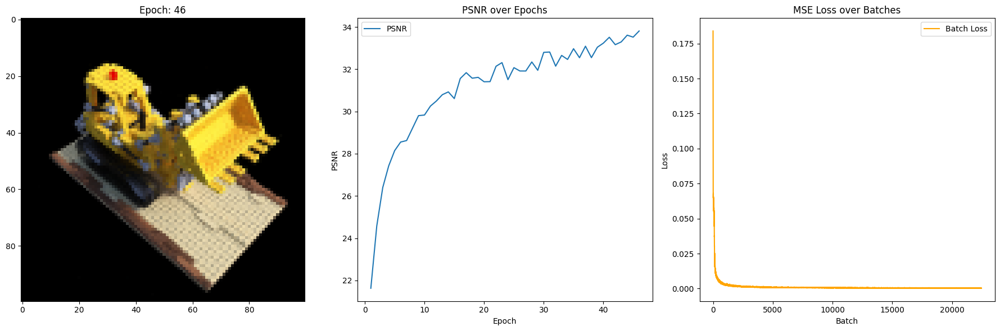

100%|██████████| 488/488 [00:22<00:00, 21.30it/s]


PSNR score=tensor([33.7214])
Average loss per epoch = 0.0003352023527664552


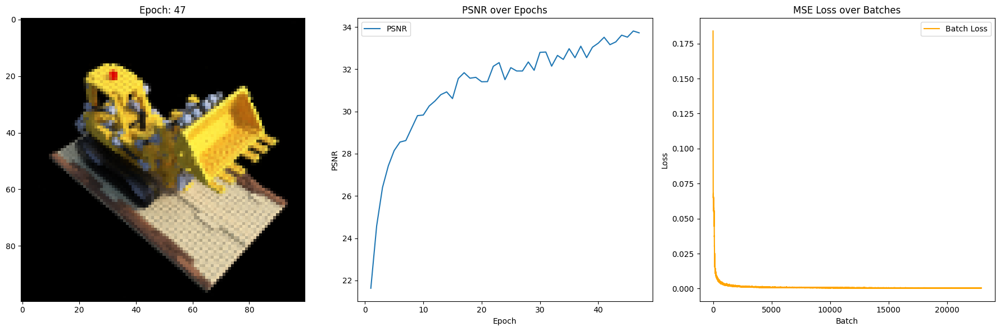

100%|██████████| 488/488 [00:22<00:00, 21.30it/s]


PSNR score=tensor([33.7030])
Average loss per epoch = 0.00032810292616543805


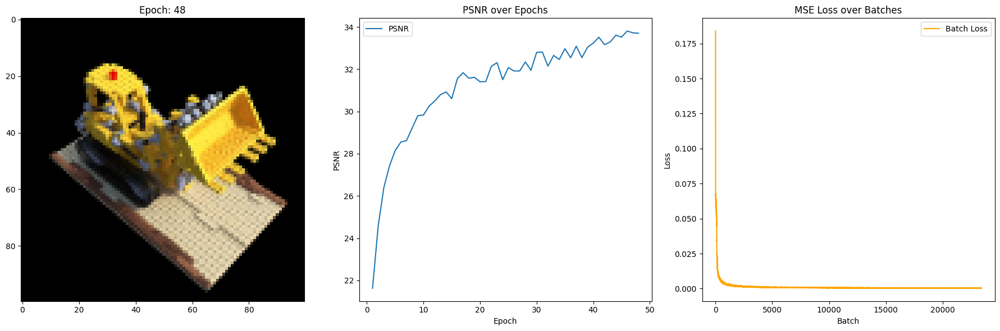

100%|██████████| 488/488 [00:22<00:00, 21.30it/s]


PSNR score=tensor([33.7242])
Average loss per epoch = 0.00032028547520596595


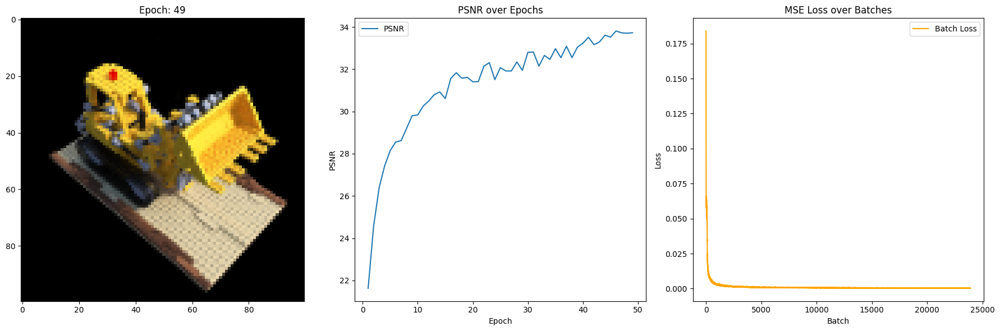

100%|██████████| 488/488 [00:23<00:00, 21.15it/s]


PSNR score=tensor([33.6028])
Average loss per epoch = 0.0003179536293142429


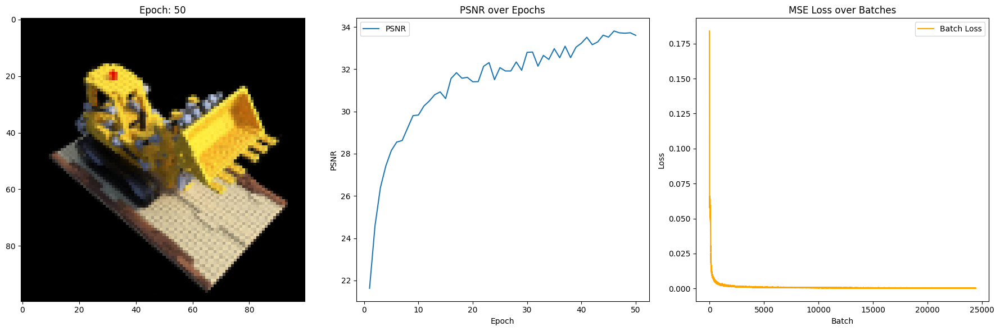

100%|██████████| 488/488 [00:22<00:00, 21.26it/s]


PSNR score=tensor([33.6492])
Average loss per epoch = 0.0003115316615802557


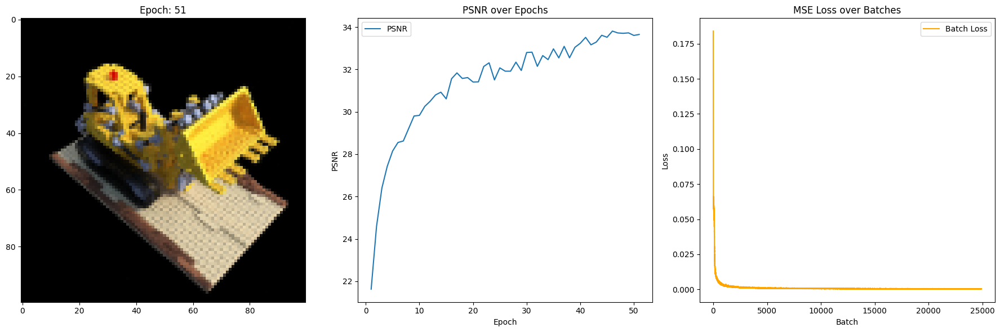

100%|██████████| 488/488 [00:23<00:00, 21.14it/s]


PSNR score=tensor([33.8915])
Average loss per epoch = 0.00030987459804684297


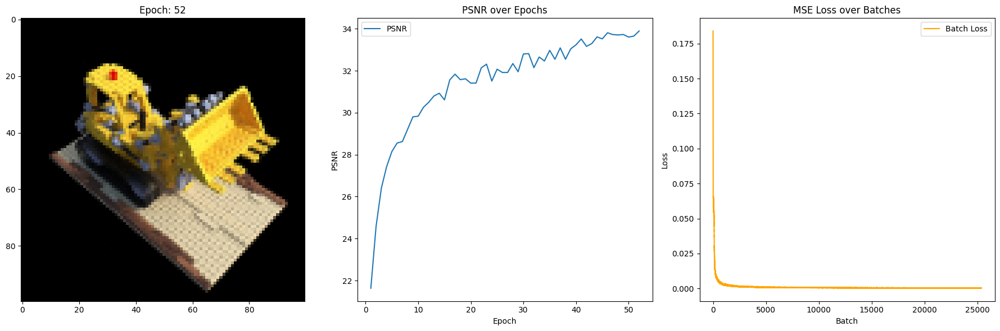

100%|██████████| 488/488 [00:23<00:00, 21.18it/s]


PSNR score=tensor([33.5827])
Average loss per epoch = 0.0003063969427889564


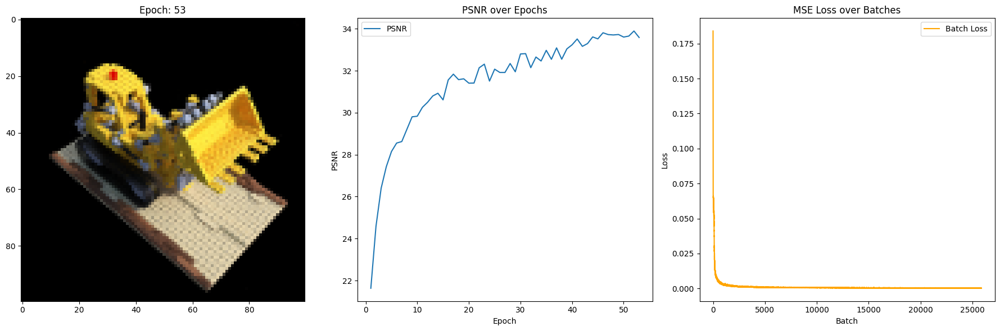

100%|██████████| 488/488 [00:22<00:00, 21.39it/s]


PSNR score=tensor([33.8094])
Average loss per epoch = 0.0002969888229300955


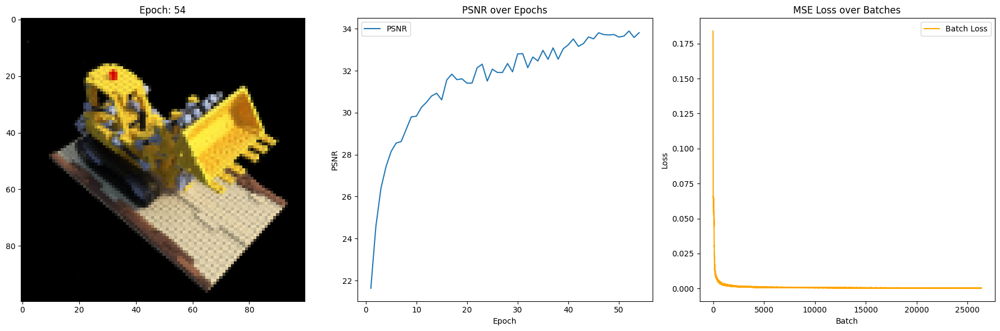

100%|██████████| 488/488 [00:22<00:00, 21.29it/s]


PSNR score=tensor([33.3020])
Average loss per epoch = 0.00029696681056401626


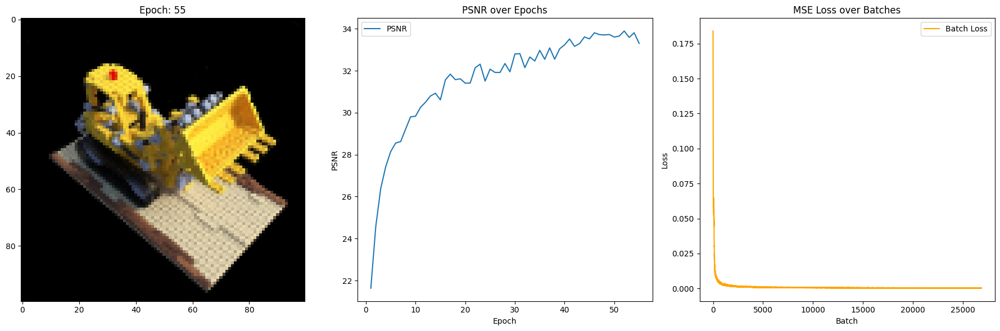

100%|██████████| 488/488 [00:23<00:00, 21.21it/s]


PSNR score=tensor([33.8832])
Average loss per epoch = 0.0002945532151435876


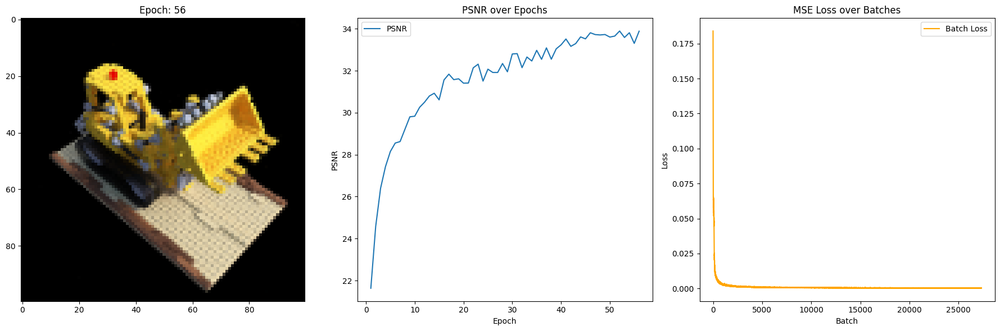

100%|██████████| 488/488 [00:22<00:00, 21.39it/s]


PSNR score=tensor([33.7696])
Average loss per epoch = 0.00029018223015510395


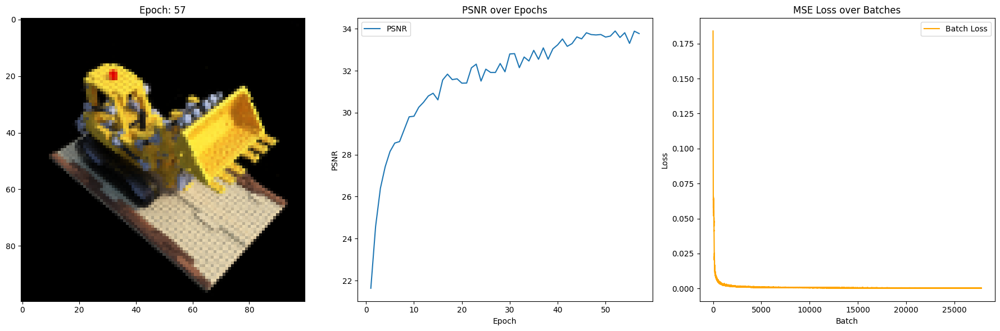

100%|██████████| 488/488 [00:22<00:00, 21.31it/s]


PSNR score=tensor([33.9165])
Average loss per epoch = 0.00028575134000093983


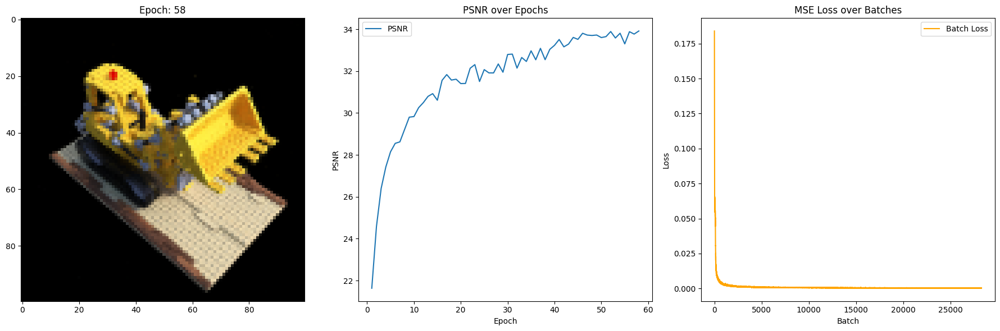

100%|██████████| 488/488 [00:22<00:00, 21.31it/s]


PSNR score=tensor([34.0541])
Average loss per epoch = 0.0002840011190722284


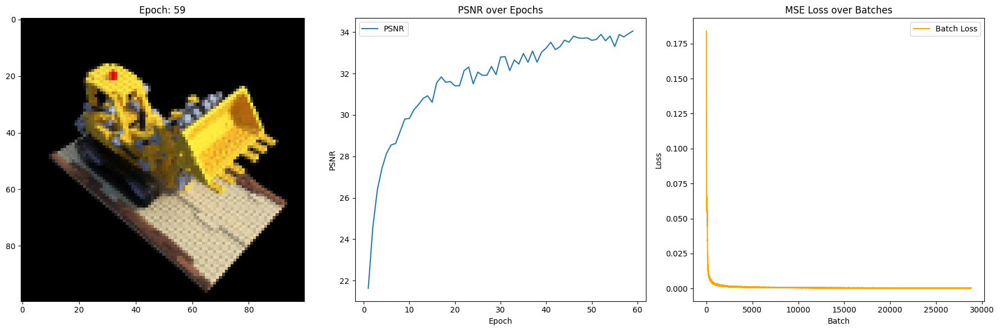

100%|██████████| 488/488 [00:22<00:00, 21.26it/s]


PSNR score=tensor([33.9656])
Average loss per epoch = 0.0002748296409976558


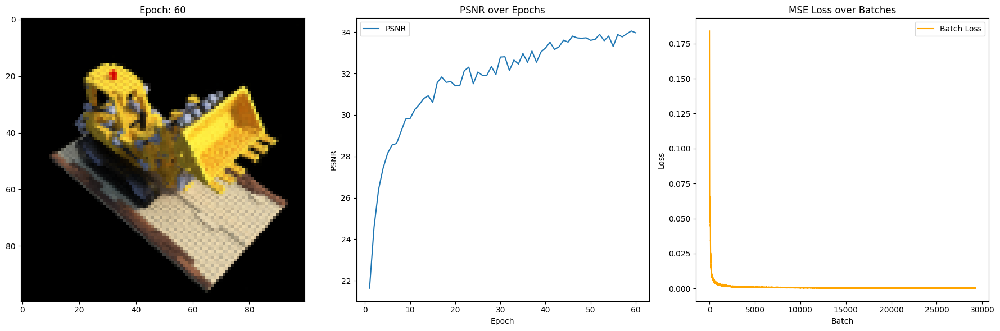

100%|██████████| 488/488 [00:22<00:00, 21.30it/s]


PSNR score=tensor([34.2333])
Average loss per epoch = 0.0002760212519504302


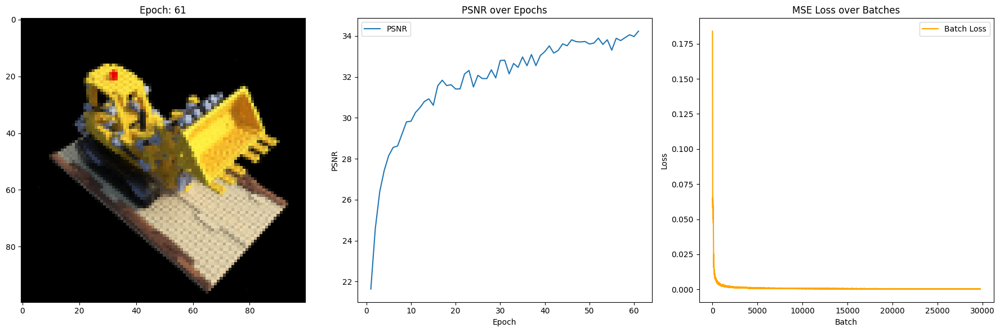

100%|██████████| 488/488 [00:22<00:00, 21.32it/s]


PSNR score=tensor([33.2505])
Average loss per epoch = 0.00027170604448283634


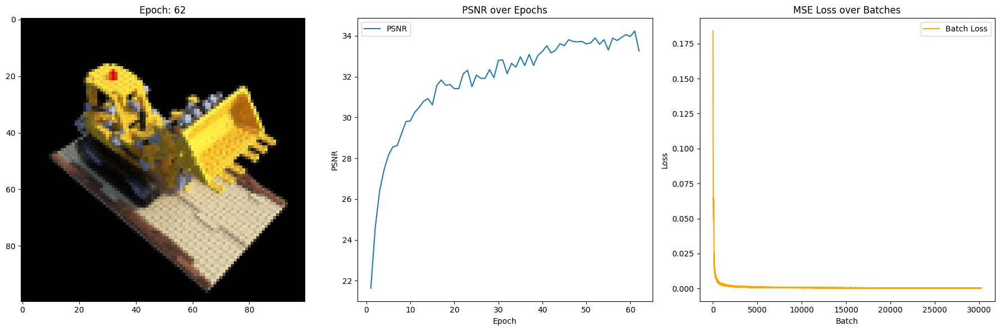

100%|██████████| 488/488 [00:22<00:00, 21.27it/s]


PSNR score=tensor([34.3006])
Average loss per epoch = 0.00026415583715043184


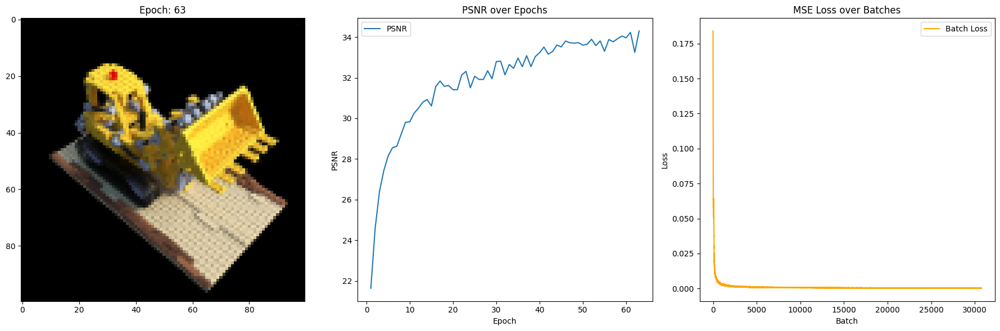

100%|██████████| 488/488 [00:22<00:00, 21.27it/s]


PSNR score=tensor([34.3296])
Average loss per epoch = 0.0002608498412047963


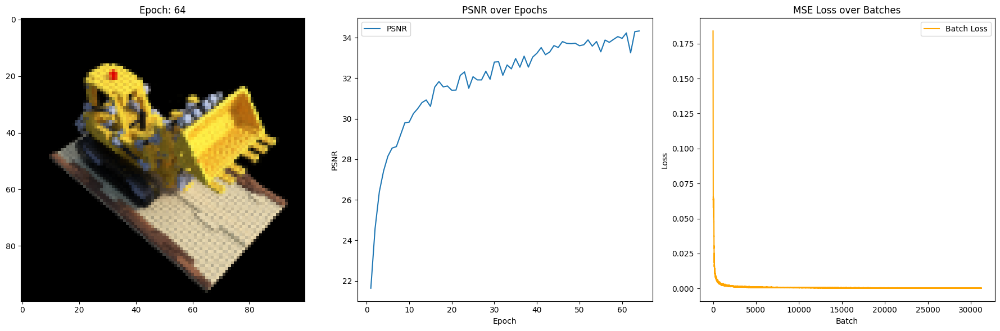

100%|██████████| 488/488 [00:22<00:00, 21.24it/s]


PSNR score=tensor([34.1138])
Average loss per epoch = 0.00025930114134098403


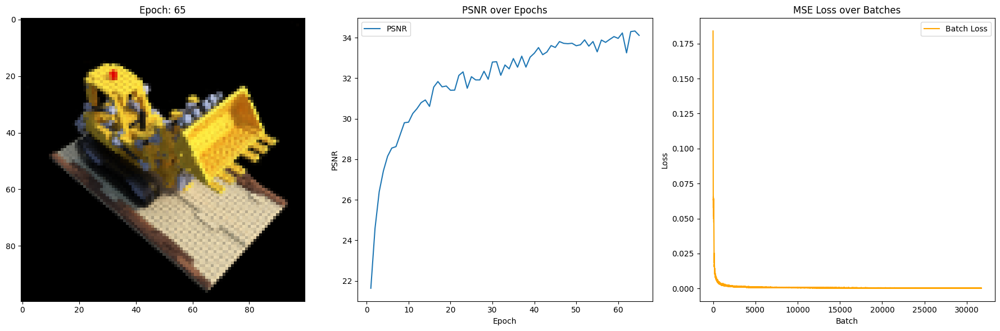

100%|██████████| 488/488 [00:22<00:00, 21.29it/s]


PSNR score=tensor([34.0913])
Average loss per epoch = 0.00025792597861269673


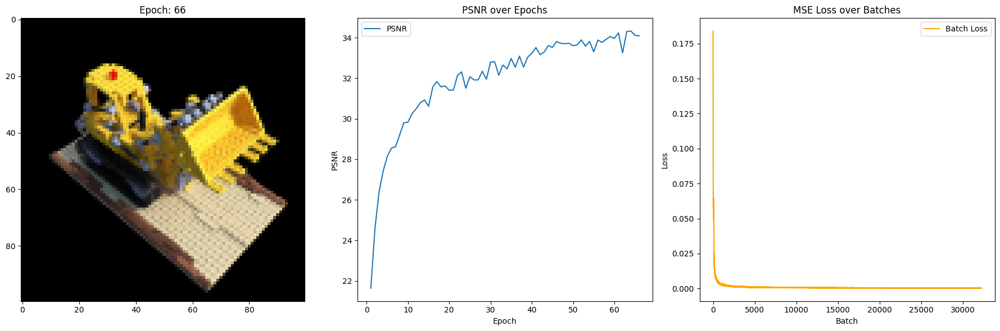

100%|██████████| 488/488 [00:22<00:00, 21.31it/s]


PSNR score=tensor([34.2188])
Average loss per epoch = 0.0002576756998052111


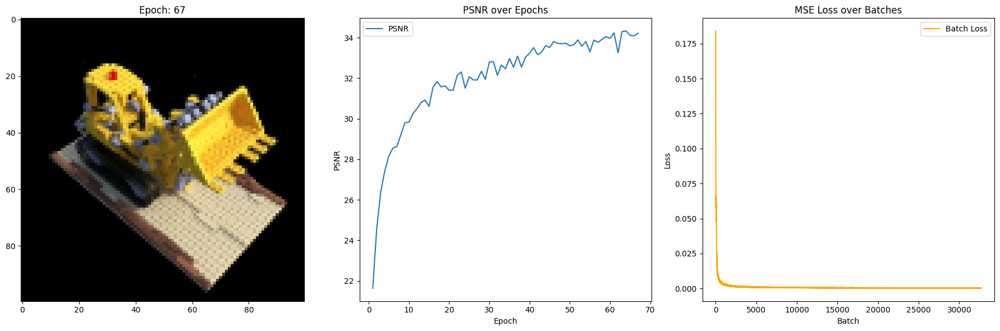

100%|██████████| 488/488 [00:22<00:00, 21.31it/s]


PSNR score=tensor([33.8124])
Average loss per epoch = 0.00025256641120144135


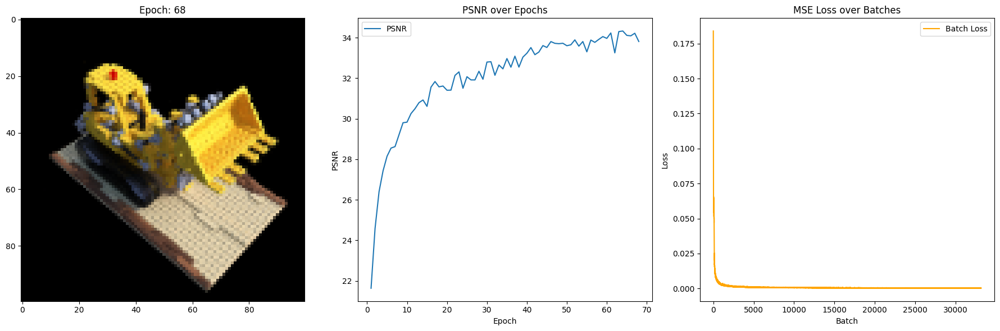

100%|██████████| 488/488 [00:22<00:00, 21.24it/s]


PSNR score=tensor([34.2812])
Average loss per epoch = 0.0002479974388778992


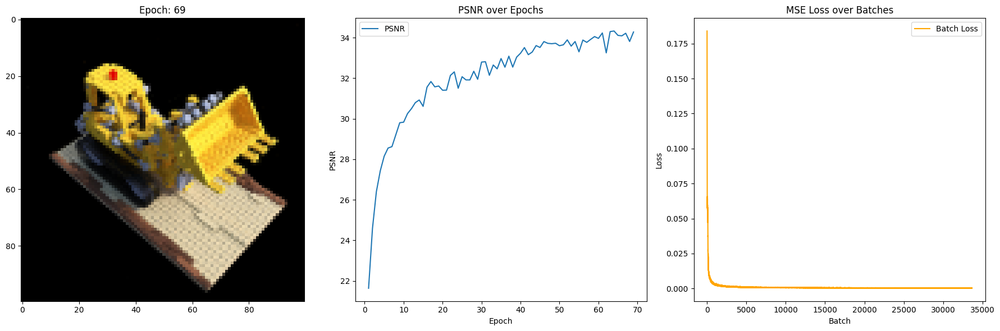

100%|██████████| 488/488 [00:22<00:00, 21.24it/s]


PSNR score=tensor([33.7828])
Average loss per epoch = 0.00024211136265786661


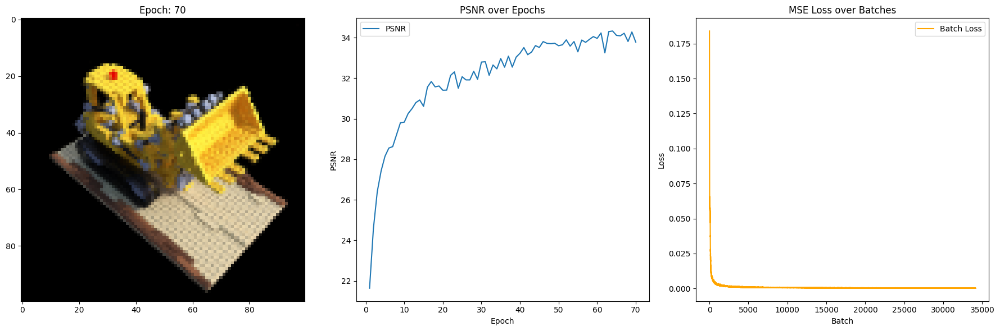

100%|██████████| 488/488 [00:22<00:00, 21.29it/s]


PSNR score=tensor([34.2607])
Average loss per epoch = 0.00024578429743161875


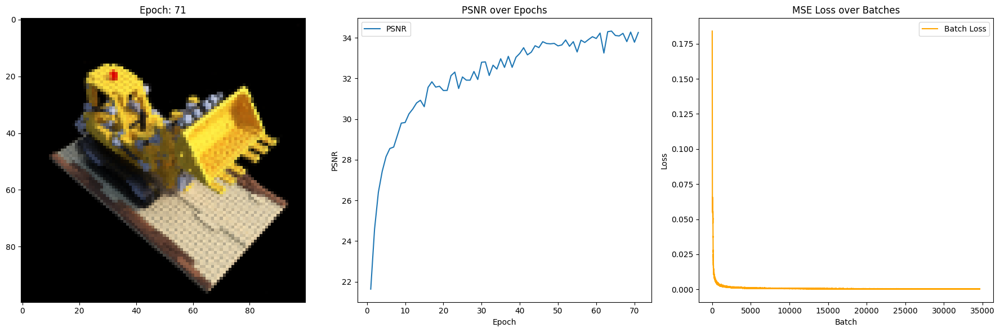

100%|██████████| 488/488 [00:22<00:00, 21.26it/s]


PSNR score=tensor([34.1161])
Average loss per epoch = 0.0002419355952325964


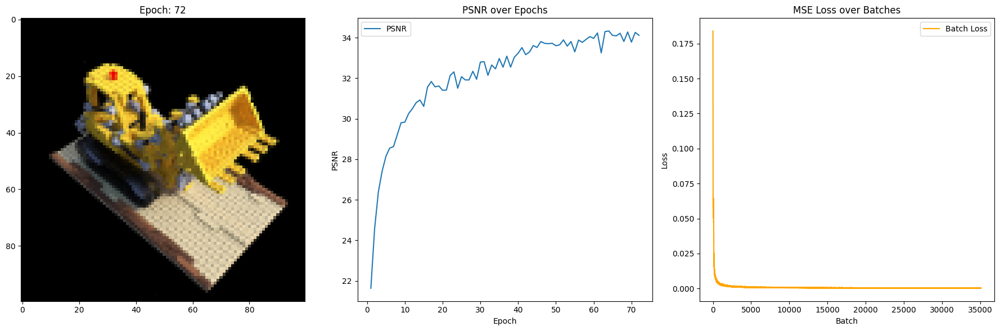

100%|██████████| 488/488 [00:22<00:00, 21.24it/s]


PSNR score=tensor([33.8839])
Average loss per epoch = 0.00023660087235392163


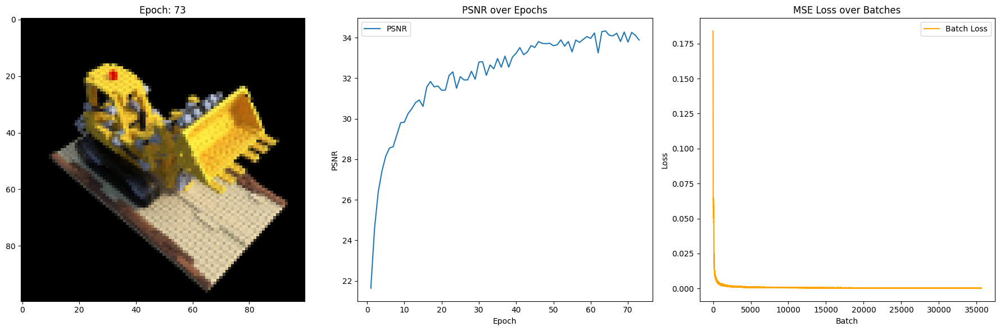

100%|██████████| 488/488 [00:22<00:00, 21.26it/s]


PSNR score=tensor([34.0087])
Average loss per epoch = 0.0002367458669812281


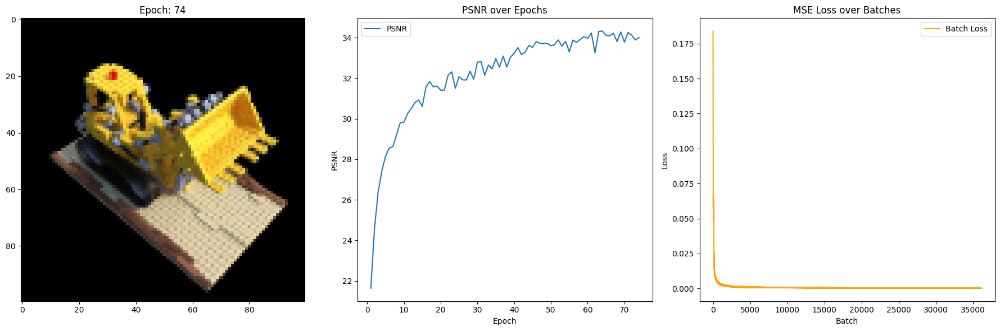

100%|██████████| 488/488 [00:22<00:00, 21.29it/s]


PSNR score=tensor([34.2214])
Average loss per epoch = 0.00023388604313367978


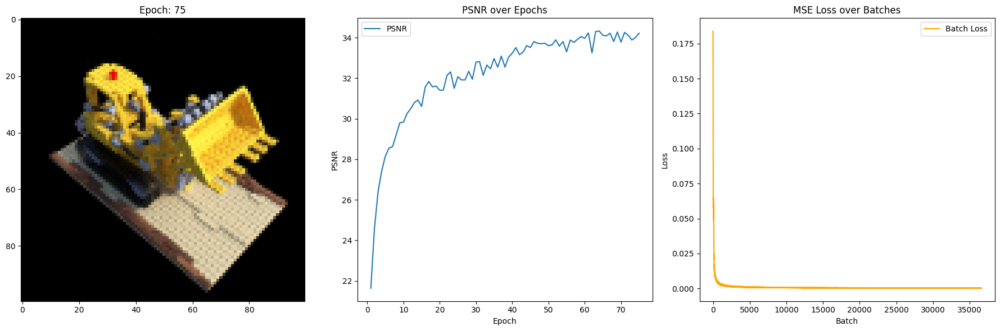

100%|██████████| 488/488 [00:22<00:00, 21.23it/s]


PSNR score=tensor([34.6265])
Average loss per epoch = 0.00022963100598674633


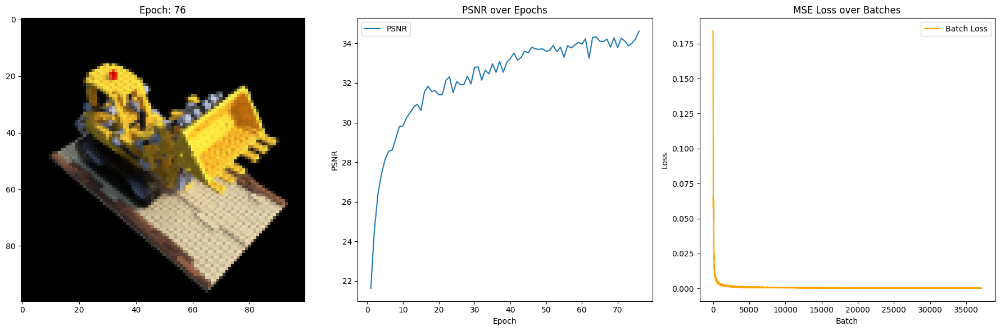

100%|██████████| 488/488 [00:22<00:00, 21.24it/s]


PSNR score=tensor([34.3342])
Average loss per epoch = 0.00022555765746324515


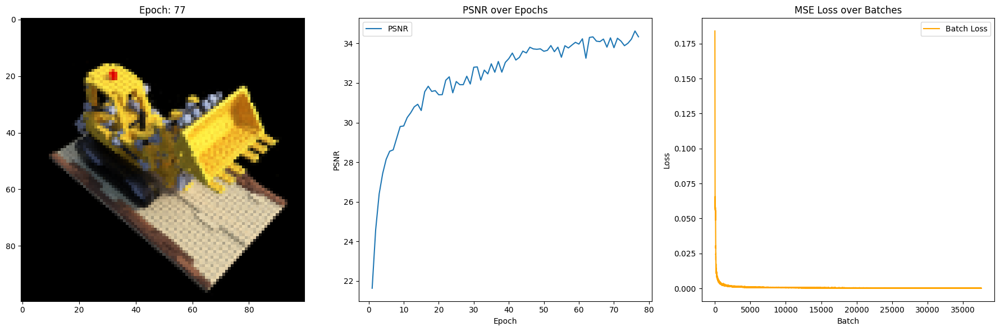

100%|██████████| 488/488 [00:22<00:00, 21.29it/s]


PSNR score=tensor([34.4640])
Average loss per epoch = 0.00022246366768472324


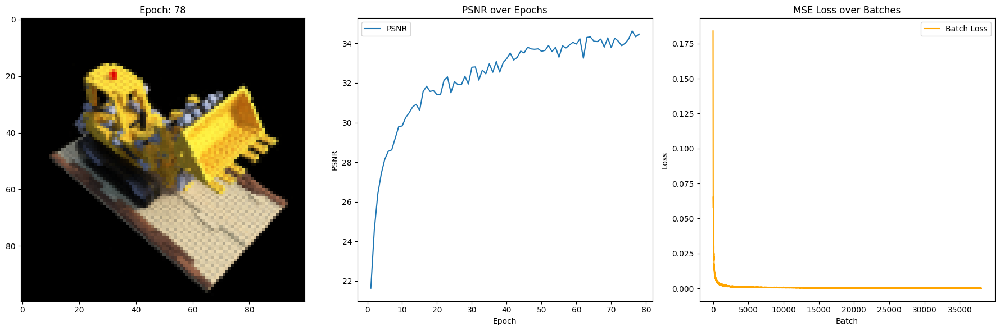

100%|██████████| 488/488 [00:22<00:00, 21.28it/s]


PSNR score=tensor([34.4494])
Average loss per epoch = 0.00022672420387517958


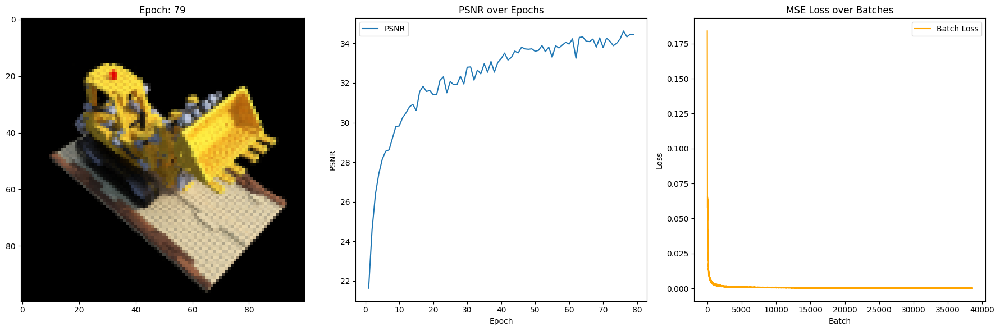

100%|██████████| 488/488 [00:22<00:00, 21.30it/s]


PSNR score=tensor([34.0355])
Average loss per epoch = 0.0002203123331724544


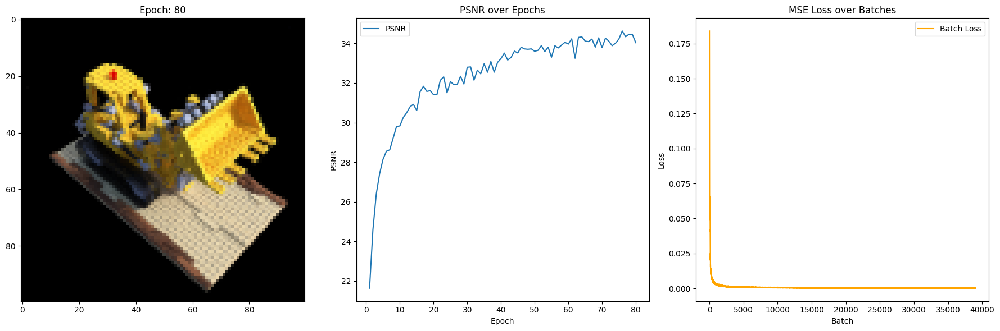

100%|██████████| 488/488 [00:23<00:00, 21.12it/s]


PSNR score=tensor([33.5748])
Average loss per epoch = 0.0002189881878487048


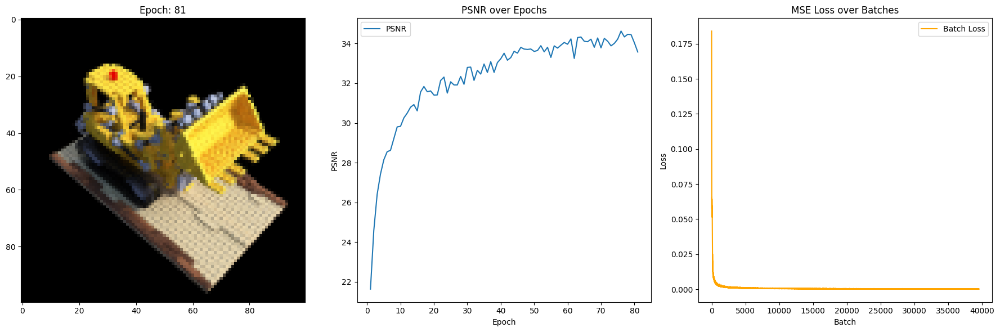

100%|██████████| 488/488 [00:23<00:00, 21.14it/s]


PSNR score=tensor([34.3182])
Average loss per epoch = 0.00021709530387926831


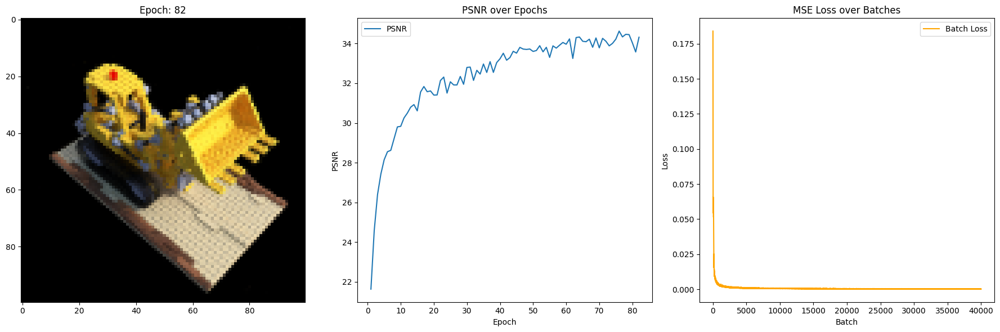

100%|██████████| 488/488 [00:23<00:00, 21.18it/s]


PSNR score=tensor([34.0775])
Average loss per epoch = 0.00025733292148020083


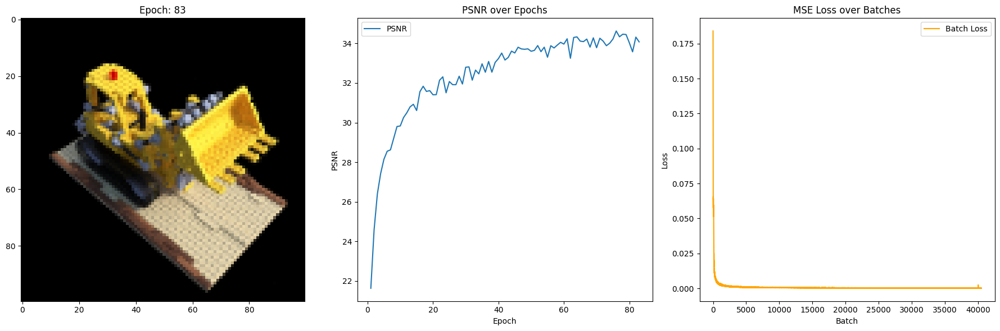

100%|██████████| 488/488 [00:22<00:00, 21.28it/s]


PSNR score=tensor([34.7124])
Average loss per epoch = 0.00020360730529512798


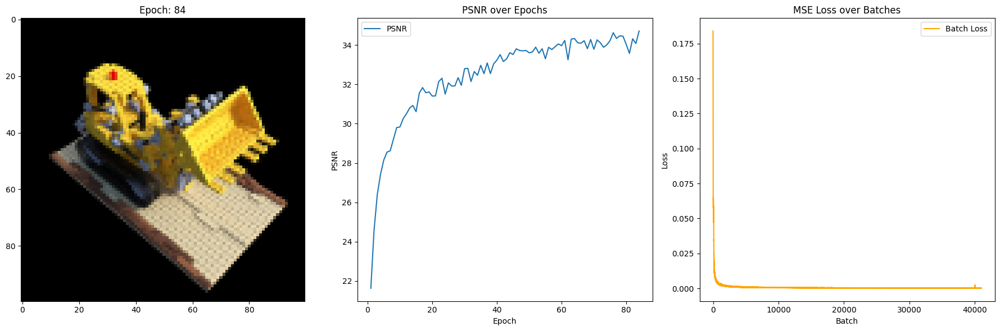

100%|██████████| 488/488 [00:22<00:00, 21.24it/s]


PSNR score=tensor([34.2794])
Average loss per epoch = 0.00020114569302737048


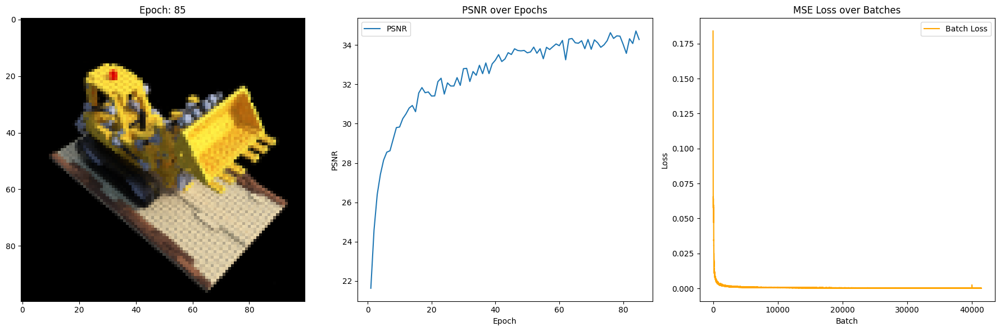

100%|██████████| 488/488 [00:22<00:00, 21.24it/s]


PSNR score=tensor([34.4110])
Average loss per epoch = 0.0002038060142024092


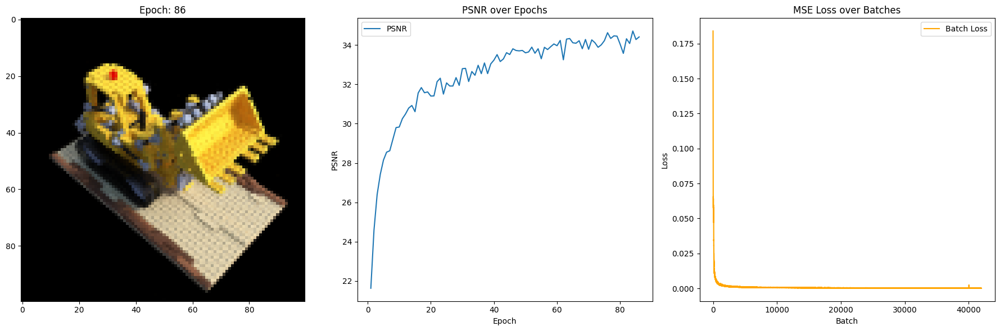

100%|██████████| 488/488 [00:22<00:00, 21.29it/s]


PSNR score=tensor([34.6560])
Average loss per epoch = 0.0002038945663638306


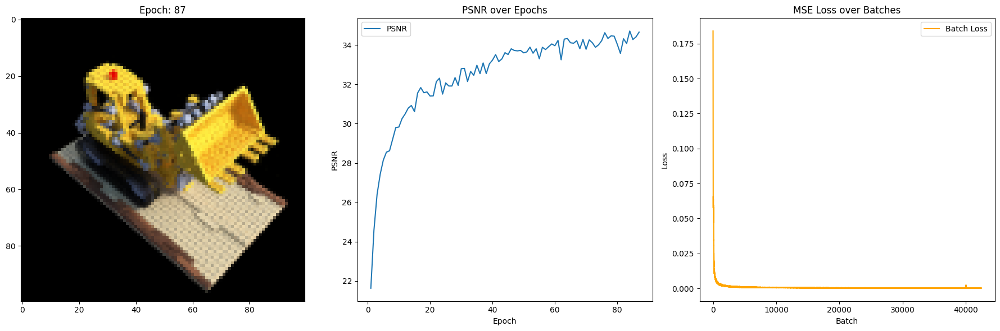

100%|██████████| 488/488 [00:22<00:00, 21.31it/s]


PSNR score=tensor([34.0461])
Average loss per epoch = 0.00020288847831505366


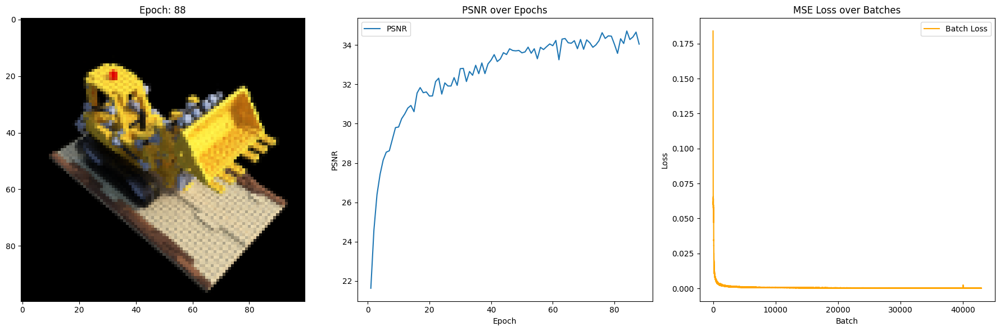

100%|██████████| 488/488 [00:22<00:00, 21.30it/s]


PSNR score=tensor([33.8348])
Average loss per epoch = 0.00019959272986986925


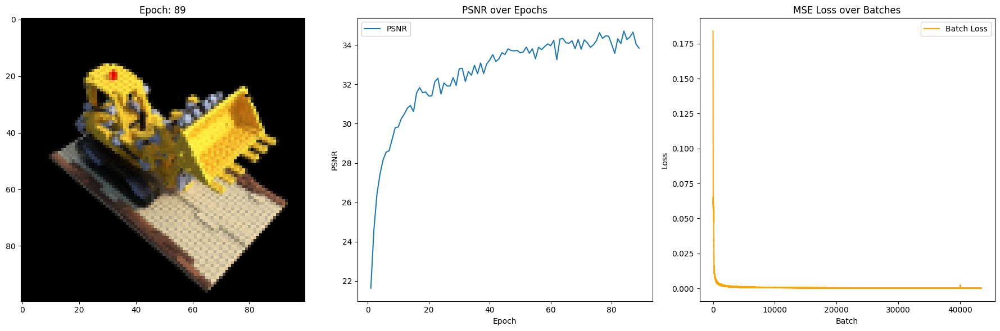

100%|██████████| 488/488 [00:22<00:00, 21.30it/s]


PSNR score=tensor([34.6465])
Average loss per epoch = 0.00020183769698096362


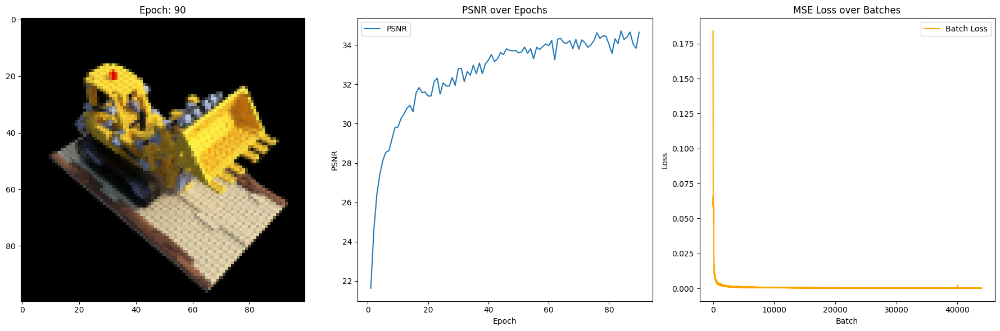

100%|██████████| 488/488 [00:22<00:00, 21.28it/s]


PSNR score=tensor([34.7518])
Average loss per epoch = 0.00020053426964832547


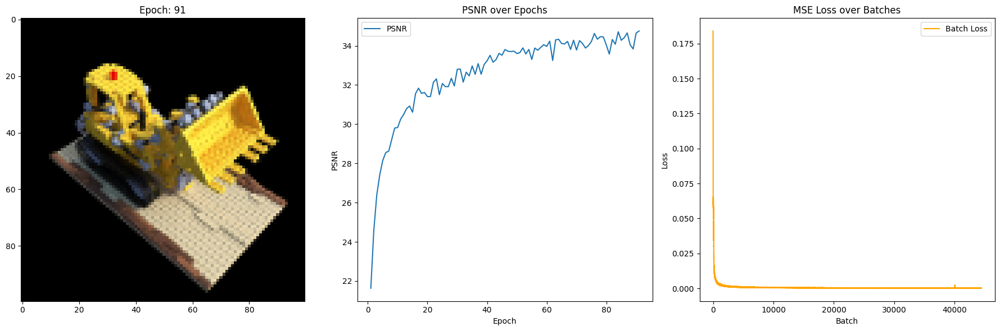

100%|██████████| 488/488 [00:22<00:00, 21.23it/s]


PSNR score=tensor([34.8288])
Average loss per epoch = 0.00020069885699815101


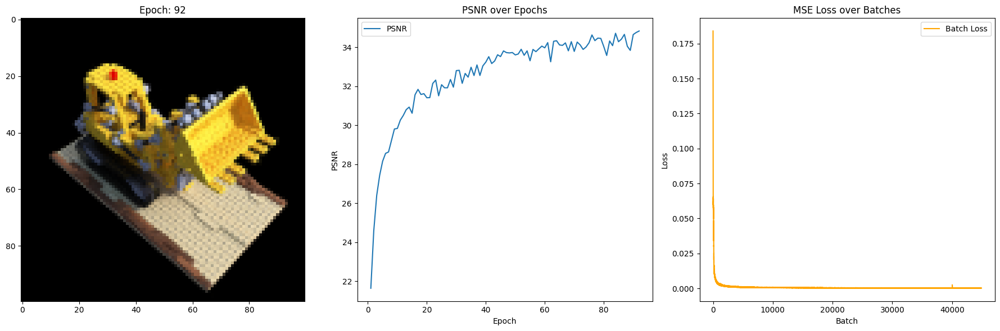

100%|██████████| 488/488 [00:22<00:00, 21.29it/s]


PSNR score=tensor([34.6920])
Average loss per epoch = 0.0001930329203116612


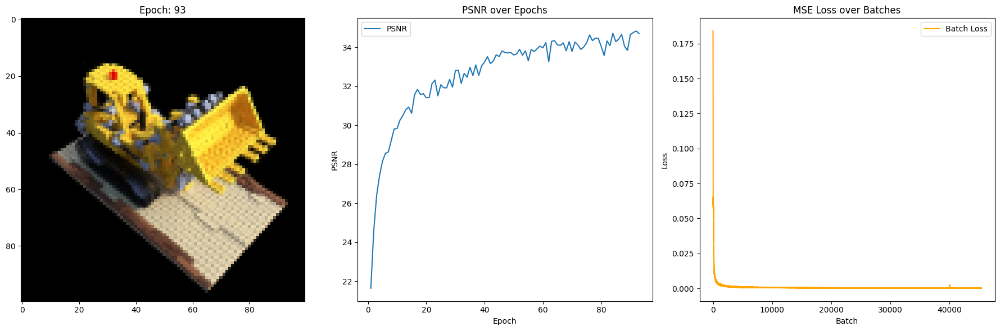

100%|██████████| 488/488 [00:22<00:00, 21.23it/s]


PSNR score=tensor([34.6398])
Average loss per epoch = 0.00019258502655501332


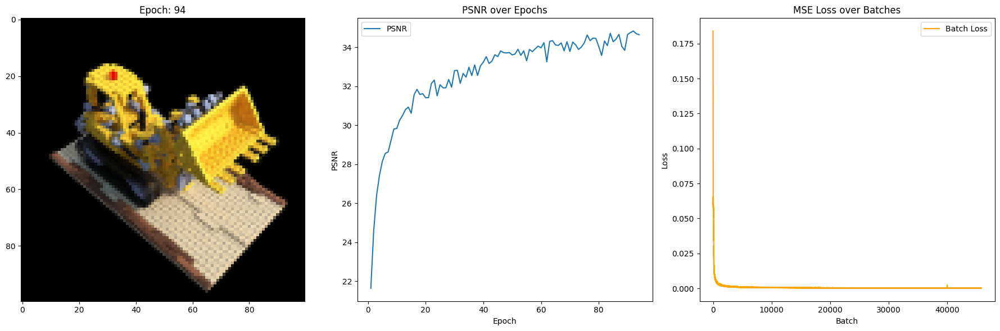

100%|██████████| 488/488 [00:22<00:00, 21.25it/s]


PSNR score=tensor([34.6357])
Average loss per epoch = 0.00019185230517965076


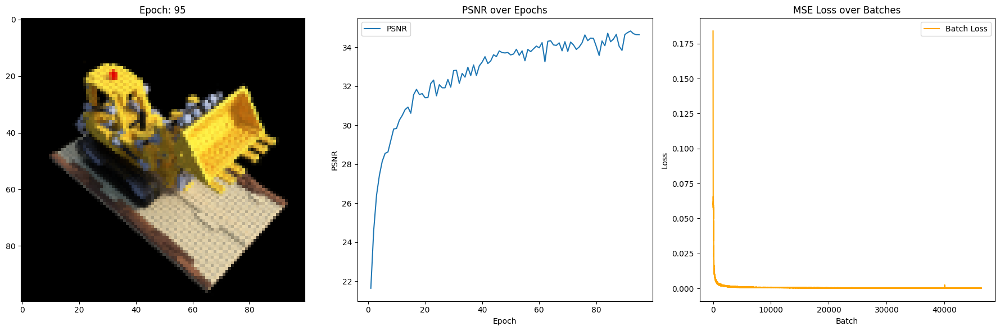

100%|██████████| 488/488 [00:22<00:00, 21.37it/s]


PSNR score=tensor([34.5806])
Average loss per epoch = 0.00019115599284528709


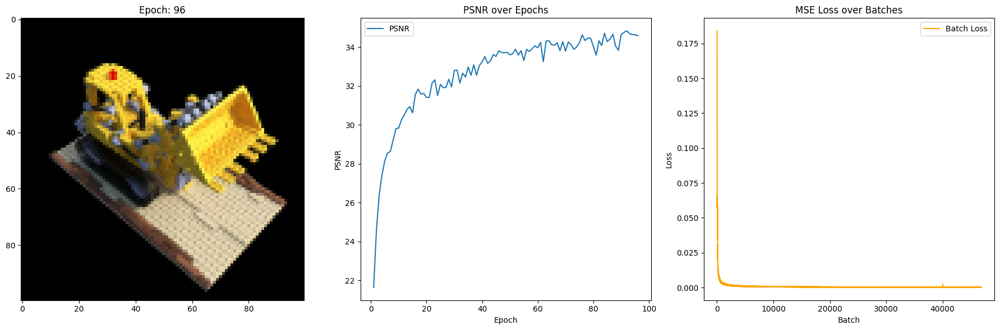

100%|██████████| 488/488 [00:23<00:00, 21.18it/s]


PSNR score=tensor([34.7358])
Average loss per epoch = 0.00018838495571933472


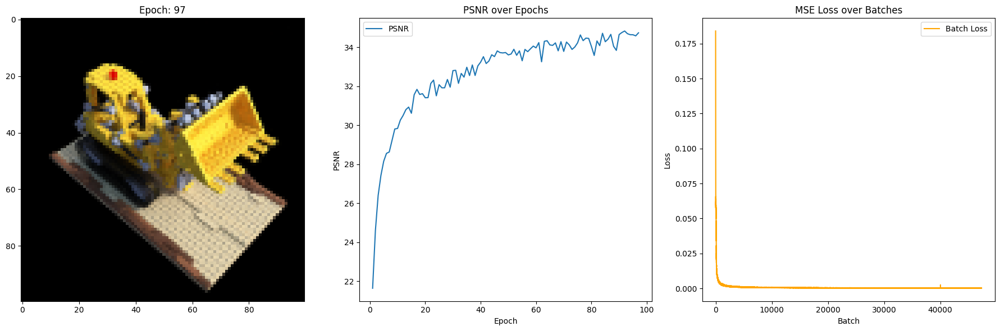

100%|██████████| 488/488 [00:23<00:00, 21.20it/s]


PSNR score=tensor([34.1233])
Average loss per epoch = 0.00018967492402136157


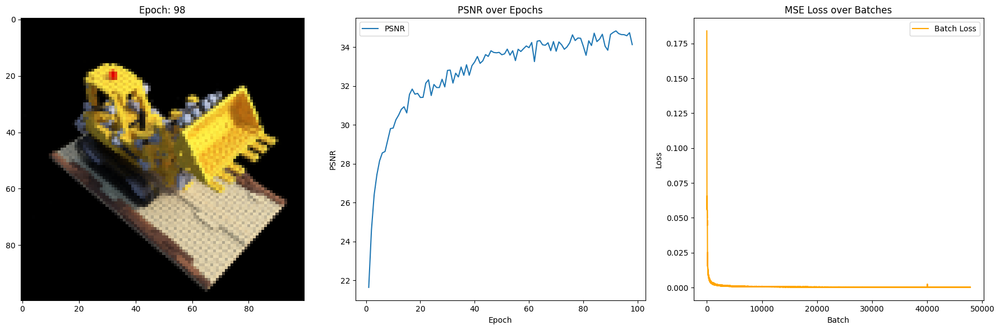

100%|██████████| 488/488 [00:22<00:00, 21.31it/s]


PSNR score=tensor([34.5043])
Average loss per epoch = 0.00018530108172853943


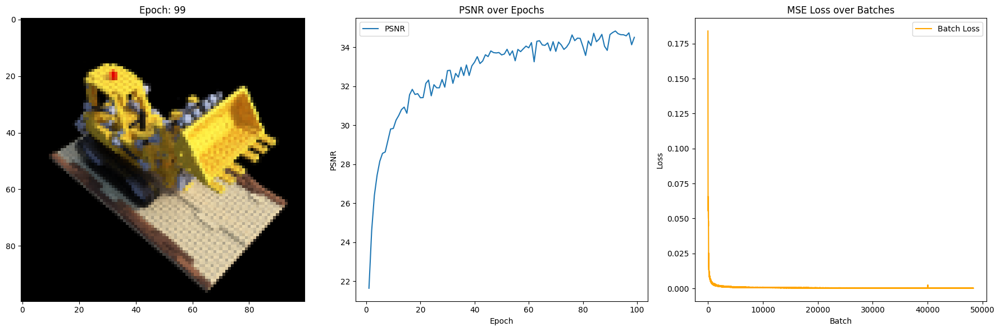

100%|██████████| 488/488 [00:22<00:00, 21.31it/s]


PSNR score=tensor([34.6326])
Average loss per epoch = 0.00018255940395632574


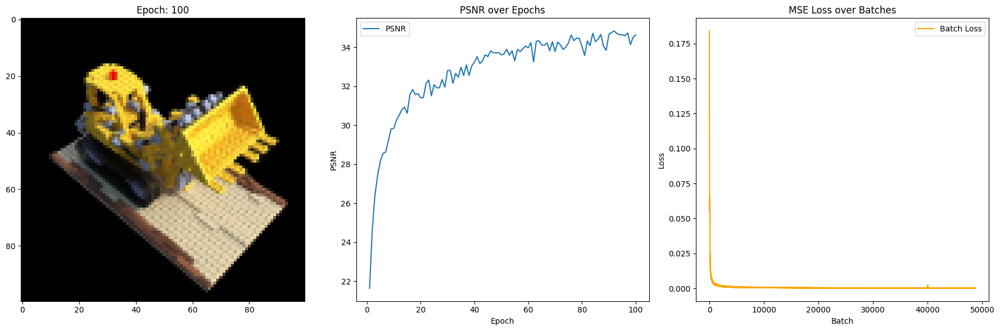

In [ ]:

# Sample rays for all images
sampled_rays = [
    sample_rays_numpy(height, width, focal_length, pose_data[img_idx])
    for img_idx in range(num_training_images)
]

# Unpack sampled rays
ray_origins_list, ray_directions_list = zip(*sampled_rays)

# Reshape rays and images
ray_origins_list = [orig.reshape(-1, 3) for orig in ray_origins_list]
ray_directions_list = [dir.reshape(-1, 3) for dir in ray_directions_list]
list_rays = [image_data[img_idx].reshape(-1, 3) for img_idx in range(num_training_images)]

# Convert lists to numpy arrays and stack them vertically
ray_origins_array = np_lib.vstack(ray_origins_list)
ray_directions_array = np_lib.vstack(ray_directions_list)
ray_rgb_array = np_lib.vstack(list_rays)

# Verify the shapes to ensure correctness (optional debugging step)
assert ray_origins_array.shape[0] == ray_directions_array.shape[0] == ray_rgb_array.shape[0], "Mismatch in number of rays"

# Combine all ray components into a single numpy array
rays_combined_array = np_lib.hstack([ray_origins_array, ray_directions_array, ray_rgb_array])

# Convert the combined numpy array to a PyTorch tensor
rays = torch_lib.tensor(rays_combined_array, device=computation_device)

# parameters of training

batch_size = 2048
num_total_rays = rays.shape[0]
print(f"The number of batches is {num_total_rays // batch_size} and each batch has {batch_size} rays")


num_epochs = 100
psnr_history = []
epoch_indices = []
depth_bounds = (2.0, 6.0)
sample_counts = (64, 32)
directions_use_view = True

# Sample rays for the test image
test_ray_origins, test_ray_directions = sample_rays_numpy(height, width, focal_length, test_pose)

# Create a dictionary to store the test data
test_data = {
    'ray_origins': test_ray_origins,
    'ray_directions': test_ray_directions,
    'rgb': test_image
}

# Convert all test data to PyTorch tensors and store them back in the dictionary
test_data_tensors = {key: torch_lib.tensor(value, device=computation_device) for key, value in test_data.items()}

# Extract the tensors from the dictionary
test_ray_origins_tensor = test_data_tensors['ray_origins']
test_ray_directions_tensor = test_data_tensors['ray_directions']
test_rgb_tensor = test_data_tensors['rgb']

# train

nerf_model = NeuralRadianceField(directions_use_view=directions_use_view).to(computation_device)
optimizer_adm = optim_lib.Adam(nerf_model.parameters(), lr=5e-4)
mean_squared_error = nn_lib.MSELoss()

num_batches = num_total_rays // batch_size
epoch_indices = []
psnr_history = []
batch_loss_history = []

for epoch in range(num_epochs):
    # Randomly permute the order of rays
    random_indices = torch_lib.randperm(num_total_rays)
    permuted_rays = rays[random_indices, :]

    # Split permuted rays into batches for training
    training_batches = iter(torch_lib.chunk(permuted_rays, int(num_total_rays / batch_size), dim=0))

    epoch_loss = 0

    for batch_index in progress_lib(range(num_batches)):
        batch_rays = next(training_batches)

        trial_dim = -1
        ray_origins_batch, ray_directions_batch, target_rgb_batch = torch_lib.chunk(batch_rays, 3, dim=trial_dim)
        batch_ray_origins_directions = (ray_origins_batch, ray_directions_batch)
        predicted_rgb, _, __ = rendering(nerf_model, batch_ray_origins_directions, bounds=depth_bounds, num_samples=sample_counts, comp_device=computation_device, directions_use_view=directions_use_view)
        losses = mean_squared_error(predicted_rgb, target_rgb_batch)
        optimizer_adm.zero_grad()

        losses.backward()

        optimizer_adm.step()

        epoch_loss += losses.item()
        batch_loss_history.append(losses.item())  # Collecting batch loss

    # Average loss over all batches in the epoch
    epoch_loss /= num_batches

    with torch_lib.no_grad():
        pred_rgb = []
        test_shape = test_ray_origins_tensor.shape[0]
        for ray_index in range(test_shape):
            # Extract the origin and direction for the test ray at the specified index and combine them using zip
            test_ray_data = next(zip(
                test_ray_origins_tensor[ray_index].unsqueeze(0),
                test_ray_directions_tensor[ray_index].unsqueeze(0)
            ))

            # Flatten the tuple
            ray_origins_directions_test = tuple(test_ray_data)

            predicted_rgb, _, __ = rendering(nerf_model, ray_origins_directions_test, bounds=depth_bounds, num_samples=sample_counts, comp_device=computation_device, directions_use_view=directions_use_view)

            fix_rgb_pred = predicted_rgb.unsqueeze(0)

            pred_rgb.append(fix_rgb_pred)

        predicted_rgb_tensor = torch_lib.cat(pred_rgb, dim=0)
        test_loss = mean_squared_error(predicted_rgb_tensor, test_rgb_tensor).cpu()
        psnr_value = -10.0 * torch_lib.log(test_loss).item() / torch_lib.log(torch_lib.tensor([10.0]))
        print(f"PSNR score={psnr_value}")
        print(f"Average loss per epoch = {epoch_loss}")

        epoch_step = epoch + 1
        epoch_indices.append(epoch_step)
        psnr_history.append(psnr_value)

        # Plot PSNR, Training Loss, and Batch Loss
        plot_lib.figure(figsize=(18, 6))

        # Plot predicted RGB
        plot_lib.subplot(131)
        var_pred = predicted_rgb_tensor.cpu().detach()
        plot_lib.imshow(var_pred.numpy())
        plot_lib.title(f'Epoch: {epoch_step}')

        # Plot PSNR
        plot_lib.subplot(132)
        plot_lib.plot(epoch_indices, psnr_history, label='PSNR')
        plot_lib.xlabel('Epoch')
        plot_lib.ylabel('PSNR')
        plot_lib.title('PSNR over Epochs')
        plot_lib.legend()

        # Plot Batch Loss
        plot_lib.subplot(133)
        plot_lib.plot(batch_loss_history, label='Batch Loss', color='orange')
        plot_lib.xlabel('Batch')
        plot_lib.ylabel('Loss')
        plot_lib.title('MSE Loss over Batches')
        plot_lib.legend()

        plot_lib.tight_layout()
        plot_lib.show()


In [ ]:
!pip install imageio
!pip install imageio[pyav]
!pip install imageio[ffmpeg]

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 313.5/313.5 kB 14.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.3/34.3 MB 51.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 60.4 MB/s eta 0:00:00:00:0100:01


In [ ]:
import numpy as np_lib
import torch as torch_lib
import matplotlib.pyplot as plot_lib
from IPython.display import HTML as ipython_html_display
from ipywidgets import widgets as widget_lib, interactive as interactive_lib
from base64 import b64encode as encode_base64
import imageio as imageio_lib

def create_rotation_matrix_phi(angle_phi):
    return np_lib.array([
        [1, 0, 0, 0],
        [0, np_lib.cos(angle_phi), -np_lib.sin(angle_phi), 0],
        [0, np_lib.sin(angle_phi), np_lib.cos(angle_phi), 0],
        [0, 0, 0, 1],
    ], dtype=float)

def create_rotation_matrix_theta(angle_theta):
    return np_lib.array([
        [np_lib.cos(angle_theta), 0, -np_lib.sin(angle_theta), 0],
        [0, 1, 0, 0],
        [np_lib.sin(angle_theta), 0, np_lib.cos(angle_theta), 0],
        [0, 0, 0, 1],
    ], dtype=float)

# Define the transformation functions
def create_translation_matrix(distance):
    return np_lib.array([
        [1, 0, 0, 0],
        [0, 1, 0, 0],
        [0, 0, 1, distance],
        [0, 0, 0, 1],
    ], dtype=float)

def calculate_camera_pose(theta_angle, phi_angle, cam_radius):
    cam_to_world_matrix = create_translation_matrix(cam_radius)
    cam_to_world_matrix = create_rotation_matrix_phi(phi_angle / 180. * np_lib.pi) @ cam_to_world_matrix
    cam_to_world_matrix = create_rotation_matrix_theta(theta_angle / 180. * np_lib.pi) @ cam_to_world_matrix
    cam_to_world_matrix = np_lib.array([[-1, 0, 0, 0], [0, 0, 1, 0], [0, 1, 0, 0], [0, 0, 0, 1]]) @ cam_to_world_matrix
    return cam_to_world_matrix



In [ ]:
import numpy as np_lib
import torch as torch_lib
from tqdm import tqdm as progress_lib
import imageio as imageio_lib

rendered_frames = []
pred_rgb = []
for theta_angle in progress_lib(np_lib.linspace(0.0, 360.0, 120, endpoint=False)):
    with torch_lib.no_grad():
        camera_to_world_matrix = calculate_camera_pose(theta_angle, -30.0, 4.0)
        ray_origins, ray_directions = sample_rays_numpy(height, width, focal_length, camera_to_world_matrix[:3, :4])

        for ray_index in range(ray_origins.shape[0]):
            ray_origins_directions_test = (T.tensor(ray_origins[ray_index], dtype=T.float32).to(computation_device),T.tensor(ray_directions[ray_index], dtype=T.float32).to(computation_device))

            rgb_output, depth_output, acc_output = rendering(
                nerf_model, ray_origins_directions_test, bounds=depth_bounds, num_samples=sample_counts, comp_device=computation_device, directions_use_view=directions_use_view
            )

            rgb_output = rgb_output.unsqueeze(0)

            pred_rgb.append(rgb_output)
    predicted_rgb_tensor = torch_lib.cat(pred_rgb, dim=0)
    rendered_frames.append((255 * np_lib.clip(predicted_rgb_tensor.cpu().numpy(), 0, 1)).astype(np_lib.uint8))
    pred_rgb=[]

video_filename = 'rendered_video.mp4'
imageio_lib.mimwrite(video_filename, rendered_frames, fps=20, quality=10)


100%|██████████| 120/120 [00:32<00:00,  3.69it/s]
IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (100, 100) to (112, 112) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).
[swscaler @ 0x6deba80] Warning: data is not aligned! This can lead to a speed loss


In [ ]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('rendered_video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

The number of batches is 488 and each batch has 2048 rays


100%|██████████| 488/488 [00:12<00:00, 38.28it/s]


PSNR score=tensor([21.2183])
Average loss per epoch = 0.025320117472533564


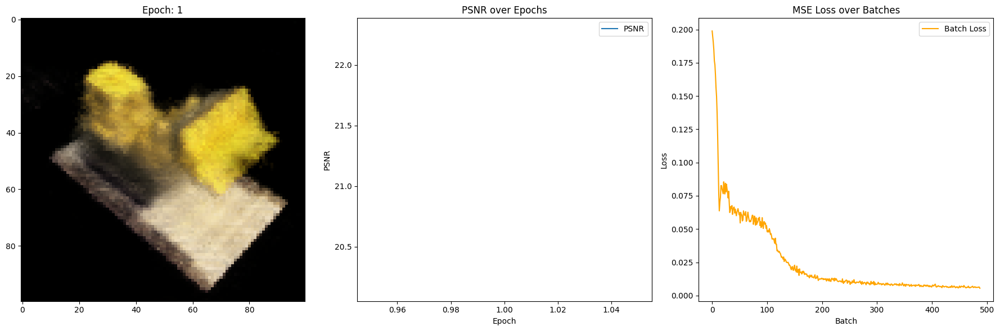

100%|██████████| 488/488 [00:12<00:00, 38.25it/s]


PSNR score=tensor([23.7856])
Average loss per epoch = 0.0045687071525789495


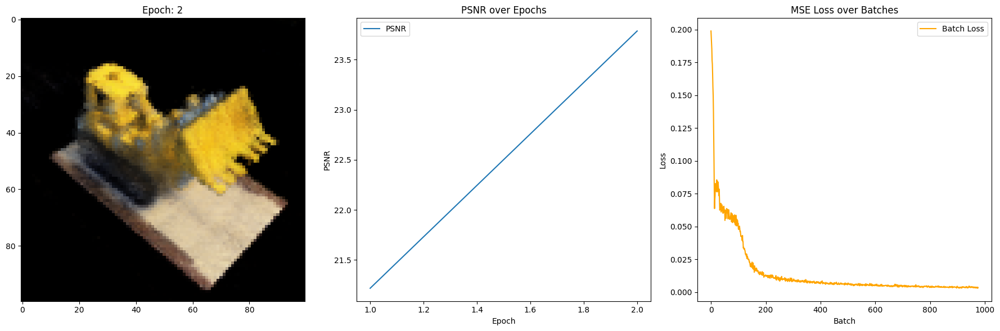

100%|██████████| 488/488 [00:12<00:00, 37.93it/s]


PSNR score=tensor([25.3269])
Average loss per epoch = 0.00286884062024612


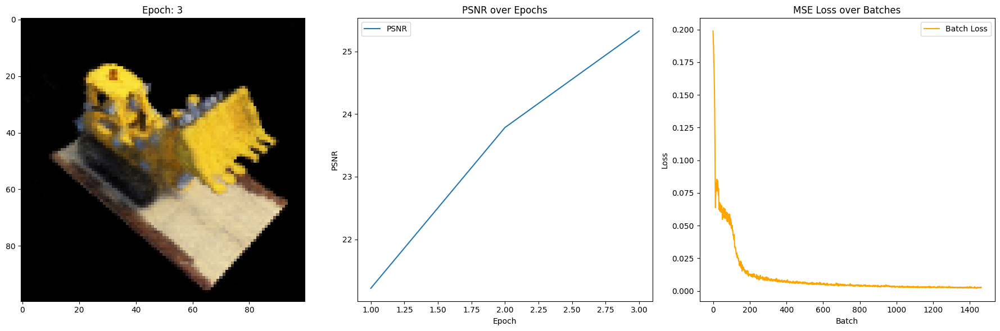

100%|██████████| 488/488 [00:12<00:00, 37.91it/s]


PSNR score=tensor([26.0861])
Average loss per epoch = 0.0022172483049722417


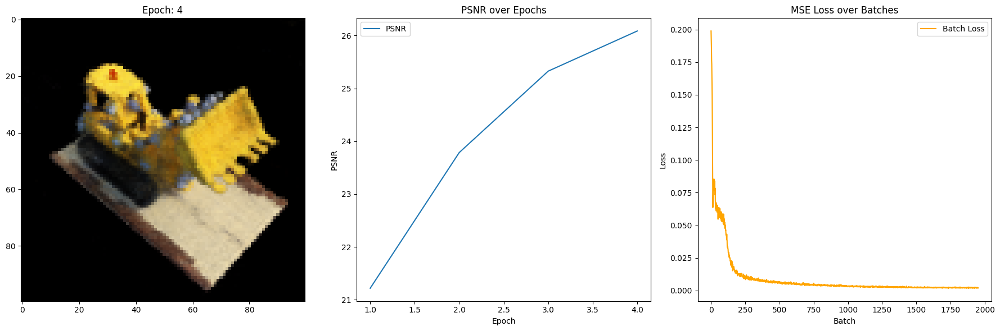

100%|██████████| 488/488 [00:12<00:00, 37.91it/s]


PSNR score=tensor([26.3753])
Average loss per epoch = 0.0018953948420544963


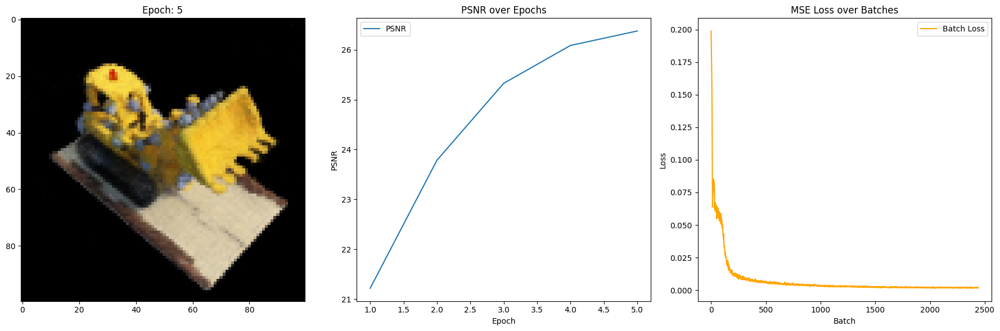

100%|██████████| 488/488 [00:12<00:00, 38.00it/s]


PSNR score=tensor([26.1908])
Average loss per epoch = 0.0017204167212542818


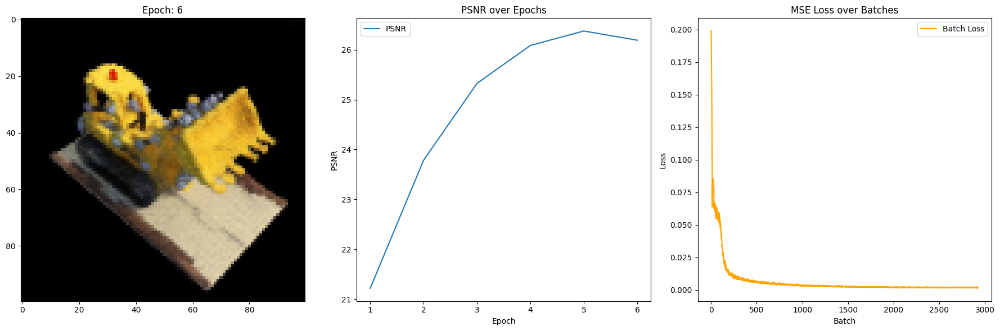

100%|██████████| 488/488 [00:12<00:00, 37.95it/s]


PSNR score=tensor([26.8345])
Average loss per epoch = 0.0015798037240499264


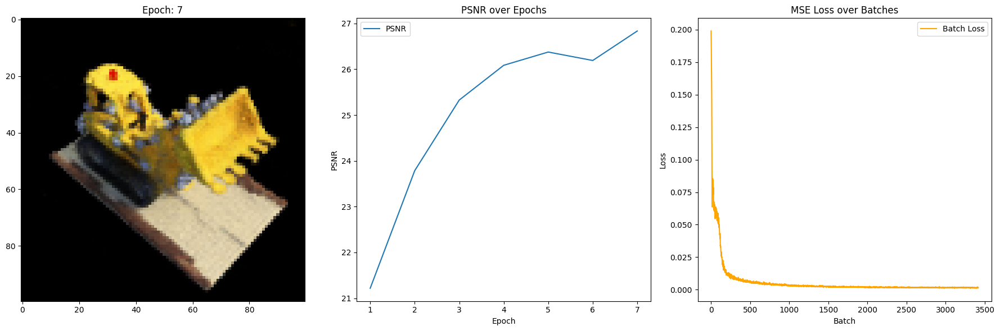

100%|██████████| 488/488 [00:12<00:00, 37.92it/s]


PSNR score=tensor([27.1192])
Average loss per epoch = 0.0014711645339733966


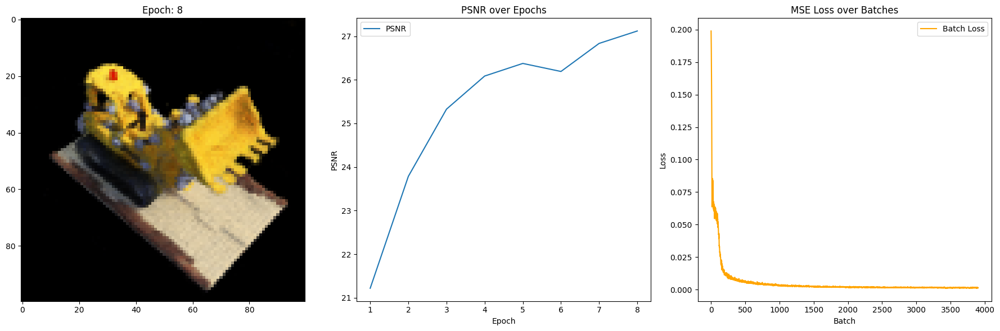

100%|██████████| 488/488 [00:12<00:00, 37.91it/s]


PSNR score=tensor([27.2563])
Average loss per epoch = 0.001378067955660985


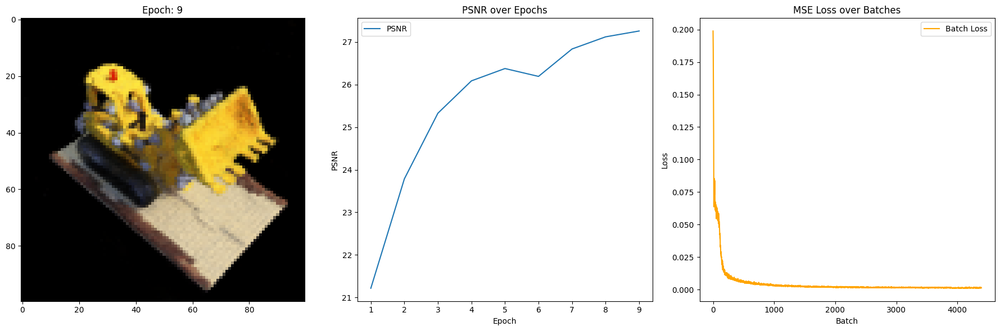

100%|██████████| 488/488 [00:12<00:00, 38.16it/s]


PSNR score=tensor([27.3604])
Average loss per epoch = 0.0012979884707076917


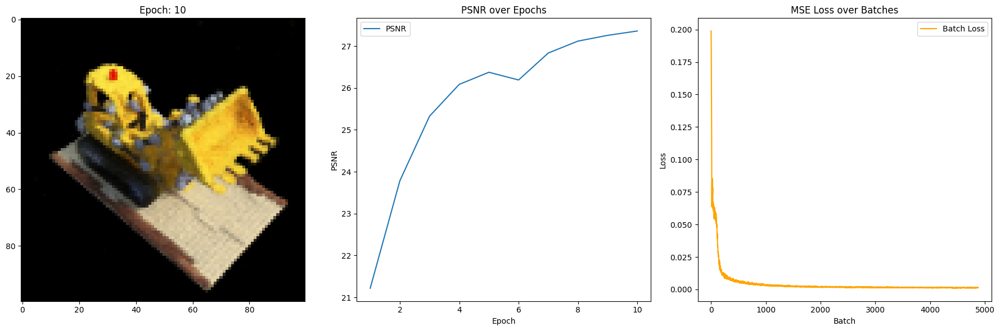

100%|██████████| 488/488 [00:12<00:00, 37.92it/s]


PSNR score=tensor([27.7591])
Average loss per epoch = 0.001231460819296638


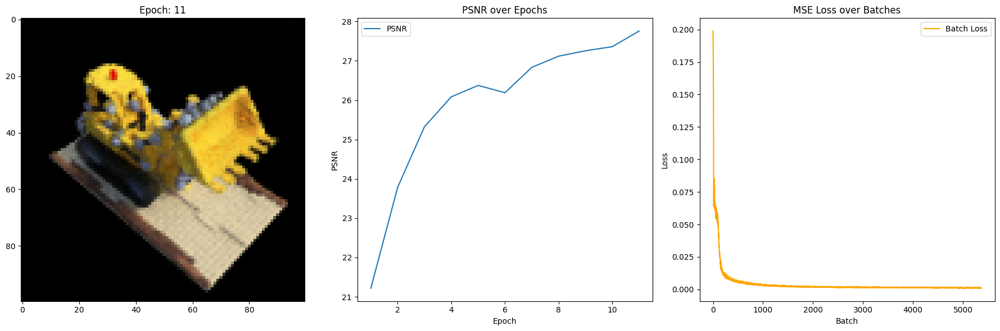

100%|██████████| 488/488 [00:12<00:00, 37.80it/s]


PSNR score=tensor([27.8004])
Average loss per epoch = 0.0011673730754648472


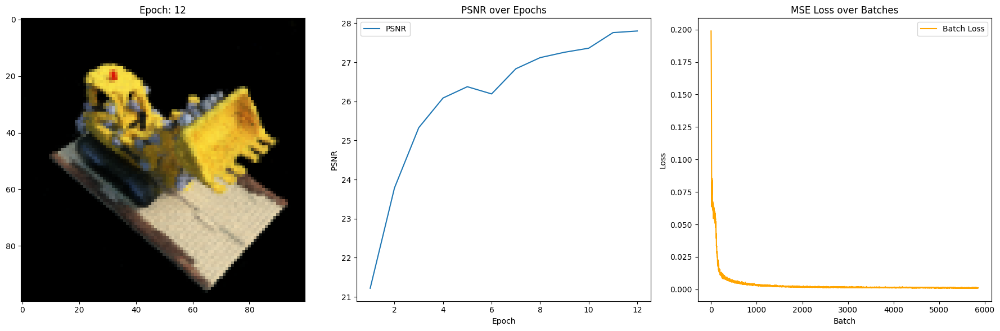

100%|██████████| 488/488 [00:12<00:00, 37.71it/s]


PSNR score=tensor([27.9364])
Average loss per epoch = 0.001116866694947468


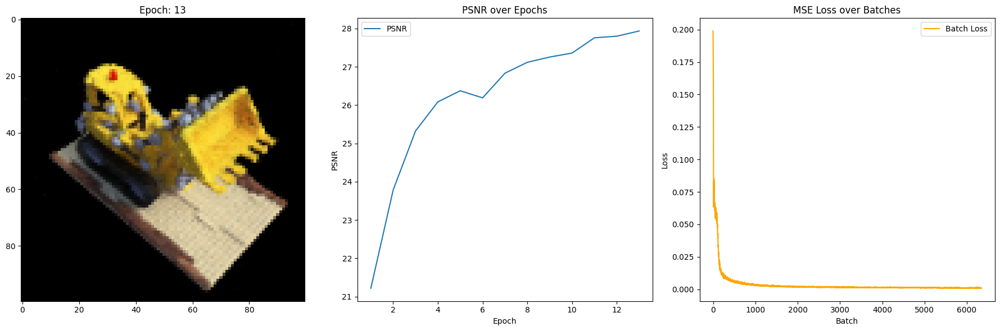

100%|██████████| 488/488 [00:12<00:00, 37.87it/s]


PSNR score=tensor([28.0914])
Average loss per epoch = 0.0010742285372603486


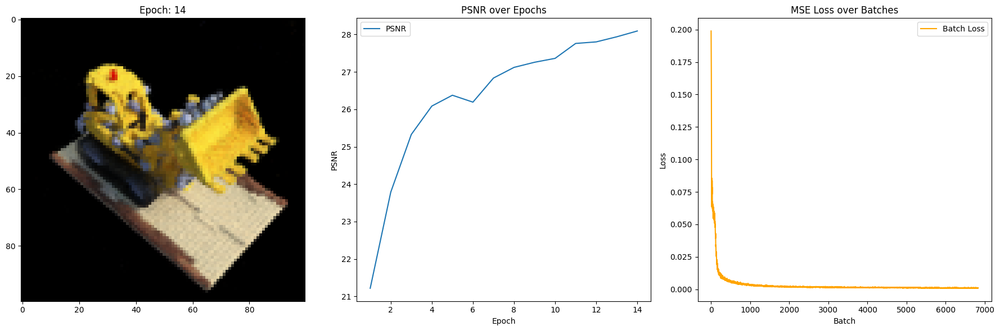

100%|██████████| 488/488 [00:12<00:00, 37.96it/s]


PSNR score=tensor([28.1647])
Average loss per epoch = 0.0010322496165200824


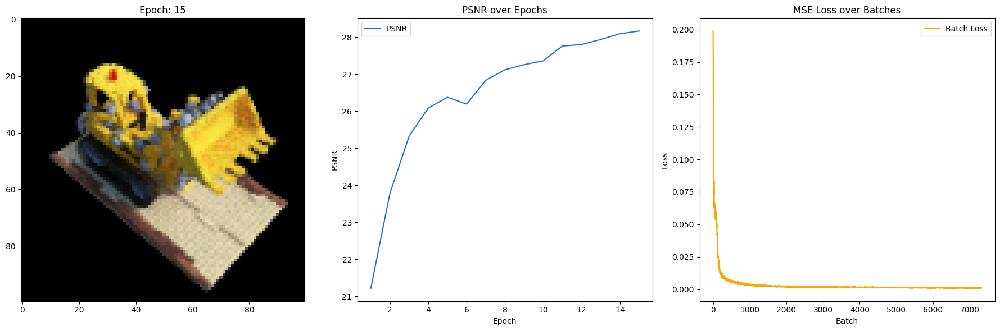

100%|██████████| 488/488 [00:12<00:00, 37.96it/s]


PSNR score=tensor([28.2785])
Average loss per epoch = 0.000993451199467584


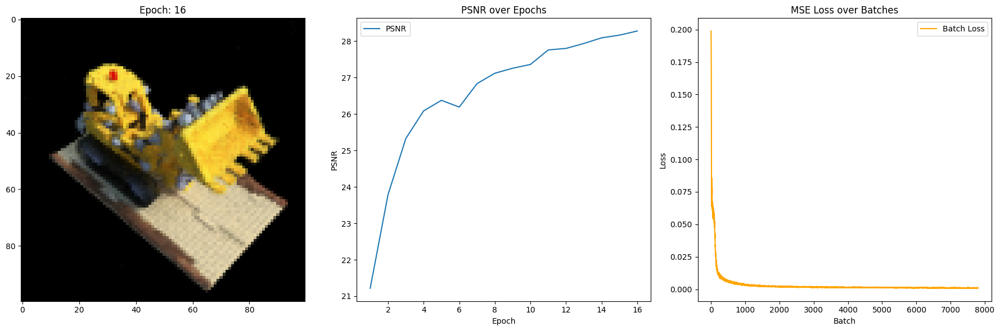

100%|██████████| 488/488 [00:12<00:00, 37.96it/s]


PSNR score=tensor([28.4123])
Average loss per epoch = 0.0009422260708725232


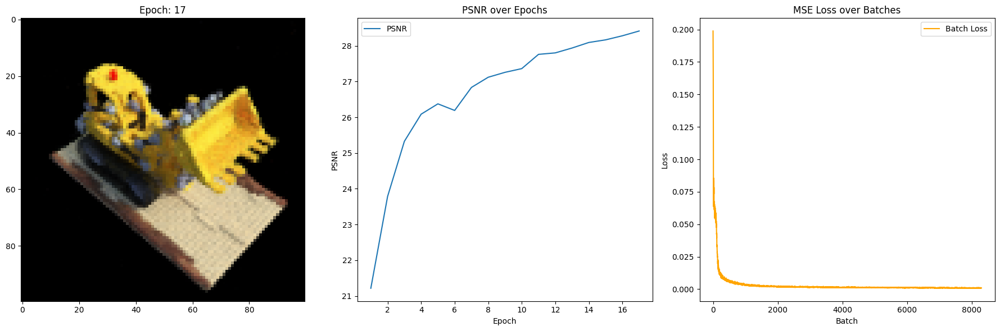

100%|██████████| 488/488 [00:12<00:00, 37.87it/s]


PSNR score=tensor([28.6926])
Average loss per epoch = 0.0009191801058716278


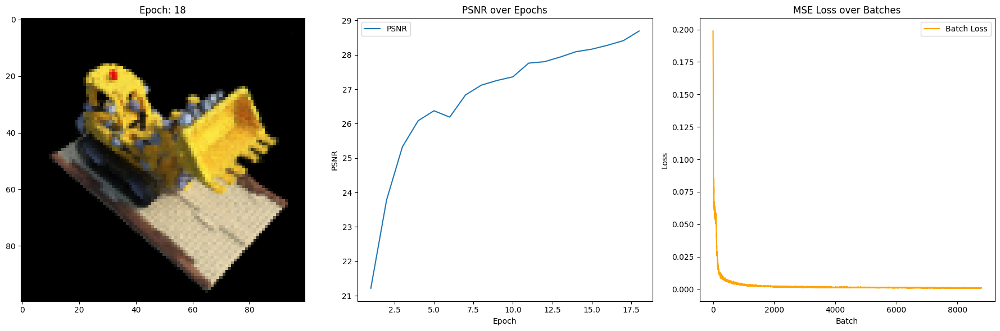

100%|██████████| 488/488 [00:12<00:00, 37.82it/s]


PSNR score=tensor([28.4307])
Average loss per epoch = 0.0008810271198153267


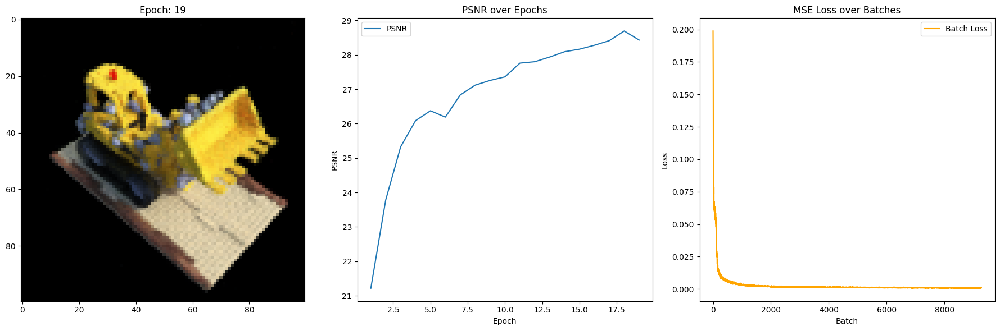

100%|██████████| 488/488 [00:12<00:00, 37.85it/s]


PSNR score=tensor([28.6040])
Average loss per epoch = 0.0008584942168185915


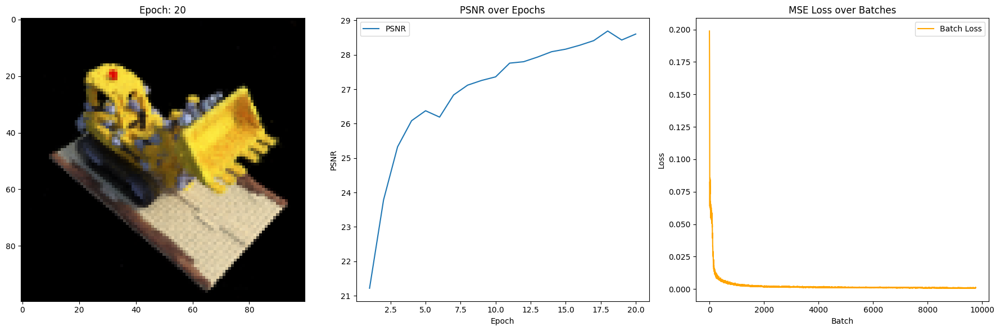

100%|██████████| 488/488 [00:12<00:00, 37.94it/s]


PSNR score=tensor([29.0178])
Average loss per epoch = 0.0010546636482611008


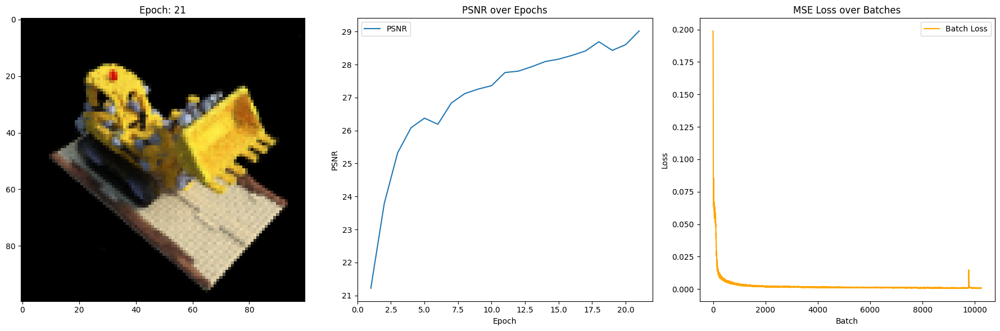

100%|██████████| 488/488 [00:12<00:00, 37.95it/s]


PSNR score=tensor([28.8656])
Average loss per epoch = 0.0007917732971273821


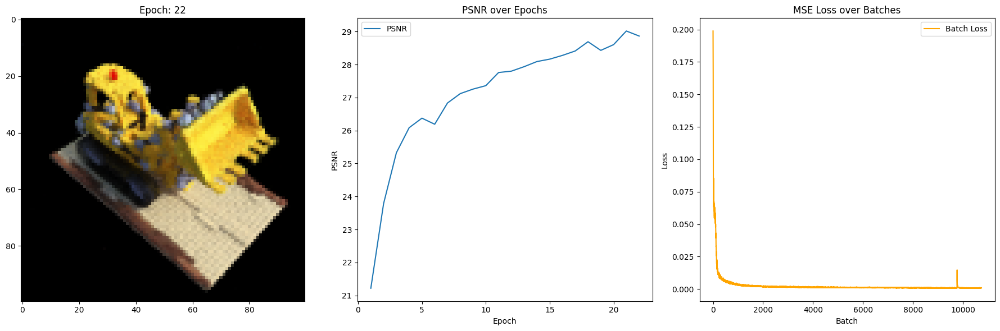

100%|██████████| 488/488 [00:12<00:00, 37.93it/s]


PSNR score=tensor([29.0367])
Average loss per epoch = 0.0007788137979824554


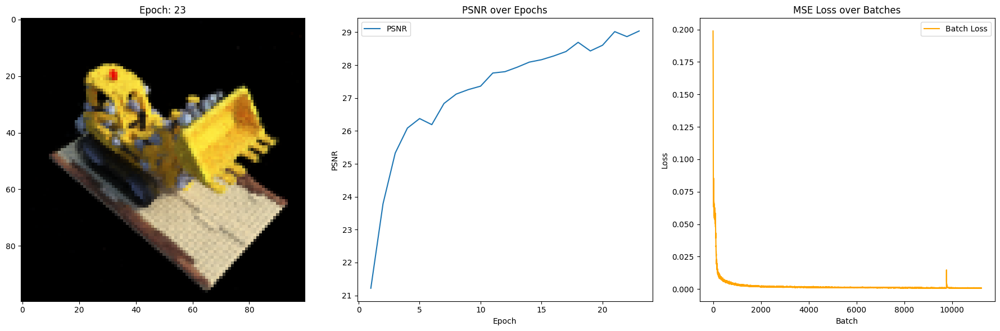

100%|██████████| 488/488 [00:12<00:00, 37.94it/s]


PSNR score=tensor([28.8315])
Average loss per epoch = 0.0007487588320414108


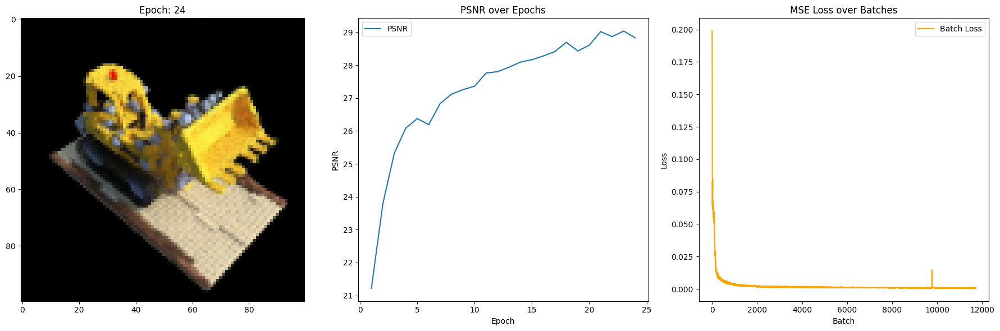

100%|██████████| 488/488 [00:12<00:00, 37.94it/s]


PSNR score=tensor([29.1509])
Average loss per epoch = 0.0007331345687652786


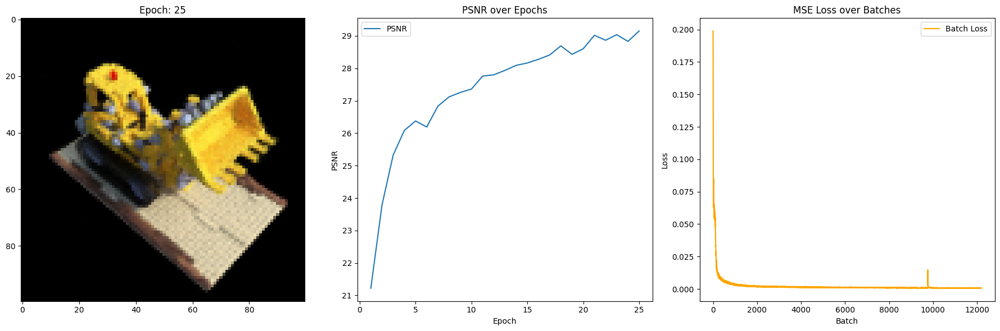

100%|██████████| 488/488 [00:12<00:00, 37.96it/s]


PSNR score=tensor([29.0108])
Average loss per epoch = 0.0007253819424134191


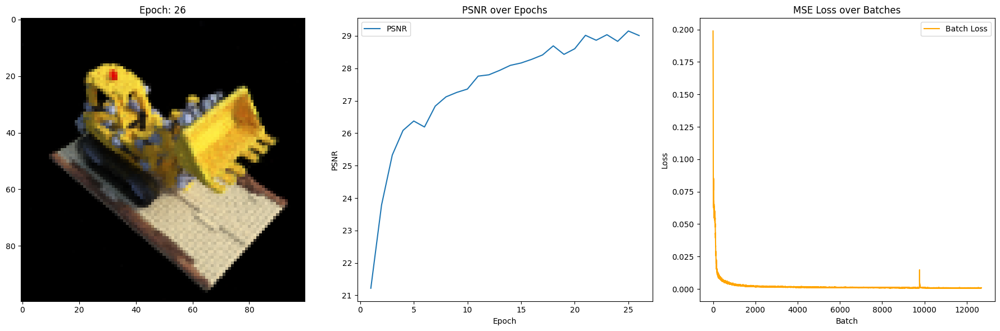

100%|██████████| 488/488 [00:12<00:00, 37.97it/s]


PSNR score=tensor([29.1241])
Average loss per epoch = 0.0007039867792389218


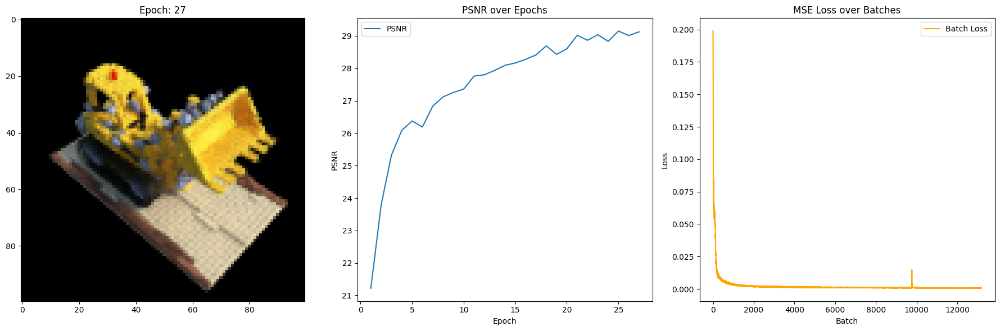

100%|██████████| 488/488 [00:12<00:00, 37.97it/s]


PSNR score=tensor([28.7777])
Average loss per epoch = 0.0006815301012018788


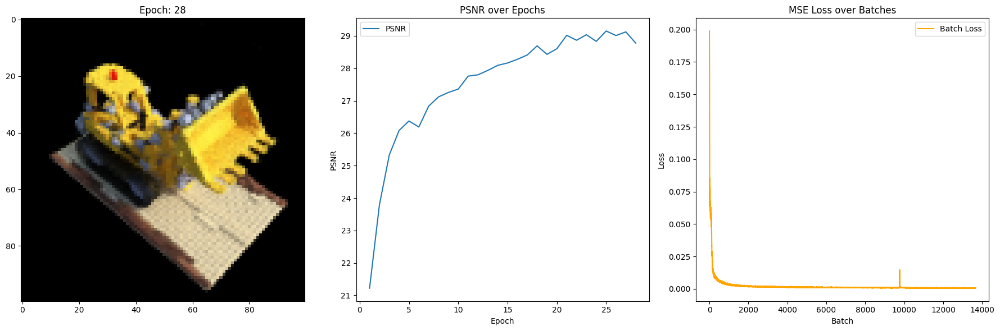

100%|██████████| 488/488 [00:12<00:00, 37.97it/s]


PSNR score=tensor([29.3499])
Average loss per epoch = 0.0006716612282258718


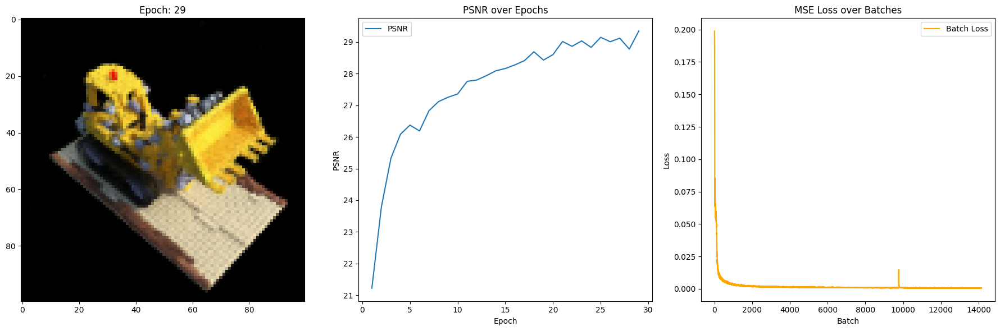

100%|██████████| 488/488 [00:12<00:00, 37.97it/s]


PSNR score=tensor([29.5270])
Average loss per epoch = 0.0006488768249553567


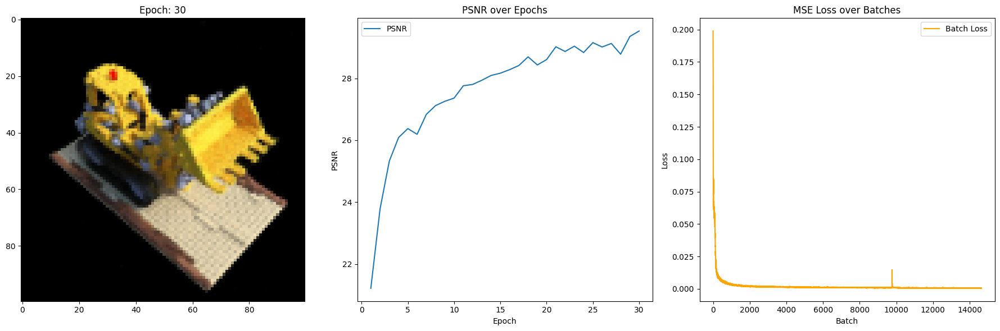

100%|██████████| 488/488 [00:12<00:00, 37.96it/s]


PSNR score=tensor([29.2900])
Average loss per epoch = 0.0006318033935757903


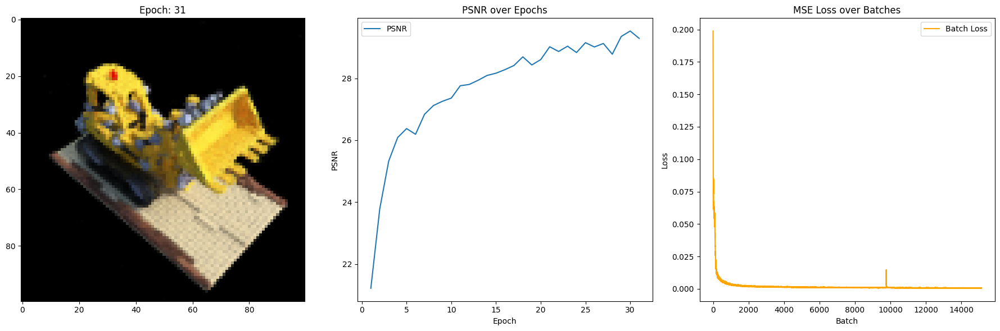

100%|██████████| 488/488 [00:12<00:00, 37.96it/s]


PSNR score=tensor([29.3352])
Average loss per epoch = 0.0006183291524558015


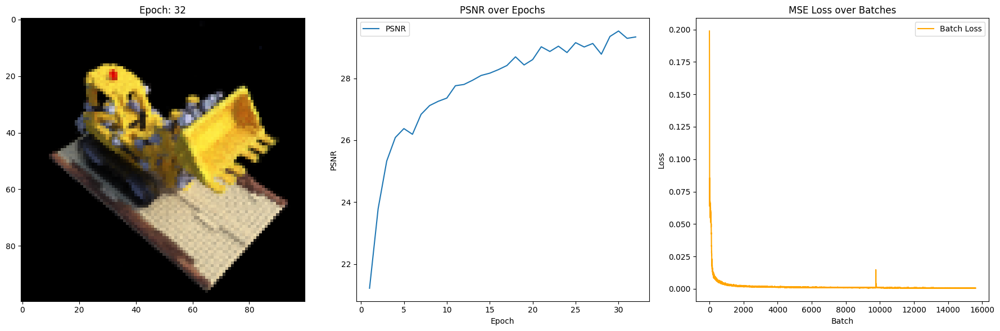

100%|██████████| 488/488 [00:12<00:00, 37.85it/s]


PSNR score=tensor([29.5518])
Average loss per epoch = 0.0006023084552892766


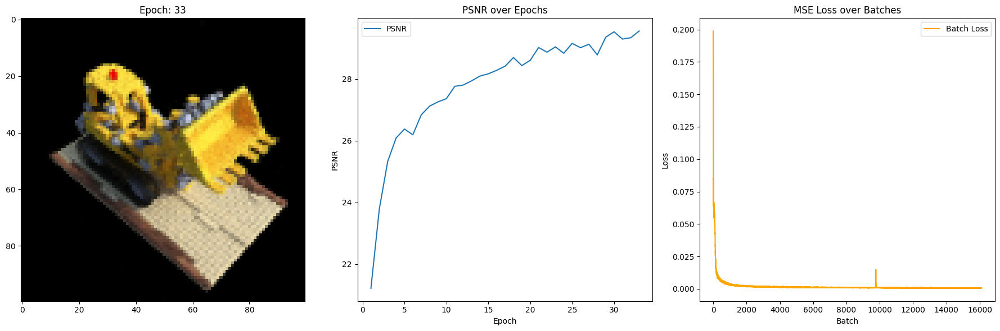

100%|██████████| 488/488 [00:12<00:00, 37.75it/s]


PSNR score=tensor([29.4952])
Average loss per epoch = 0.000586557959038936


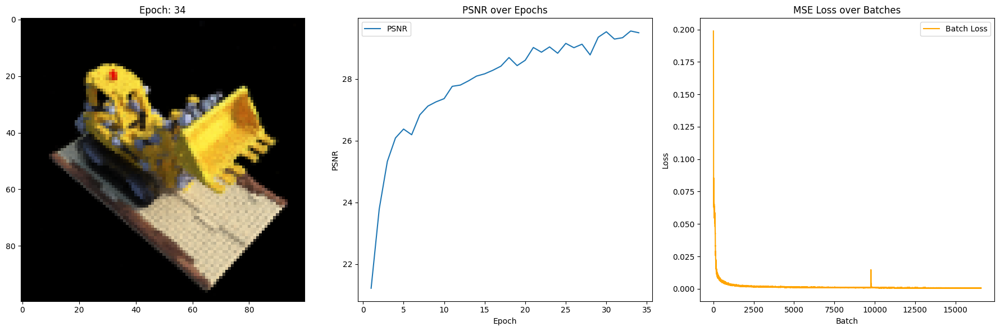

100%|██████████| 488/488 [00:12<00:00, 37.70it/s]


PSNR score=tensor([29.4740])
Average loss per epoch = 0.0005729337022248579


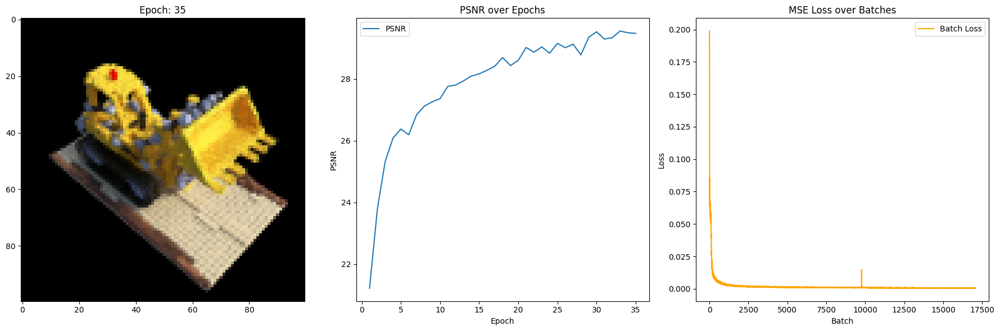

100%|██████████| 488/488 [00:12<00:00, 37.80it/s]


PSNR score=tensor([29.4815])
Average loss per epoch = 0.0005638300220302657


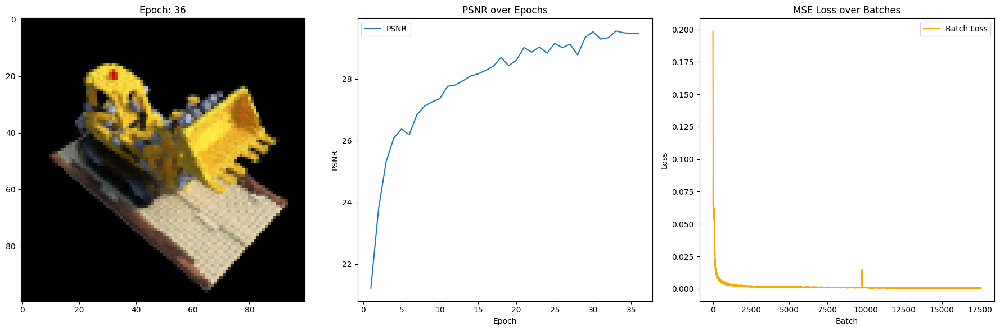

100%|██████████| 488/488 [00:12<00:00, 38.01it/s]


PSNR score=tensor([29.4467])
Average loss per epoch = 0.0005437956566370825


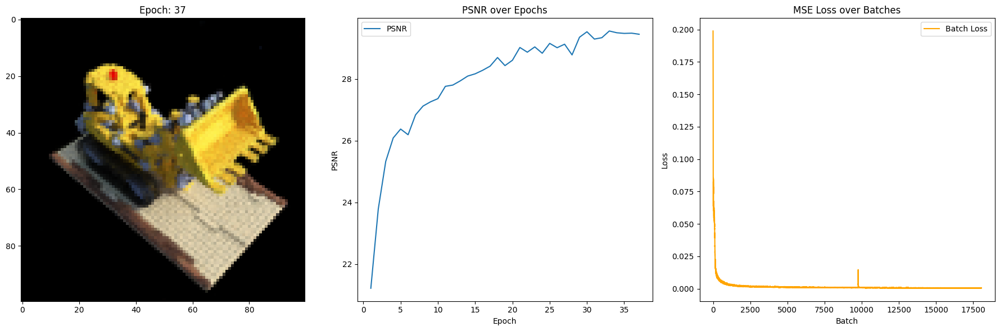

100%|██████████| 488/488 [00:12<00:00, 37.82it/s]


PSNR score=tensor([29.5995])
Average loss per epoch = 0.0005331100031473963


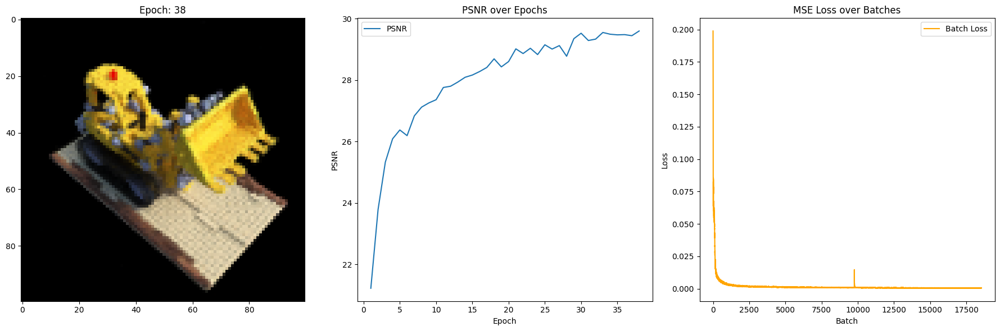

100%|██████████| 488/488 [00:12<00:00, 38.02it/s]


PSNR score=tensor([29.6048])
Average loss per epoch = 0.0005143136626966374


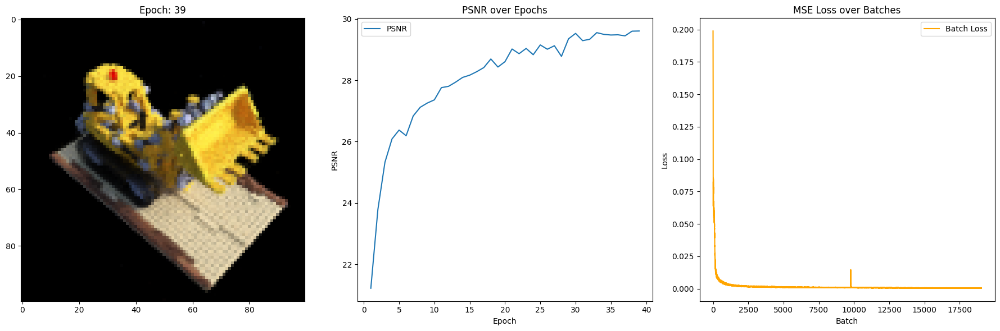

100%|██████████| 488/488 [00:12<00:00, 37.99it/s]


PSNR score=tensor([29.4623])
Average loss per epoch = 0.0005138464645720202


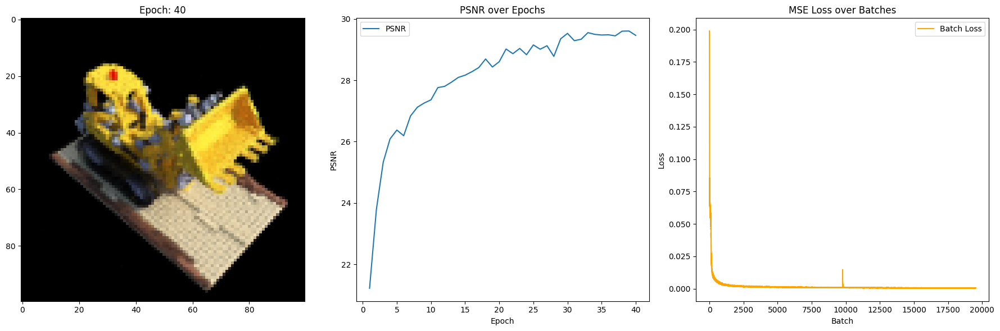

100%|██████████| 488/488 [00:12<00:00, 37.83it/s]


PSNR score=tensor([29.5615])
Average loss per epoch = 0.0004967561458141093


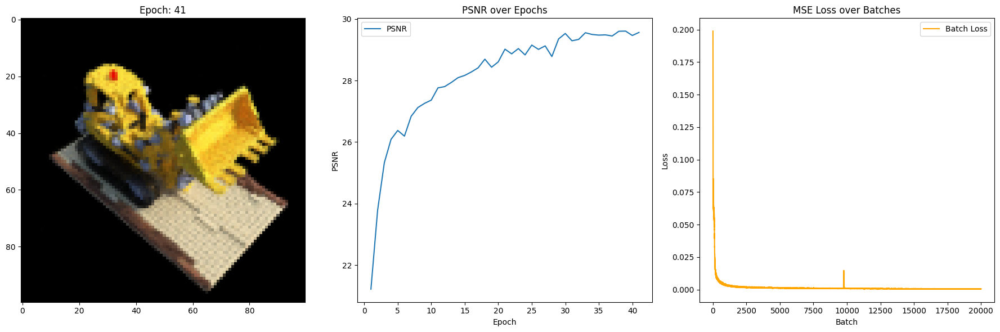

100%|██████████| 488/488 [00:12<00:00, 38.08it/s]


PSNR score=tensor([29.8953])
Average loss per epoch = 0.0004855066742538093


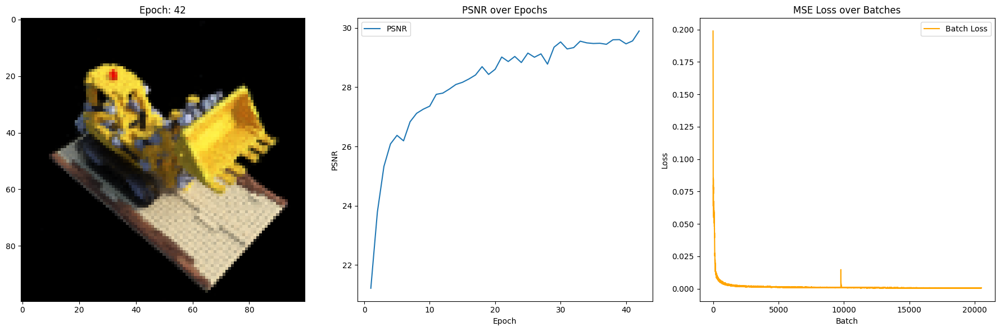

100%|██████████| 488/488 [00:12<00:00, 38.09it/s]


PSNR score=tensor([29.7256])
Average loss per epoch = 0.0004749947806513013


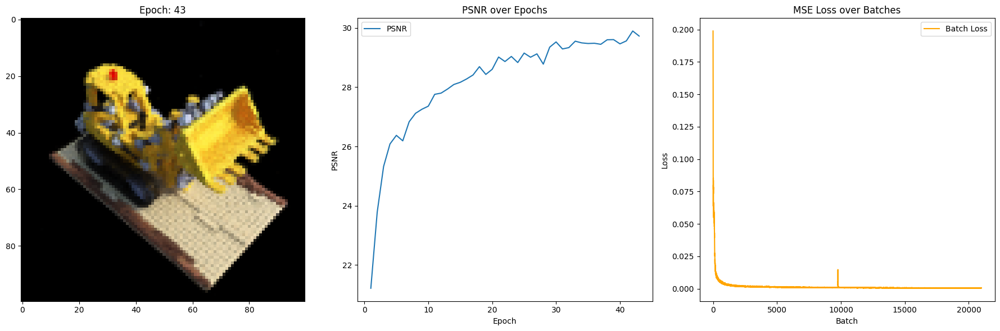

100%|██████████| 488/488 [00:12<00:00, 38.16it/s]


PSNR score=tensor([29.9793])
Average loss per epoch = 0.00045940448512365187


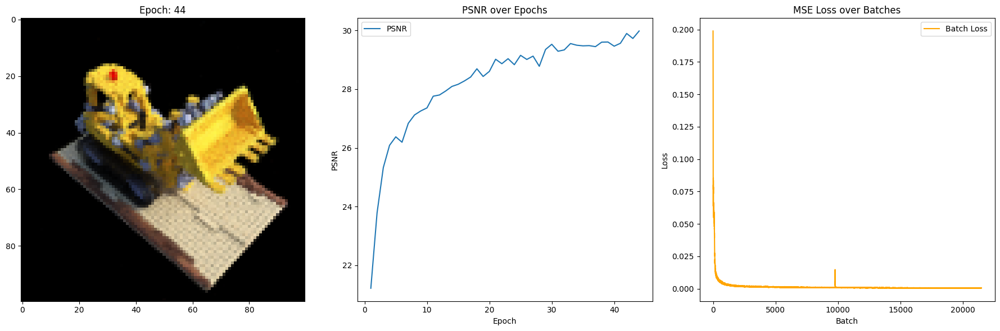

100%|██████████| 488/488 [00:12<00:00, 38.05it/s]


PSNR score=tensor([29.8702])
Average loss per epoch = 0.0004554080490483788


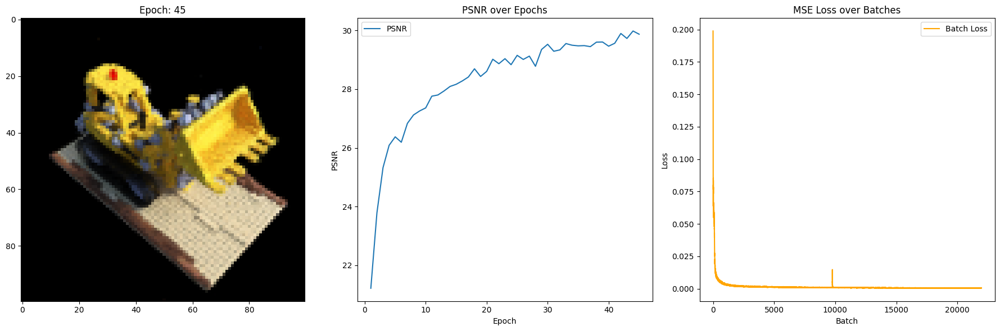

100%|██████████| 488/488 [00:12<00:00, 37.98it/s]


PSNR score=tensor([29.7202])
Average loss per epoch = 0.0004450814150436972


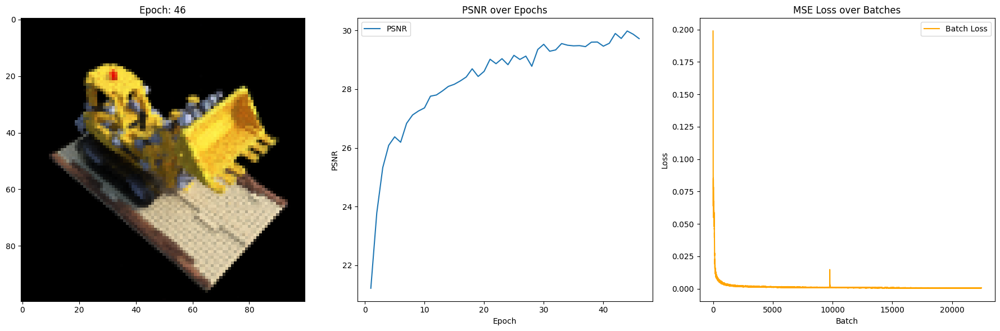

100%|██████████| 488/488 [00:12<00:00, 37.89it/s]


PSNR score=tensor([29.9136])
Average loss per epoch = 0.0004342973561357272


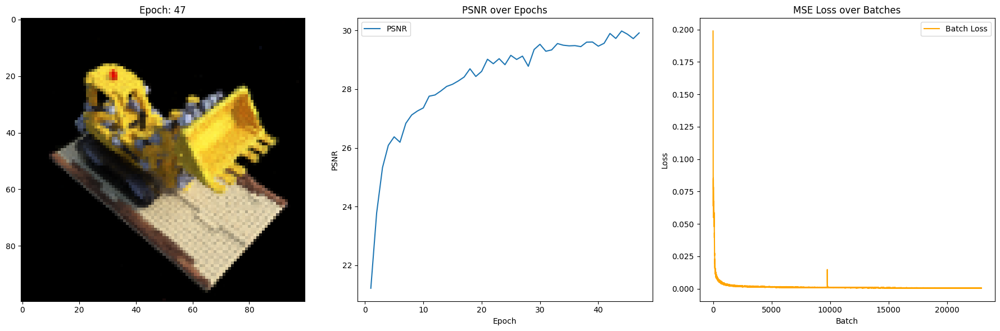

100%|██████████| 488/488 [00:12<00:00, 37.89it/s]


PSNR score=tensor([29.7587])
Average loss per epoch = 0.00041819135808733246


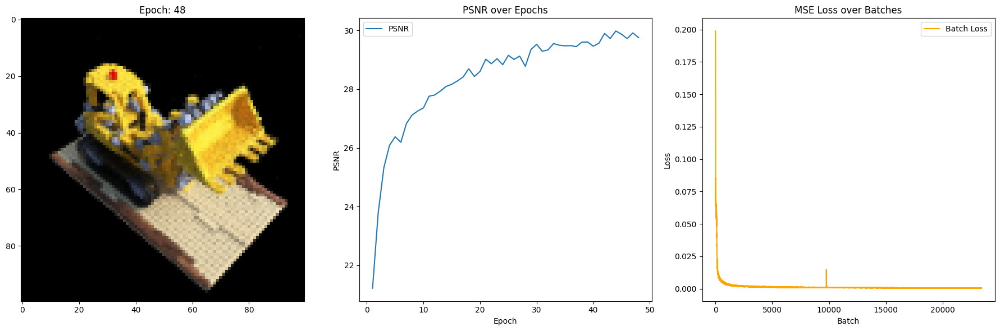

100%|██████████| 488/488 [00:12<00:00, 37.86it/s]


PSNR score=tensor([29.8664])
Average loss per epoch = 0.0004154479410928735


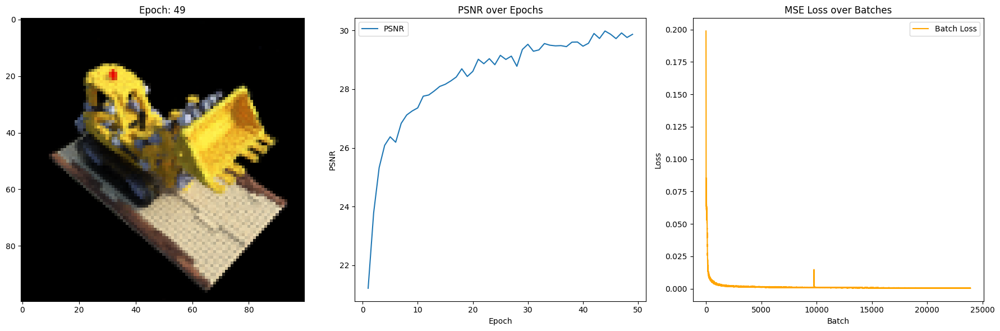

100%|██████████| 488/488 [00:12<00:00, 37.87it/s]


PSNR score=tensor([30.0599])
Average loss per epoch = 0.0004050163966656059


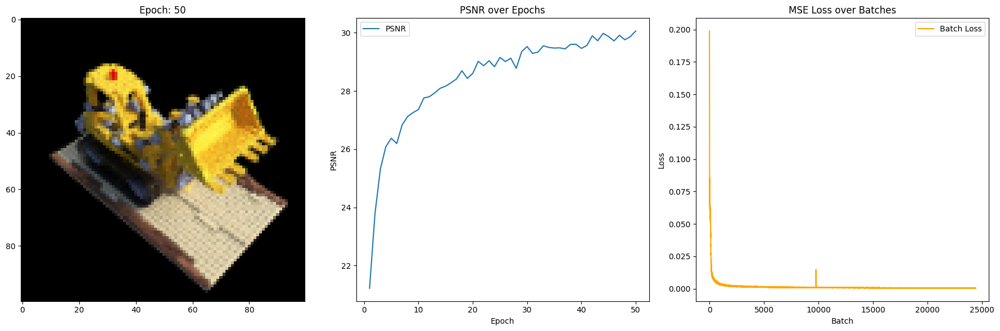

100%|██████████| 488/488 [00:12<00:00, 37.88it/s]


PSNR score=tensor([29.9722])
Average loss per epoch = 0.00040222742764391844


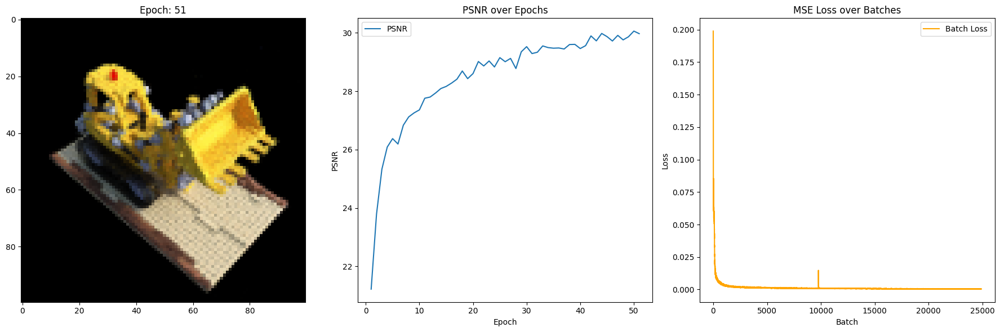

100%|██████████| 488/488 [00:12<00:00, 37.87it/s]


PSNR score=tensor([29.8729])
Average loss per epoch = 0.0003898436239143818


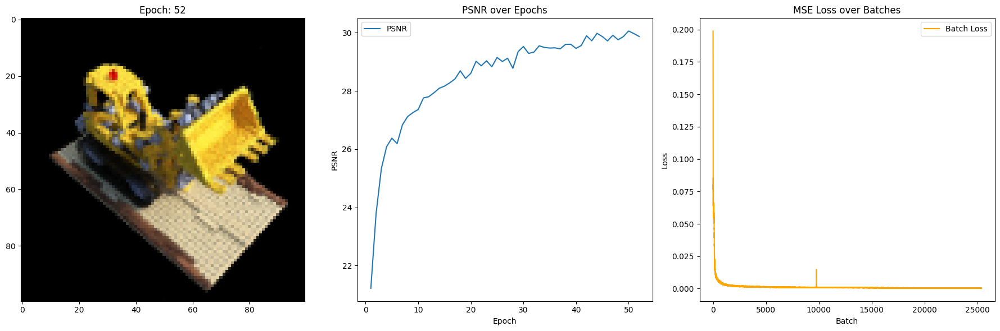

100%|██████████| 488/488 [00:12<00:00, 37.91it/s]


PSNR score=tensor([29.9143])
Average loss per epoch = 0.0003866264473128736


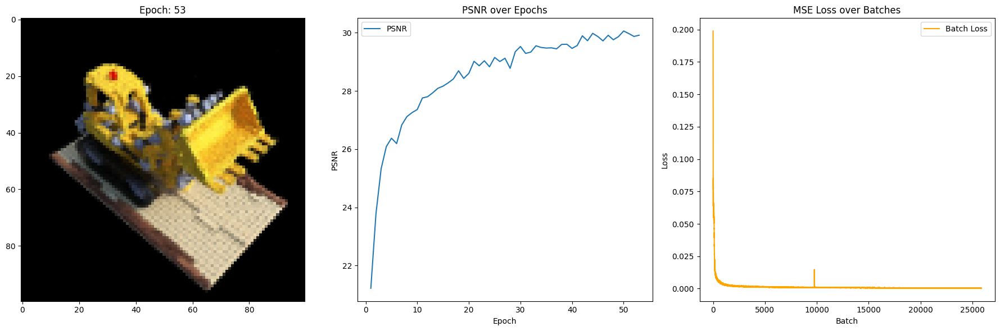

100%|██████████| 488/488 [00:12<00:00, 37.87it/s]


PSNR score=tensor([29.7880])
Average loss per epoch = 0.0003790133063167097


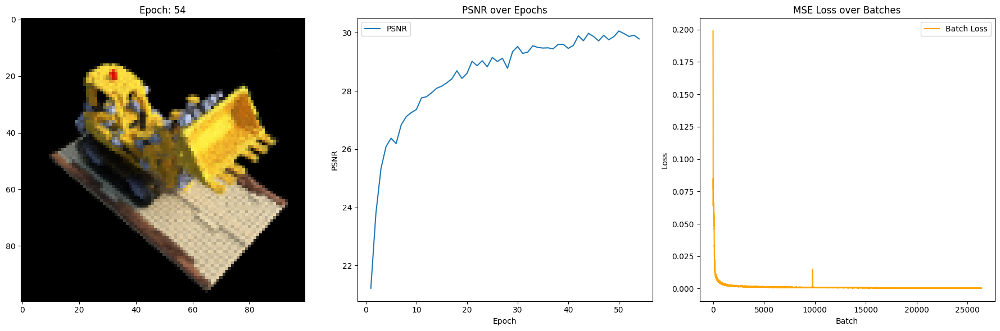

100%|██████████| 488/488 [00:12<00:00, 37.91it/s]


PSNR score=tensor([30.2797])
Average loss per epoch = 0.00036605560987974046


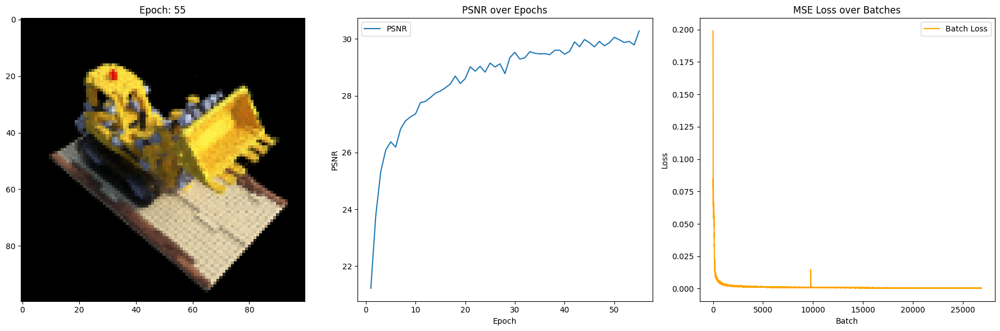

100%|██████████| 488/488 [00:12<00:00, 37.92it/s]


PSNR score=tensor([30.0345])
Average loss per epoch = 0.0003592502758752356


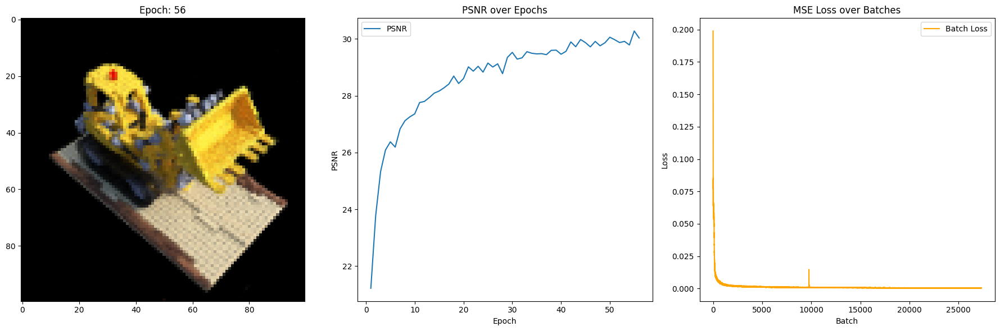

100%|██████████| 488/488 [00:12<00:00, 37.80it/s]


PSNR score=tensor([30.1031])
Average loss per epoch = 0.0003539265045651891


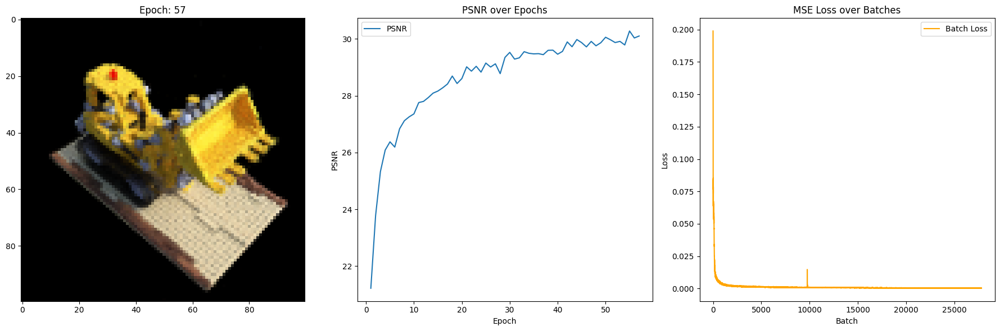

100%|██████████| 488/488 [00:12<00:00, 37.95it/s]


PSNR score=tensor([29.8357])
Average loss per epoch = 0.0003507038902588662


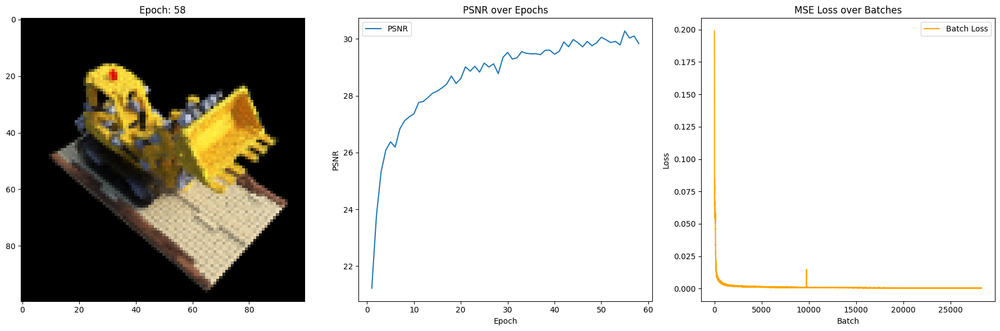

100%|██████████| 488/488 [00:12<00:00, 37.90it/s]


PSNR score=tensor([30.2242])
Average loss per epoch = 0.0003436607719359912


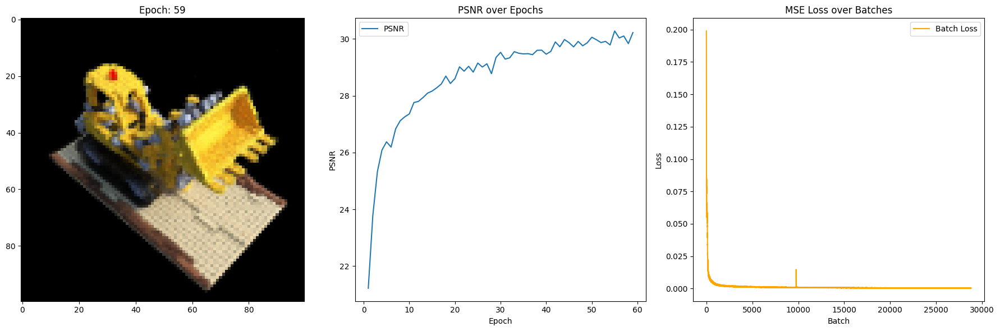

100%|██████████| 488/488 [00:12<00:00, 37.77it/s]


PSNR score=tensor([30.3125])
Average loss per epoch = 0.00033730092948898064


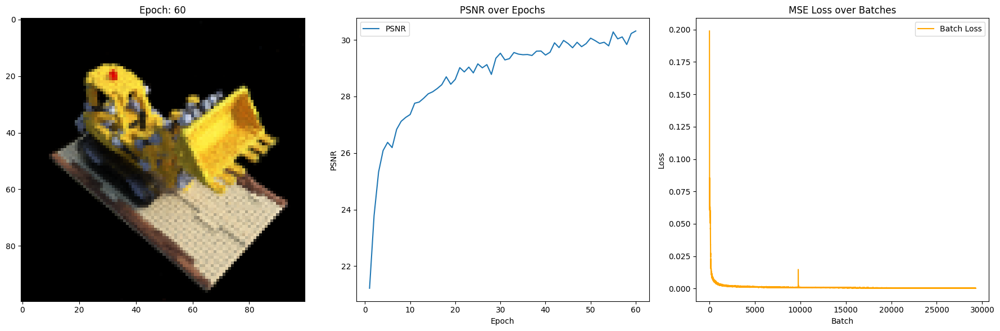

100%|██████████| 488/488 [00:12<00:00, 37.71it/s]


PSNR score=tensor([30.0572])
Average loss per epoch = 0.0003224515287419323


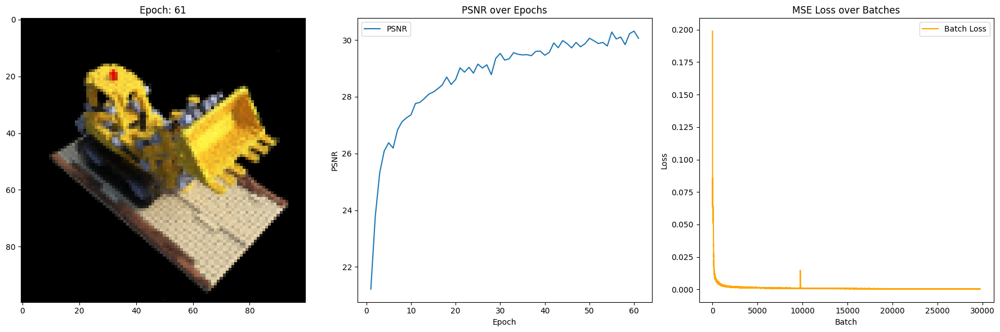

100%|██████████| 488/488 [00:12<00:00, 37.76it/s]


PSNR score=tensor([30.1412])
Average loss per epoch = 0.00032279771510759737


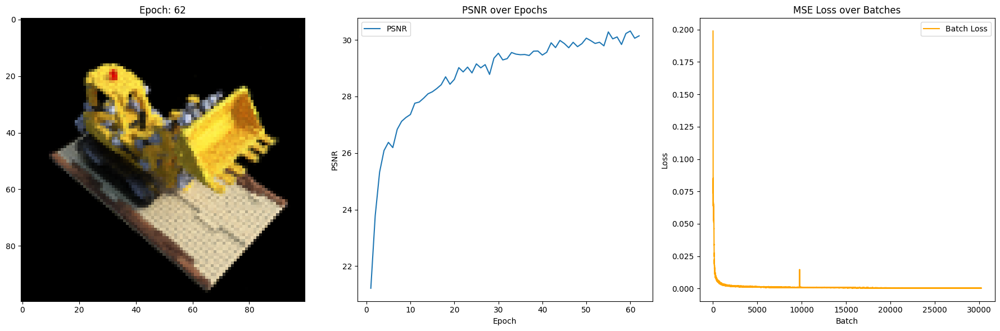

100%|██████████| 488/488 [00:12<00:00, 37.89it/s]


PSNR score=tensor([30.2001])
Average loss per epoch = 0.00031951240506729295


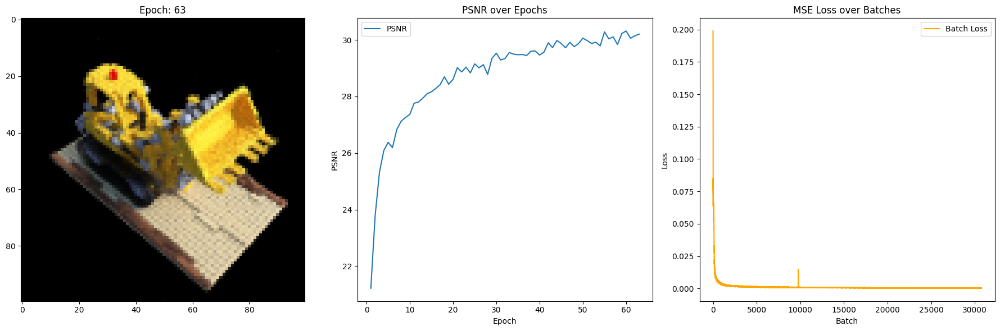

100%|██████████| 488/488 [00:12<00:00, 37.94it/s]


PSNR score=tensor([30.0668])
Average loss per epoch = 0.00030934496391607546


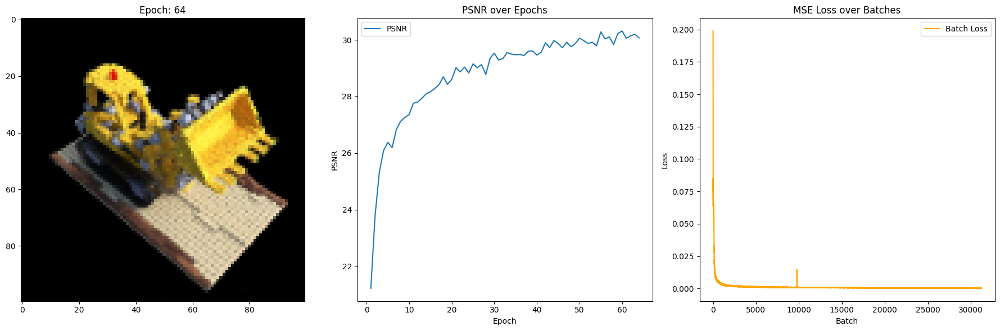

100%|██████████| 488/488 [00:12<00:00, 37.95it/s]


PSNR score=tensor([30.0855])
Average loss per epoch = 0.0003092731995656934


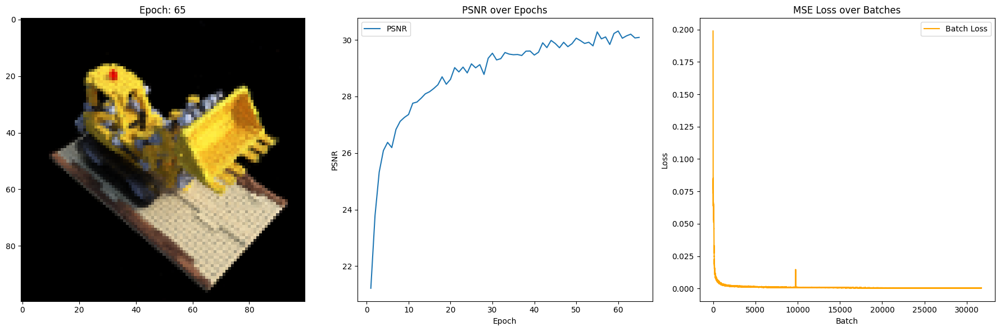

100%|██████████| 488/488 [00:12<00:00, 37.94it/s]


PSNR score=tensor([30.0220])
Average loss per epoch = 0.0003078597214358733


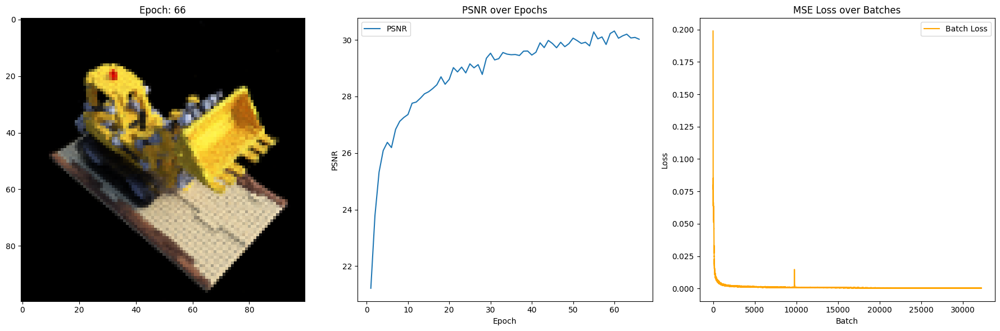

100%|██████████| 488/488 [00:12<00:00, 37.95it/s]


PSNR score=tensor([30.2214])
Average loss per epoch = 0.00029738859633593554


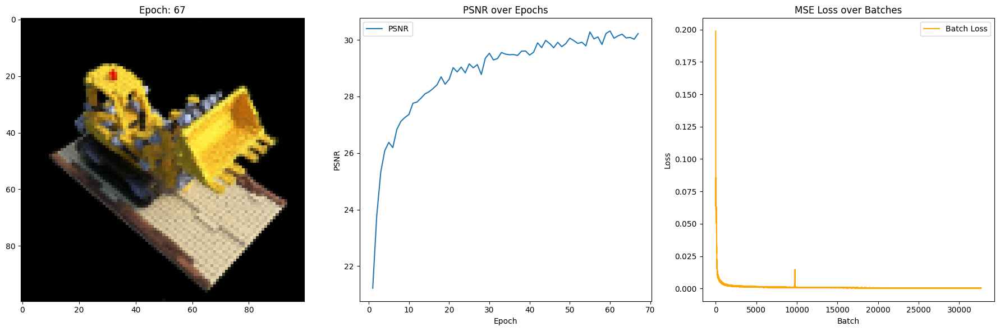

100%|██████████| 488/488 [00:12<00:00, 37.93it/s]


PSNR score=tensor([30.2790])
Average loss per epoch = 0.00028964456977832254


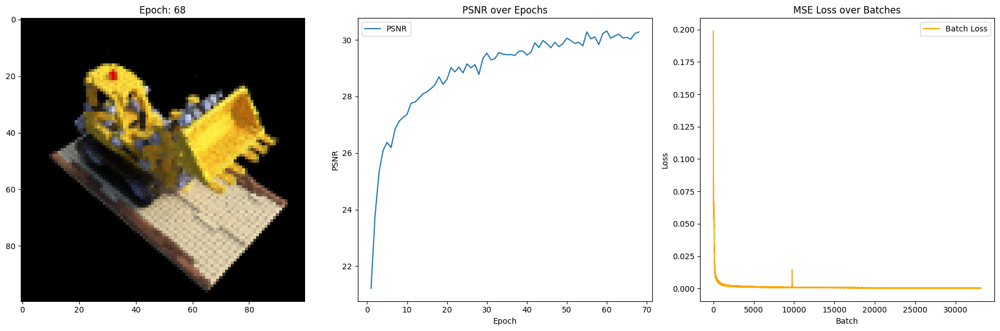

100%|██████████| 488/488 [00:12<00:00, 37.87it/s]


PSNR score=tensor([30.1645])
Average loss per epoch = 0.0002894508058981031


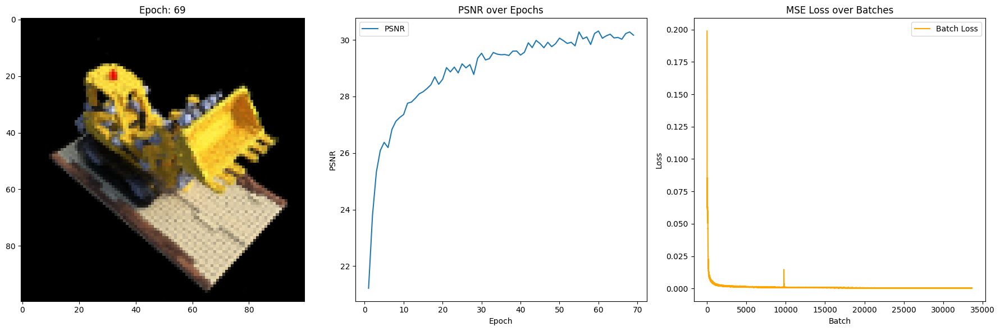

100%|██████████| 488/488 [00:12<00:00, 37.85it/s]


PSNR score=tensor([30.3014])
Average loss per epoch = 0.0002807185022097432


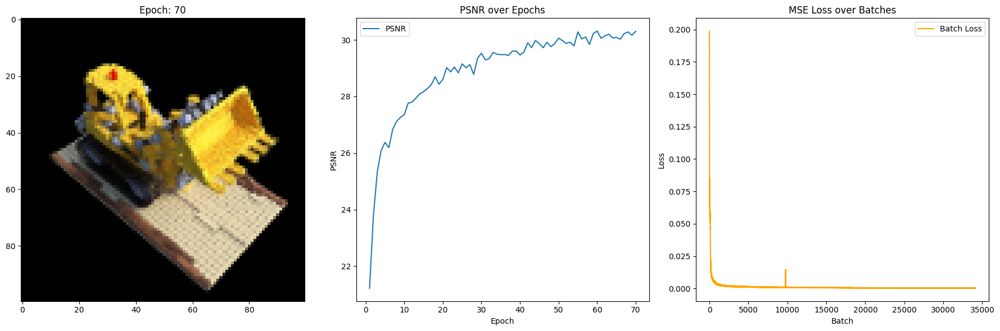

100%|██████████| 488/488 [00:12<00:00, 37.84it/s]


PSNR score=tensor([30.0019])
Average loss per epoch = 0.00028260170694890995


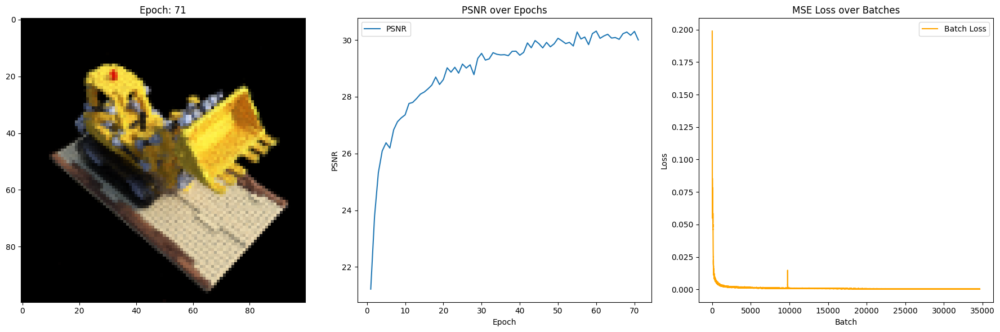

100%|██████████| 488/488 [00:12<00:00, 37.82it/s]


PSNR score=tensor([30.2264])
Average loss per epoch = 0.0002719270884926282


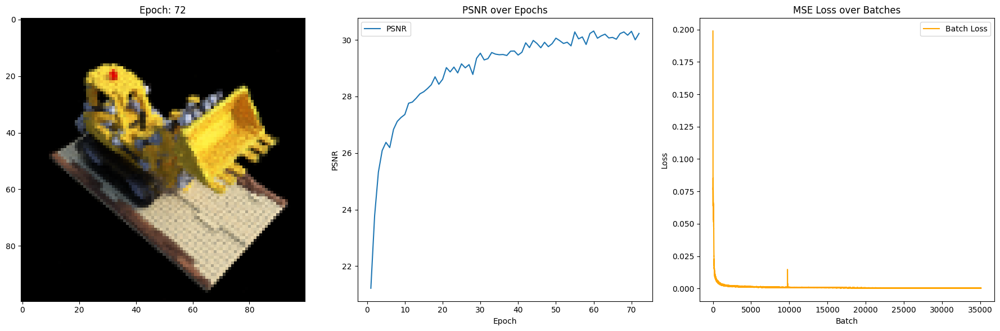

100%|██████████| 488/488 [00:12<00:00, 37.84it/s]


PSNR score=tensor([30.3878])
Average loss per epoch = 0.0002700389683371616


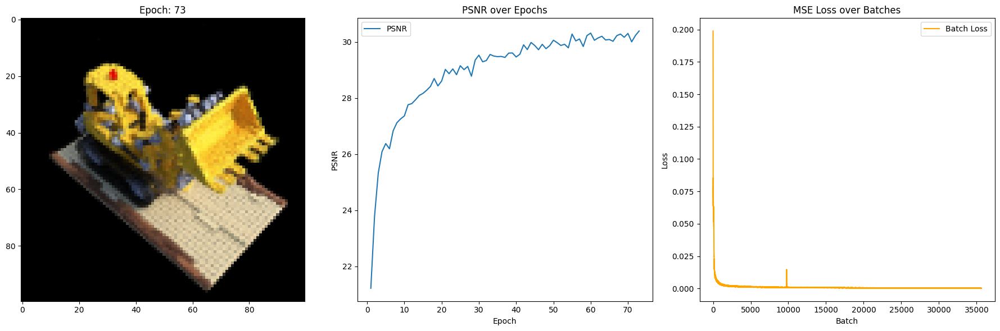

100%|██████████| 488/488 [00:12<00:00, 37.95it/s]


PSNR score=tensor([30.4016])
Average loss per epoch = 0.0002642740757854896


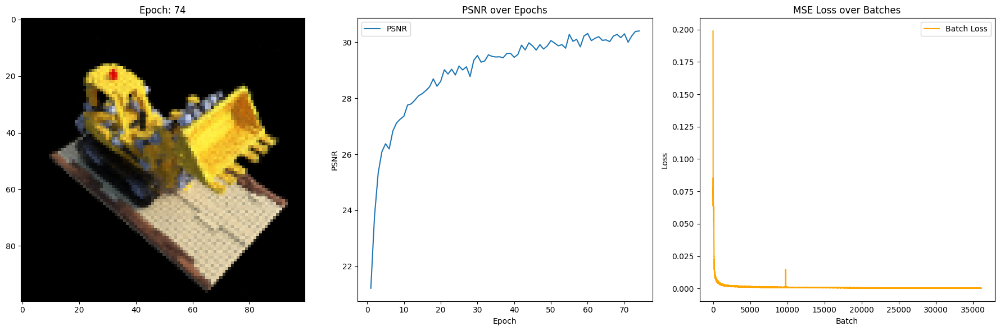

100%|██████████| 488/488 [00:12<00:00, 37.94it/s]


PSNR score=tensor([30.3645])
Average loss per epoch = 0.0002608899720770318


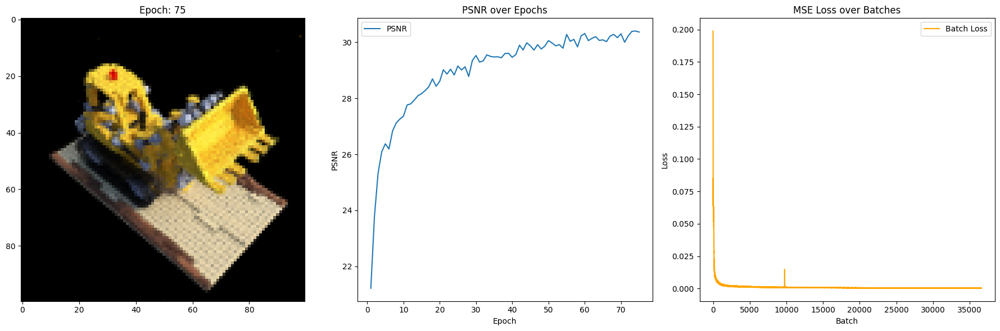

100%|██████████| 488/488 [00:12<00:00, 37.94it/s]


PSNR score=tensor([30.2088])
Average loss per epoch = 0.0002575857412071467


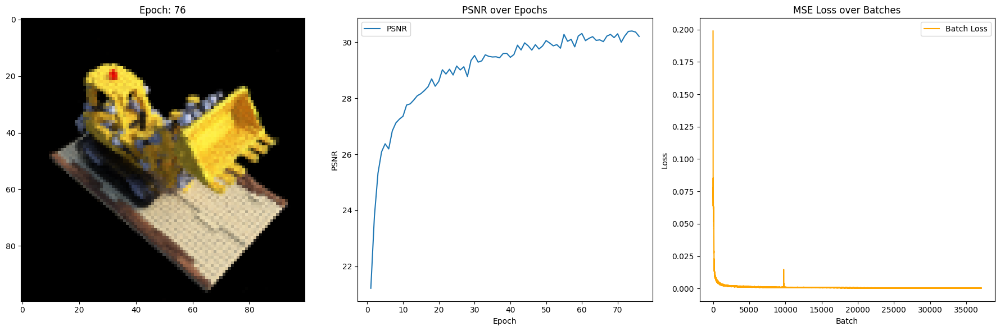

100%|██████████| 488/488 [00:12<00:00, 37.94it/s]


PSNR score=tensor([30.3527])
Average loss per epoch = 0.00025651470092330394


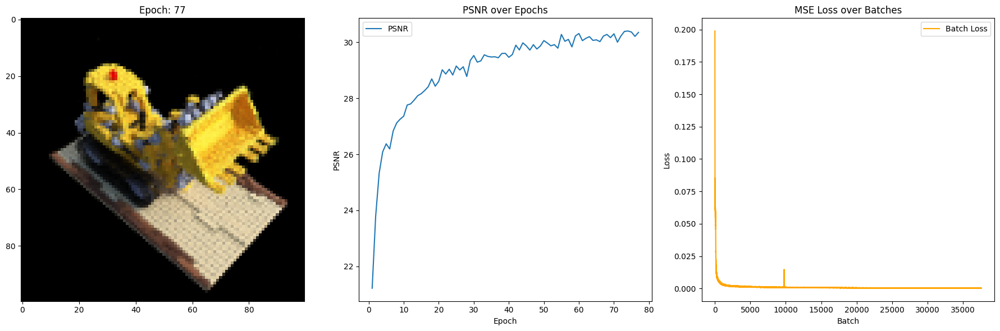

100%|██████████| 488/488 [00:12<00:00, 37.87it/s]


PSNR score=tensor([30.2762])
Average loss per epoch = 0.0002517651124644097


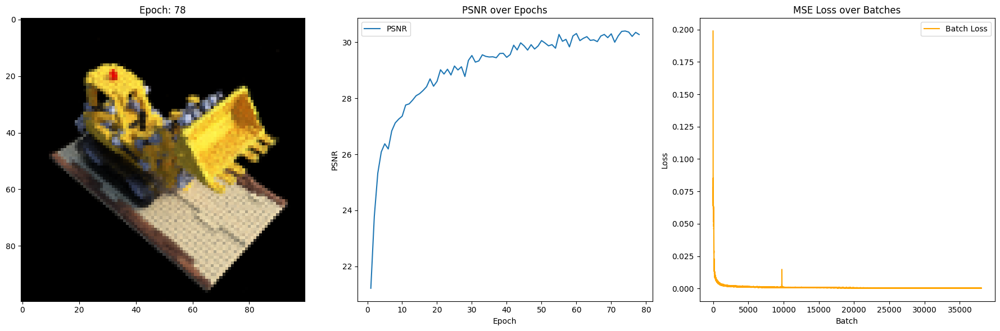

100%|██████████| 488/488 [00:12<00:00, 37.96it/s]


PSNR score=tensor([30.2421])
Average loss per epoch = 0.000250880553453424


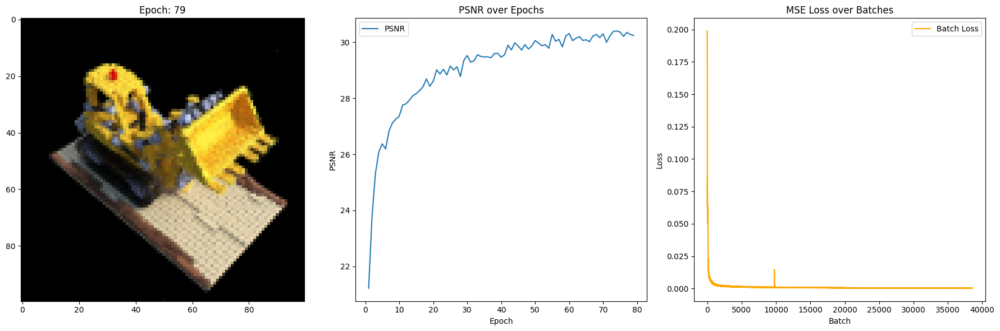

100%|██████████| 488/488 [00:12<00:00, 37.96it/s]


PSNR score=tensor([30.3048])
Average loss per epoch = 0.00024484998977611404


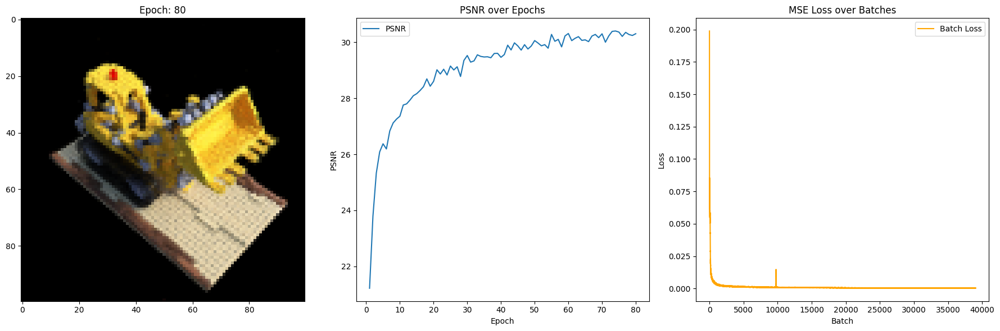

100%|██████████| 488/488 [00:12<00:00, 37.94it/s]


PSNR score=tensor([30.5100])
Average loss per epoch = 0.00024078947469996685


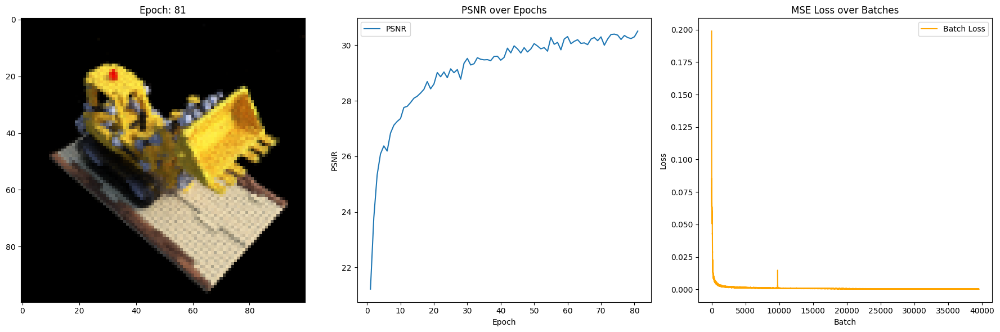

100%|██████████| 488/488 [00:12<00:00, 37.95it/s]


PSNR score=tensor([30.2369])
Average loss per epoch = 0.00023700532977675377


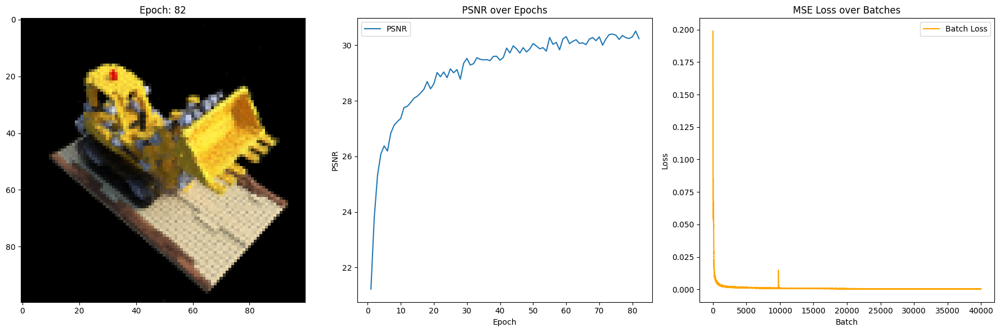

100%|██████████| 488/488 [00:12<00:00, 37.92it/s]


PSNR score=tensor([30.2133])
Average loss per epoch = 0.00023490907366723434


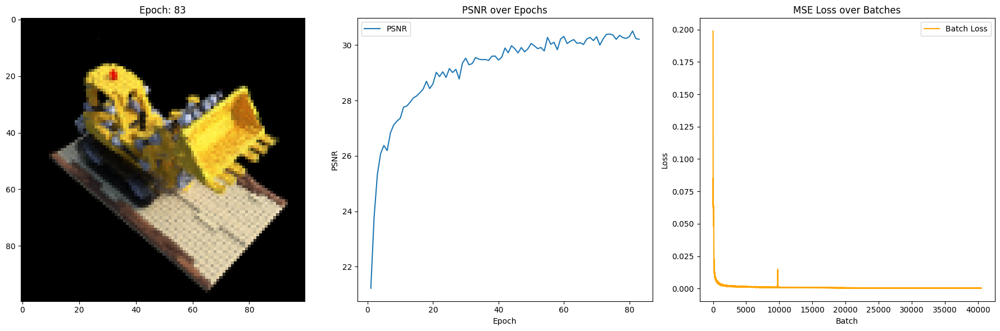

100%|██████████| 488/488 [00:12<00:00, 37.92it/s]


PSNR score=tensor([30.4292])
Average loss per epoch = 0.00023350451502650326


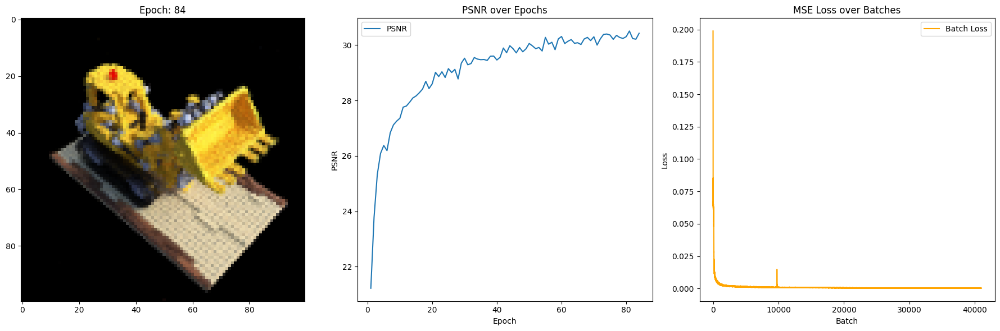

100%|██████████| 488/488 [00:12<00:00, 37.94it/s]


PSNR score=tensor([30.2161])
Average loss per epoch = 0.0002303869835292867


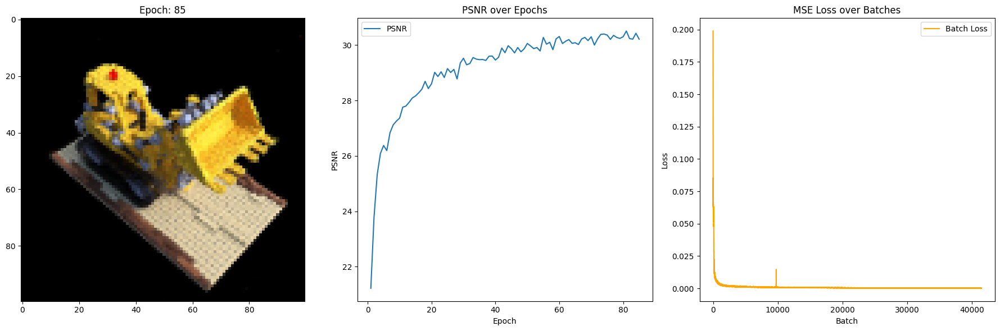

100%|██████████| 488/488 [00:12<00:00, 38.01it/s]


PSNR score=tensor([30.3847])
Average loss per epoch = 0.00022398139021863214


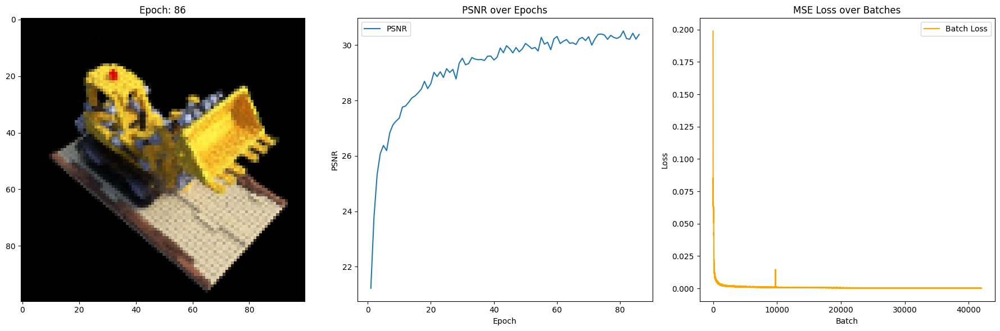

100%|██████████| 488/488 [00:12<00:00, 38.10it/s]


PSNR score=tensor([30.2625])
Average loss per epoch = 0.00022177827641364095


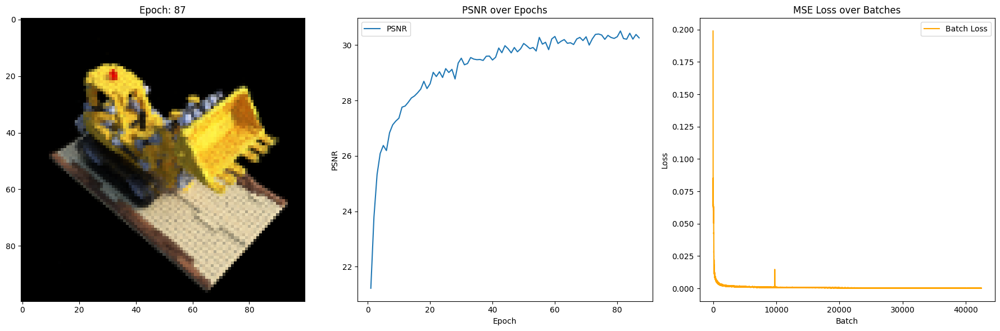

100%|██████████| 488/488 [00:12<00:00, 38.13it/s]


PSNR score=tensor([30.1465])
Average loss per epoch = 0.00021778142039037164


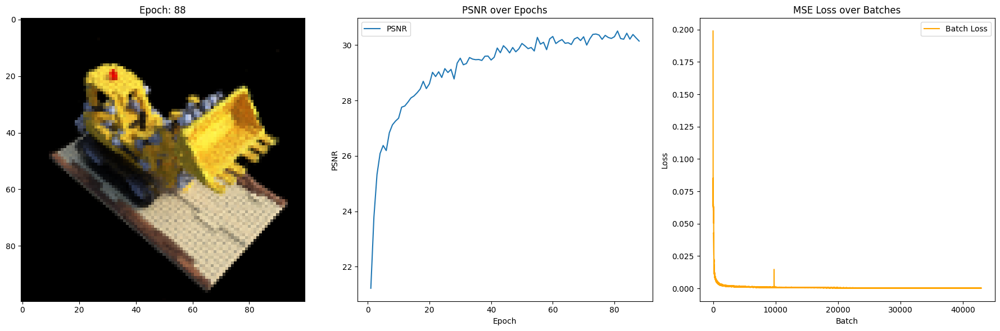

100%|██████████| 488/488 [00:12<00:00, 37.95it/s]


PSNR score=tensor([30.1404])
Average loss per epoch = 0.00021650580594246468


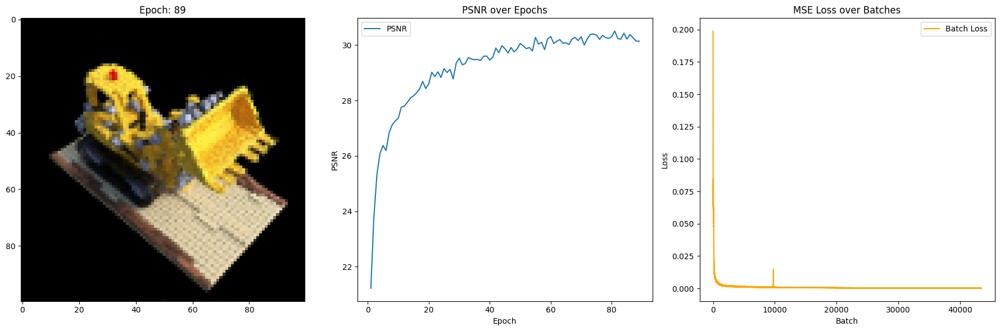

100%|██████████| 488/488 [00:12<00:00, 38.02it/s]


PSNR score=tensor([30.0892])
Average loss per epoch = 0.00021636842873584876


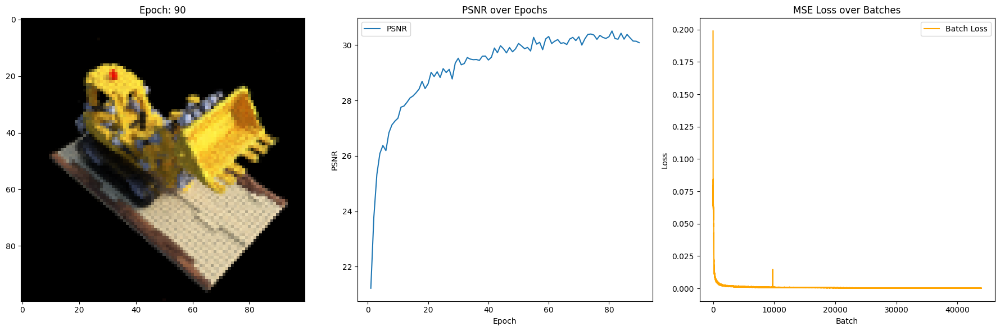

100%|██████████| 488/488 [00:12<00:00, 38.08it/s]


PSNR score=tensor([30.1901])
Average loss per epoch = 0.00021342562473871456


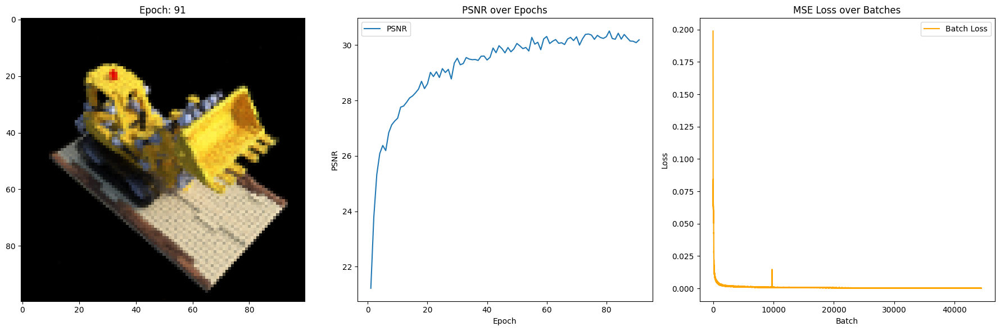

100%|██████████| 488/488 [00:12<00:00, 38.06it/s]


PSNR score=tensor([30.3532])
Average loss per epoch = 0.00021183149999801497


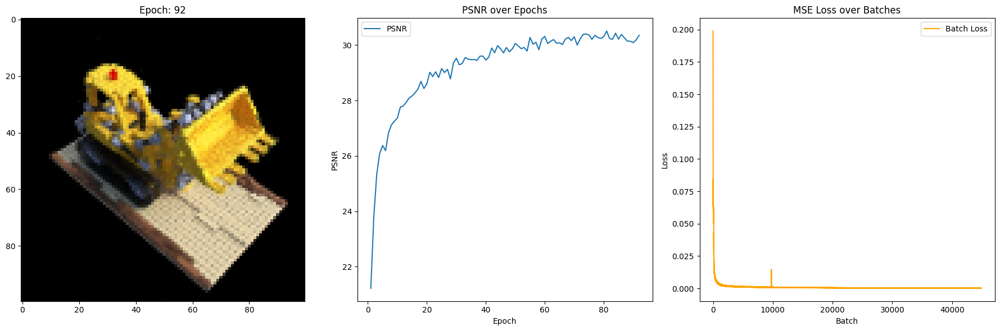

100%|██████████| 488/488 [00:12<00:00, 38.07it/s]


PSNR score=tensor([30.3251])
Average loss per epoch = 0.00020787021920292973


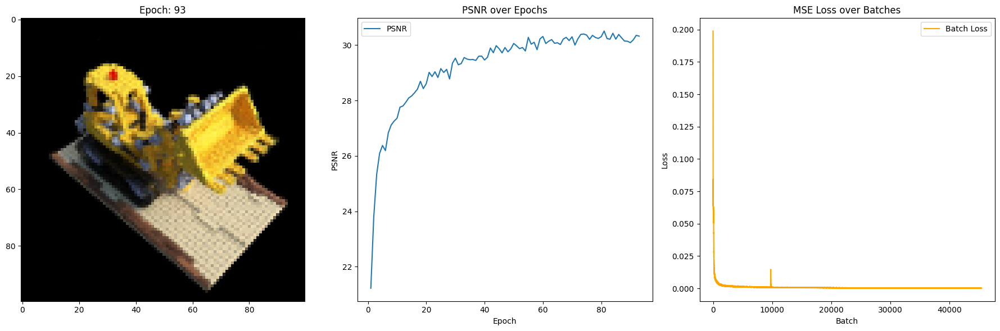

100%|██████████| 488/488 [00:12<00:00, 38.05it/s]


PSNR score=tensor([30.2369])
Average loss per epoch = 0.0002053781702625947


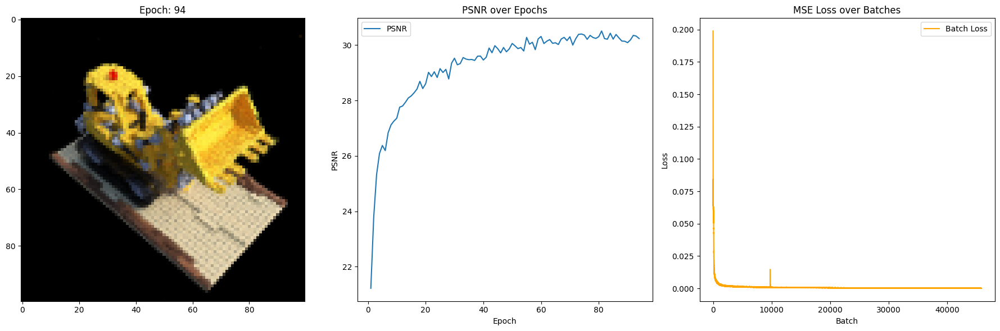

100%|██████████| 488/488 [00:12<00:00, 38.10it/s]


PSNR score=tensor([30.2839])
Average loss per epoch = 0.00019850957377472145


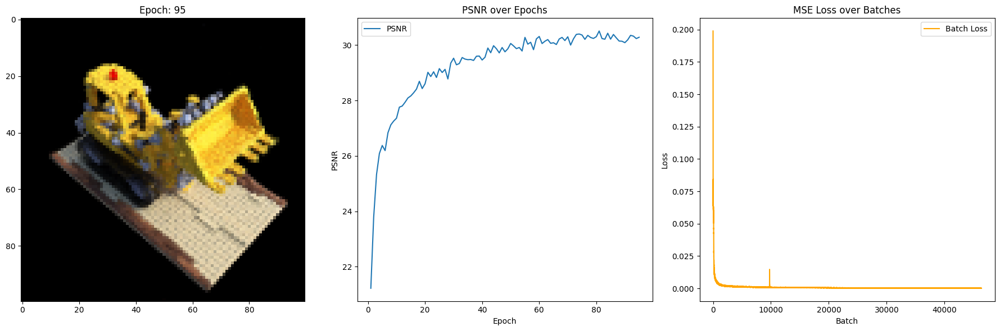

100%|██████████| 488/488 [00:12<00:00, 38.22it/s]


PSNR score=tensor([30.2053])
Average loss per epoch = 0.0002022252211332432


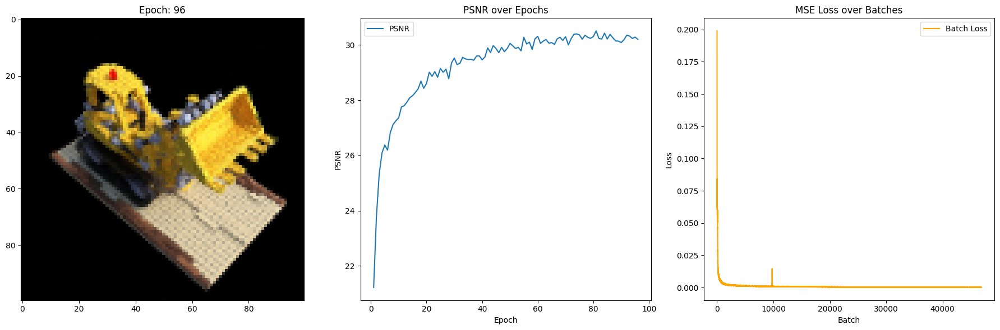

100%|██████████| 488/488 [00:12<00:00, 38.29it/s]


PSNR score=tensor([30.2033])
Average loss per epoch = 0.00020050723066903674


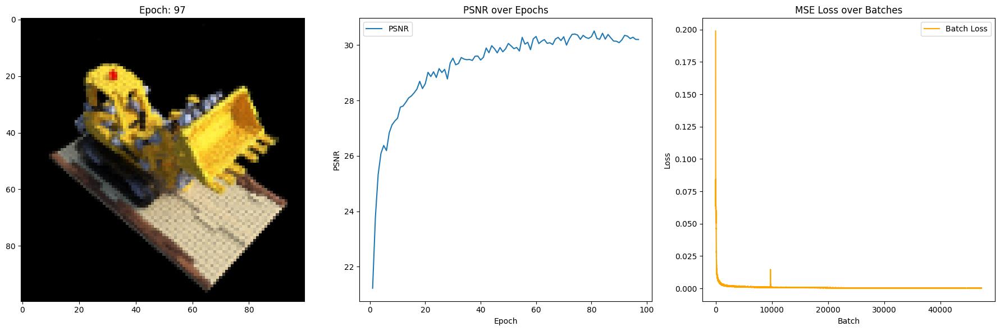

100%|██████████| 488/488 [00:12<00:00, 38.02it/s]


PSNR score=tensor([30.3037])
Average loss per epoch = 0.0001935050982030559


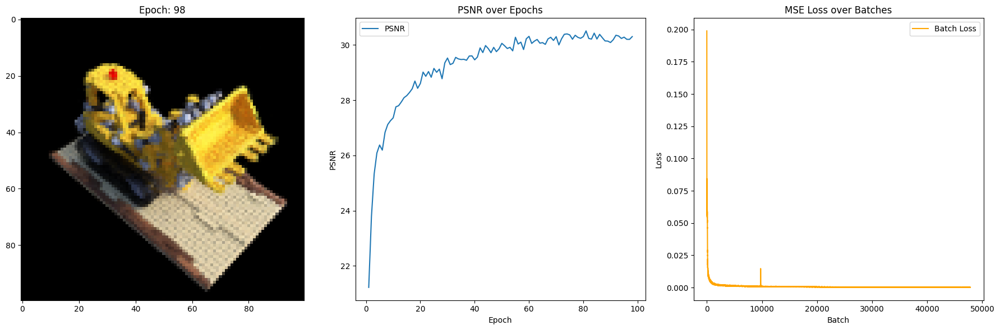

100%|██████████| 488/488 [00:12<00:00, 37.83it/s]


PSNR score=tensor([30.0689])
Average loss per epoch = 0.0001915225319132079


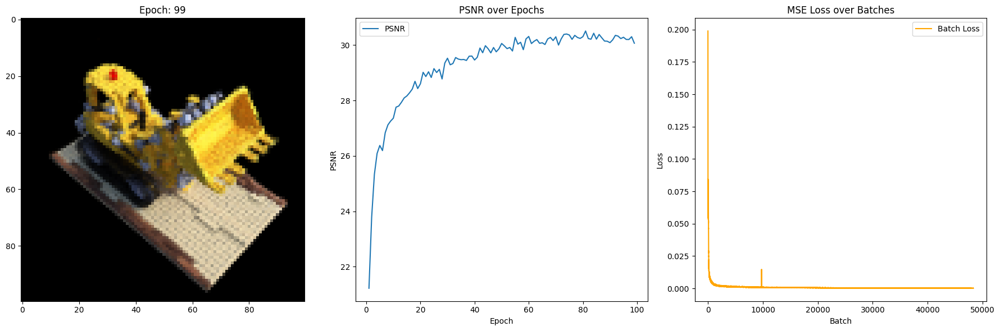

100%|██████████| 488/488 [00:12<00:00, 37.94it/s]


PSNR score=tensor([30.3533])
Average loss per epoch = 0.00019438861233881698


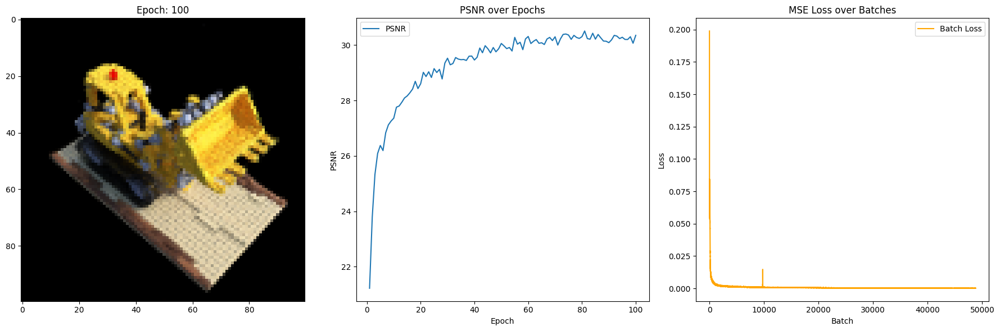

In [ ]:

# Sample rays for all images
sampled_rays = [
    sample_rays_numpy(height, width, focal_length, pose_data[img_idx])
    for img_idx in range(num_training_images)
]

# Unpack sampled rays
ray_origins_list, ray_directions_list = zip(*sampled_rays)

# Reshape rays and images
ray_origins_list = [orig.reshape(-1, 3) for orig in ray_origins_list]
ray_directions_list = [dir.reshape(-1, 3) for dir in ray_directions_list]
list_rays = [image_data[img_idx].reshape(-1, 3) for img_idx in range(num_training_images)]

# Convert lists to numpy arrays and stack them vertically
ray_origins_array = np_lib.vstack(ray_origins_list)
ray_directions_array = np_lib.vstack(ray_directions_list)
ray_rgb_array = np_lib.vstack(list_rays)

# Verify the shapes to ensure correctness (optional debugging step)
assert ray_origins_array.shape[0] == ray_directions_array.shape[0] == ray_rgb_array.shape[0], "Mismatch in number of rays"

# Combine all ray components into a single numpy array
rays_combined_array = np_lib.hstack([ray_origins_array, ray_directions_array, ray_rgb_array])

# Convert the combined numpy array to a PyTorch tensor
rays = torch_lib.tensor(rays_combined_array, device=computation_device)

# parameters of training

batch_size = 2048
num_total_rays = rays.shape[0]
print(f"The number of batches is {num_total_rays // batch_size} and each batch has {batch_size} rays")


num_epochs = 100
psnr_history = []
epoch_indices = []
depth_bounds = (2.0, 6.0)
sample_counts = (64, None)
directions_use_view = True

# Sample rays for the test image
test_ray_origins, test_ray_directions = sample_rays_numpy(height, width, focal_length, test_pose)

# Create a dictionary to store the test data
test_data = {
    'ray_origins': test_ray_origins,
    'ray_directions': test_ray_directions,
    'rgb': test_image
}

# Convert all test data to PyTorch tensors and store them back in the dictionary
test_data_tensors = {key: torch_lib.tensor(value, device=computation_device) for key, value in test_data.items()}

# Extract the tensors from the dictionary
test_ray_origins_tensor = test_data_tensors['ray_origins']
test_ray_directions_tensor = test_data_tensors['ray_directions']
test_rgb_tensor = test_data_tensors['rgb']

# train

nerf_model = NeuralRadianceField(directions_use_view=directions_use_view).to(computation_device)
optimizer_adm = optim_lib.Adam(nerf_model.parameters(), lr=5e-4)
mean_squared_error = nn_lib.MSELoss()

num_batches = num_total_rays // batch_size
epoch_indices = []
psnr_history = []
batch_loss_history = []

for epoch in range(num_epochs):
    # Randomly permute the order of rays
    random_indices = torch_lib.randperm(num_total_rays)
    permuted_rays = rays[random_indices, :]

    # Split permuted rays into batches for training
    training_batches = iter(torch_lib.chunk(permuted_rays, int(num_total_rays / batch_size), dim=0))

    epoch_loss = 0

    for batch_index in progress_lib(range(num_batches)):
        batch_rays = next(training_batches)

        trial_dim = -1
        ray_origins_batch, ray_directions_batch, target_rgb_batch = torch_lib.chunk(batch_rays, 3, dim=trial_dim)
        batch_ray_origins_directions = (ray_origins_batch, ray_directions_batch)
        predicted_rgb, _, __ = rendering(nerf_model, batch_ray_origins_directions, bounds=depth_bounds, num_samples=sample_counts, comp_device=computation_device, directions_use_view=directions_use_view)
        losses = mean_squared_error(predicted_rgb, target_rgb_batch)
        optimizer_adm.zero_grad()

        losses.backward()

        optimizer_adm.step()

        epoch_loss += losses.item()
        batch_loss_history.append(losses.item())  # Collecting batch loss

    # Average loss over all batches in the epoch
    epoch_loss /= num_batches

    with torch_lib.no_grad():
        pred_rgb = []
        test_shape = test_ray_origins_tensor.shape[0]
        for ray_index in range(test_shape):
            # Extract the origin and direction for the test ray at the specified index and combine them using zip
            test_ray_data = next(zip(
                test_ray_origins_tensor[ray_index].unsqueeze(0),
                test_ray_directions_tensor[ray_index].unsqueeze(0)
            ))

            # Flatten the tuple
            ray_origins_directions_test = tuple(test_ray_data)

            predicted_rgb, _, __ = rendering(nerf_model, ray_origins_directions_test, bounds=depth_bounds, num_samples=sample_counts, comp_device=computation_device, directions_use_view=directions_use_view)

            fix_rgb_pred = predicted_rgb.unsqueeze(0)

            pred_rgb.append(fix_rgb_pred)

        predicted_rgb_tensor = torch_lib.cat(pred_rgb, dim=0)
        test_loss = mean_squared_error(predicted_rgb_tensor, test_rgb_tensor).cpu()
        psnr_value = -10.0 * torch_lib.log(test_loss).item() / torch_lib.log(torch_lib.tensor([10.0]))
        print(f"PSNR score={psnr_value}")
        print(f"Average loss per epoch = {epoch_loss}")

        epoch_step = epoch + 1
        epoch_indices.append(epoch_step)
        psnr_history.append(psnr_value)

        # Plot PSNR, Training Loss, and Batch Loss
        plot_lib.figure(figsize=(18, 6))

        # Plot predicted RGB
        plot_lib.subplot(131)
        var_pred = predicted_rgb_tensor.cpu().detach()
        plot_lib.imshow(var_pred.numpy())
        plot_lib.title(f'Epoch: {epoch_step}')

        # Plot PSNR
        plot_lib.subplot(132)
        plot_lib.plot(epoch_indices, psnr_history, label='PSNR')
        plot_lib.xlabel('Epoch')
        plot_lib.ylabel('PSNR')
        plot_lib.title('PSNR over Epochs')
        plot_lib.legend()

        # Plot Batch Loss
        plot_lib.subplot(133)
        plot_lib.plot(batch_loss_history, label='Batch Loss', color='orange')
        plot_lib.xlabel('Batch')
        plot_lib.ylabel('Loss')
        plot_lib.title('MSE Loss over Batches')
        plot_lib.legend()

        plot_lib.tight_layout()
        plot_lib.show()


In [ ]:
import numpy as np_lib
import torch as torch_lib
from tqdm import tqdm as progress_lib
import imageio as imageio_lib

rendered_frames = []
pred_rgb = []
for theta_angle in progress_lib(np_lib.linspace(0.0, 360.0, 120, endpoint=False)):
    with torch_lib.no_grad():
        camera_to_world_matrix = calculate_camera_pose(theta_angle, -30.0, 4.0)
        ray_origins, ray_directions = sample_rays_numpy(height, width, focal_length, camera_to_world_matrix[:3, :4])

        for ray_index in range(ray_origins.shape[0]):
            ray_origins_directions_test = (T.tensor(ray_origins[ray_index], dtype=T.float32).to(computation_device),T.tensor(ray_directions[ray_index], dtype=T.float32).to(computation_device))

            rgb_output, depth_output, acc_output = rendering(
                nerf_model, ray_origins_directions_test, bounds=depth_bounds, num_samples=sample_counts, comp_device=computation_device, directions_use_view=directions_use_view
            )

            rgb_output = rgb_output.unsqueeze(0)

            pred_rgb.append(rgb_output)
    predicted_rgb_tensor = torch_lib.cat(pred_rgb, dim=0)
    rendered_frames.append((255 * np_lib.clip(predicted_rgb_tensor.cpu().numpy(), 0, 1)).astype(np_lib.uint8))
    pred_rgb=[]

video_filename = 'rendered_video.mp4'
imageio_lib.mimwrite(video_filename, rendered_frames, fps=20, quality=10)


100%|██████████| 120/120 [00:14<00:00,  8.11it/s]
IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (100, 100) to (112, 112) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).
[swscaler @ 0x615ba80] Warning: data is not aligned! This can lead to a speed loss


In [ ]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('rendered_video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)